<a href="https://colab.research.google.com/github/JoDeMiro/Micado-Research/blob/main/ML_Auto_16.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# ML Auto 15.ipynb másolata

Válaszható lett.

> Itt annyit változtattam, hogy 'Action' után is visszaengedem a before after adatokat. Ennyivel bővülnek a before after adatok. Igy nem csak a mesterséges mozgatás által jut adatokhoz.

Bevezetésre került:

> Kivettem a before after linreg becslésből az Interceptet

Bevezetésre került:

> Linreg helyett MLP van a main modelben

Bevezetésre került:

> Az action kiszámolásánál az új érték is -1, 1 közé lesz normalizálva

Bevezetésre került:

> Minimum 5, Maximum 5 lépést tehet mindkét irányba


# ToDo
letölteni a pythont és ott futtatni a kódot

huzzon egy nyomot a becslésre is, hogy lássam, hogy hova a faszomba becsüli az első modell
a mit is? ja igen a középtől való eltérést.

csinálni egy második modelt illetve kettőt

az egyik legyen a régi, de hagyjuk a faszba a fel-le becslést, az egész before aftert
és csak egyszerűen kössünk rá a becslésre valamilyen szabályt. Ha nagyobb mint x akkor +3

a másik verzió amit gyorsan ki kéne próbálni, hogy a linreg helyett beteszek egy mlp-t

**ToDo:**

Megnézni, hogy normalizálom-e az adatokat a neruális háló előtt, mert lehet hogy ez viszi félre a becslést.

**Gondolat:**

Nyilvánvaló, hogy egy idő után se a before after adatokra nem képes jó becslést adni
```
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[2.13709439]]
-------- 1 y up ->  center =  [[1.94404015]]
-------- 1 y up ->  right  =  [[1.85292015]]
```
Ezért arra gondoltam, hogy beeresztem azokat az adatokat is, amelyeket az action körben lép meg.
Ha úgy se megy akkor át kell gondolni a képletet! A becslés képleétt, before after.

A másik, hogy csinálni kéne egy ábrát arra nézve, hogy mi a kapcsolat a tényleges before after között és nem csinálni rá semmilyen becslét.
Egyszerűen minden metrikára megnézni, hogy mi a lépés elötti adata és mi a lépés utáni adata. Ezt meg lehet csinálni úgy, hogy egy ploton vízszintesen van before, fűggőlegesen az after, és színnel van kódolva az action (kék +1, piros -1)

Amúgy most jutott eszembe, hogy egyébként a 0 actionre nem is becsülünk lehet, hogy ez is hiba.

Vagy úgy is lehet ábrázolni, hogy egy ploton van a +1 és külön egy másik ploton a -1. A lényeg, hogy nem becslés, hanem a before after közötti kapcsolat szenzoronként.

A fenti viszgálatot azért végzem el, hogy lássam, hol kap olyan adatokat ** milyen helyzetben kap olyan adatokat ** a before after adatsor amitől ilyen mértékben elromlik az előre jelző képessége.

2. Teljesen nyilvánvaló, hogy a szenzoros adatok és a tengelytől mért távolság közötti kapcsolatot a lineáris regresszió képtelen megragadni.

3. Utána ki kell próbálni, hogy a szenzorok nem előre néznek, hanem oldalra. Igen ez teljes egészében az amit a célváltozó is mér. De csak ellenőrzés végett.



# Micado Auto Scale Research

Ebben a felskálázási adatok elemzésével foglalkozom.

Ez az interkatív bemutató arra van, hogy a válotzók közötti összefüggéseket jobban átlásssam, elemezzem, az esetleges anomáliákat rögtön kiszúrjam.

A playground részben a rendszer alapját adó neuráli háló beállításaival lehet játszani és megfigyelni, hogy milyen hatással van a rendszer teljesítményére.

<a name="tartalom"></a>

## Tartalom

Bevezetés

> [Empty](#empty)<br>
> [Play Ground](#play_ground)<br>
> [SandBox](#sandbox)<br>
> [Before After](#beforeafter)<br>
> [Szintetikus adatok generálása](#szintetikus_adatok)<br>
> [Irodalom](#irodalom)<br>
> [ToDo](#todo)<br>


## Bevezető gondolat

Összességében az egésszel kapcsolatban van egy hatalmas kérdőjel.

Tulajdonképpen két paradigma van.

Az egyik - nem az enyém - így néz ki:

Egyszerűen becsüjük meg azt, hogy az adott szenzoros adatok alapján mi legyen a döntés kimenetele (fel, le, semmi). Akkor hoztunk jó döntést, ha valamilyen metrika alapján valamilyen költséget minimalizáltunk, vagy maximalizáltunk. Például, ha egy döntéssel sikerült közelebb kerülni a záróvonalhoz, vagyis az út közepére. Vagy az az autó a lehető legmeszebb jutott el anélkül, hogy érintette volna a falat és lehetőleg a leggyorsabban is.

A másik - amin én dolgozom - viszont egy plusz lépéssel egészül ki és ettől sokkal bonyolultabb. Hogy van-e létjogosultsága az ennek a kisérletnek a lényege.

Vannak szenzoros adataink, ami alapján hozunk egy döntést. Eddig olyan mint a máisik, de az érdemi különbség a módszerben és a tanulás folyamatában van.

A szenzoros adatokból megbecsüljük azt, hogy mennyire vagyunk jók és nem azt becsüljük, hogy mit kéne tenni!

Ha nem vagyunk jók akkor egy második modell segítségével csinálunk valamilyen lépést, amitől azt várjuk, hogy jók leszünk.

És itt jogosan merül fel a kérdés, hogy de miért nem az első módszert alkalmazzuk és erre most még én sem tudom a választ pontosan megadni. De röviden erről szól ez a kutatás.

## Paradmigva váltás

Miért olyan nehéz debuggolni ezt a rendszert?

Azért mert ha belegondolsz felügyelt tanulásnál mutatsz egy mintát, a rendszer kiszámolja a hibát és a hiba szerint módosítja a tanulásnál a súlyokat.

Itt viszont mutatsz egy mintát a rendszer kiszámoja a hibát a hiba szerint módosítja a súlyokat, a súlyok alapján hoz egy döntést, AMIT VISSZACSATOLÓDIK A RENDSZERBE olyan formán, hogy ezzel a lépéésel megváltoznak a bemeneti adatok, ami alapján újra tanítjuk a rendszert, és így tovább ahogy haladunk előre az időben, a tanulás során.

>> Attól lesz reinforcement learning, hogy a döntést visszatápláljuk a rendszerbe, ezáltal megváltoznak a bemeneti adatok. Ez a legnagyobb különbség a super-vised és a re-enforcement learning között.

In [1]:
import numpy as np
import matplotlib.pyplot as plt

from sklearn.linear_model import LinearRegression
from sklearn.neural_network import MLPRegressor
from sklearn.preprocessing import MinMaxScaler

import warnings
warnings.filterwarnings('ignore')

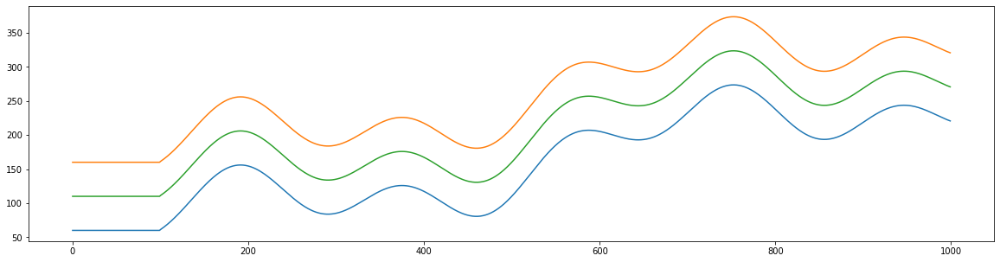

In [2]:
distance    = np.arange(0, 1000, 1)
road        = 100
wall_left   = 30*(np.sin(distance/180)) + distance * 0.3 + 30 * np.cos(distance/30) + 50 * np.sin(distance/90)
wall_left[0:100] = 60
wall_right  = wall_left + road
wall_center = ( wall_left + wall_right ) / 2


plt.figure(figsize=(20,5)); plt.plot(wall_left); plt.plot(wall_right); plt.plot(wall_center); plt.show()

In [3]:
class Road():
  def __init__(self, wide):
    self.distance    = np.arange(0, 3000, 1)
    self.wide        = wide
    self.wall_right  = 30*(np.sin(self.distance/180)) + self.distance * 0.3 + 30 * np.cos(self.distance/30) + 50 * np.sin(self.distance/90)
    self.wall_right[0:100] = 60
    self.wall_left   = self.wall_right + self.wide
    self.wall_center = ( self.wall_left + self.wall_right ) / 2

  def show(self):
    fig, ax = plt.subplots(figsize=(26,10)); ax.set_ylim(40, 1000); ax.plot(self.wall_left); ax.plot(self.wall_right); ax.plot(self.wall_center);
    return fig, ax


In [4]:
class Car():
  def __init__(self, road):
    self.road = road
    self.x = 0
    self.y = self.road.wall_center[0]
    self.sight = 400           # ennyit lát előre 300, 54, 154
    self.sight_center = 400    # ennyit lát előre 150

    self.y_history  = []
    self.x_history  = []
    self.y_center   = []; self.y_center = self.road.wall_center
    self.y_distance = []
    self.y_distance_real = []
    self.y_distance_predicted = []
    self.regression = LinearRegression(fit_intercept=False)
# Bevezetésre került az MLPRegreression
    self.mlp = MLPRegressor(hidden_layer_sizes=(30, 15), # (10, 5)
                            activation='relu',
                            solver='adam',
                            batch_size='auto',
                            learning_rate_init=0.02,
                            max_iter=200,
                            shuffle=True,
                            random_state=1,
                            momentum=0.9,
                            nesterovs_momentum=True,
                            early_stopping=True,
                            n_iter_no_change=200)
# Bevezetésre került az X MinMaxScaler
    self.x_minmaxscaler = MinMaxScaler(feature_range=(-1,1))
# Bevezetésre került az y MinMaxScaler
    self.y_minmaxscaler = MinMaxScaler(feature_range=(-1,1))
#
#    self.regression_left = LinearRegression()
    self.regression_left = LinearRegression(fit_intercept=False)
#    self.regression_center = LinearRegression()
    self.regression_center = LinearRegression(fit_intercept=False)
#    self.regression_right = LinearRegression()
    self.regression_right = LinearRegression(fit_intercept=False)

# most
    self.sensor_center = []
    self.sensor_left   = []
    self.sensor_right  = []
    self.before  = []
    self.after   = []

    self.mesterseges_coutner = 0


  def calculate_distances(self):
    # ha bármikor kevesebb a faltól mért távolsága bármelyik szenzoron akkor a szenzorokon mért távolság is ennyi lesz
    
    k = self.x; d = 0
    while(k < self.x + self.sight_center):
      k += 1; d += 1
      self.distance_center_from_wall = d
      if(int(self.road.wall_left[k]) < self.y):
        print('Sensor center = ', self.distance_center_from_wall)
        break
      if(int(self.road.wall_right[k]) > self.y):
        print('Sensor center = ', self.distance_center_from_wall)
        break

    k = self.x; d = 0
    while(k < self.x + self.sight):
      k += 1;  d += 1
      self.distance_left_from_wall = d
      if(int(self.road.wall_left[k]) < self.y + d):
        print('Sensor from left wall = ', self.distance_left_from_wall)
        break

    k = self.x; d = 0
    while(k < self.x + self.sight):
      k += 1; d += 1
      self.distance_right_from_wall = d
      if(int(self.road.wall_right[k]) > self.y - d):
        print('Sensor from right wall = ', self.distance_right_from_wall)
        break

    #ki kell kalkulálni a tényleges távolságot a ball és a jobb faltól
    # mert ezekre fogom tanítani a neurális hálót, ahol ezeket becsüljük
    # és a bemeneti változó a 3 szenzorból érkező adat lesz.
    # valójában azt mérjük, hogy milyen távolságra van az út közepétől

    self.distance_from_top     = abs(self.road.wall_left[self.x] - self.y)
    self.distance_from_bottom  = abs(self.road.wall_right[self.x] - self.y)
    print('most távolsagra van a felső faltól = ', self.distance_from_top)
    print('most távolsagra van az alsó faltól = ', self.distance_from_bottom)


    print('cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc')
    print('self.x                       = ', self.x)
    print('cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc')

    # mi lenne, ha mégis inkább a kettő hányadosát becsülném (1 ha egyenlő távolságra van)
    # self.vertical_distance_from_middle = self.road.wall_center[self.x] - self.y
    # self.vertical_distance_from_middle = self.distance_from_top / self.distance_from_bottom

    self.vertical_distance_from_middle = self.y - self.road.wall_center[self.x]

    print('KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK')
    print('self.vertical_distance_from_middle = ', self.vertical_distance_from_middle)
    print('KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK')




    print('ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa = ', self.vertical_distance_from_middle)


    # de elötte szeretnék még valamit leellenőrizni
    # ezeknek a hossza nem fog megeggyezni a tényleges futások számával, hanem több lesz (milyen jó lett volna erre egy teszt esetet írni és akkor test driven development lenne)

    print('\t\t\t ---------------- Teszt ----------------')
    print('\t\t\t len(self.y_distance)    = ', len(self.y_distance))
    print('\t\t\t len(self.sensor_left)   = ', len(self.sensor_left))
    print('\t\t\t len(self.sensor_center) = ', len(self.sensor_center))
    print('\t\t\t len(self.sensor_right)  = ', len(self.sensor_right))
    print('\t\t\t self.x                  = ', self.x)
    print('\t\t\t -------------- Teszt End --------------')


  def append(self):
    self.y_distance.append(self.vertical_distance_from_middle)

    self.sensor_left.append(self.distance_left_from_wall)
    self.sensor_center.append(self.distance_center_from_wall)
    self.sensor_right.append(self.distance_right_from_wall)

    print('\t\t\t ---------------- Append ----------------')
    print('\t\t\t len(self.y_distance)    = ', len(self.y_distance))
    print('\t\t\t len(self.sensor_left)   = ', len(self.sensor_left))
    print('\t\t\t len(self.sensor_center) = ', len(self.sensor_center))
    print('\t\t\t len(self.sensor_right)  = ', len(self.sensor_right))
    print('\t\t\t self.x                  = ', self.x)
    print('\t\t\t -------------- Append End --------------')


  def run(self):
    for i in range(0, 3000, 1):
      print('# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------')
      _summary_mlp_prediction_was_taken = 0
      _summary_mlp_fit_was_taken = 0
      _summary_mesterseges_mozgatas = 0
      _summary_action_was_taken = 0

      self.x = i
      self.calculate_distances()
      # !!!
      self.append()
      # !!!
      if( i % 1 == 0 ):
        if ( i % 80 == 0 ):
          self.plot()
          print(' --- plot --- ')

      if( i >= 0 ):

        if( i % 3 == 0 and i >= 12 ):

          print('------------------------------ IF i % 3 == 0 ------------------------------')
          print('# i = ', i)
          print('# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)')
          X = np.array([self.sensor_left, self.sensor_center, self.sensor_right]).T
          y = np.array([self.y_distance]).T
          print('X.shape = ', X.shape)
          print('y.shape = ', y.shape)
          # print('X       = ', X)
          # print('y       = ', y)
          print('i       = ', i)
          self.regression.fit(X, y)
          _summary_mlp_fit_was_taken = 1
# Lineáris regresszió helyett Neurális hálót használok
          self.x_minmaxscaler.fit(X)
          self.y_minmaxscaler.fit(y)
          X_scaled = self.x_minmaxscaler.transform(X)
          y_scaled = self.y_minmaxscaler.transform(y)
          print('---------------------')
          print('X.max = ', X.max())
          print('X.min = ', X.min())
#          print('X[:,0].max = ', X[:,0].max())
#          print('X[:,0].min = ', X[:,0].min())
#          print('X[:,1].max = ', X[:,1].max())
#          print('X[:,1].min = ', X[:,1].min())
#          print('X[:,2].max = ', X[:,2].max())
#          print('X[:,2].min = ', X[:,2].min())
          print('y.max = ', y.max())
          print('y.min = ', y.min())
          print('---------------------')
#          print('X_scaled.shape = ', X_scaled.shape)
#          print('y_scaled.shape = ', y_scaled.shape)
          print('X_scaled.max = ', X_scaled.max())
          print('X_scaled.min = ', X_scaled.min())
#          print('X_scaled[:,0].max = ', X_scaled[:,0].max())
#          print('X_scaled[:,0].min = ', X_scaled[:,0].min())
#          print('X_scaled[:,1].max = ', X_scaled[:,1].max())
#          print('X_scaled[:,1].min = ', X_scaled[:,1].min())
#          print('X_scaled[:,2].max = ', X_scaled[:,2].max())
#          print('X_scaled[:,2].min = ', X_scaled[:,2].min())
          print('y_scaled.max = ', y_scaled.max())
          print('y_scaled.min = ', y_scaled.min())
          print('---------------------')
          self.mlp.fit(X_scaled, y_scaled)


        if( i % 3 == 1 and i >= 22 ):

          print('------------------------------ IF i % 3 == 1 ------------------------------')
          print('# i = ', i)
          print('# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja')
          X_test = np.array([self.sensor_left, self.sensor_center, self.sensor_right]).T
          _X_test = np.array([X_test[-1,:].reshape(-1,1)])
          _X_test = np.array([X_test[-1,:]])
          print('actual _X_test = ', _X_test)
          predicted_test = self.regression.predict(_X_test)
# Lineáris regresszió helyett Neurális hálót használok
          _X_test_scaled = self.x_minmaxscaler.transform(_X_test)
          predicted_test = self.mlp.predict(_X_test_scaled)
# ToDo : Fontos lenne visszatranszformálni a predicted_test értéket mielőtt belekerül az archivumba
          _summary_mlp_prediction_was_taken = 1
          self.y_distance_real.append(self.y_distance[-1])
          self.y_distance_predicted.append(predicted_test)
          print('actual predicted = ', predicted_test)
          # print('actual predicted = {:.5f}'.format(predicted_test[0,0]))
          print('actual self.y_distance[-1] = ', self.y_distance[-1])
#          print('actual self.y_distance     = ', self.y_distance)
          print('len(self.y_distance_real)      = ', len(self.y_distance_real))
          print('len(self.y_distance_predicted) = ', len(self.y_distance_predicted))

          if( i % 32 == 0 ):
            # olyan szar a becslés, hogy az hihetetlen
            plt.figure(figsize=(12, 5)); plt.scatter(self.y_distance_real, self.y_distance_predicted)
            plt.ylabel('y_distance_predicted'); plt.xlabel('y_distance_real'); plt.show()
            
            # korábban csak azokat az adatokat plottoltam amik a tanulás után lettek visszamérve,
            # de nézzük meg a teljes adatsoron
            X_test_full = np.array([self.sensor_left, self.sensor_center, self.sensor_right]).T
            _X_test_full = X_test_full
            predicted_test_full = self.regression.predict(_X_test_full)
# Lineáris regresszió helyett Neurális hálót használok
            _X_test_full_scaled = self.x_minmaxscaler.transform(_X_test_full)
            predicted_test_full = self.mlp.predict(_X_test_full_scaled)
# ToDo : itt még lehet, hogy kéne transzformálni y-t is és az egészet visszatranszformálni eredeti értékére + ellenőrizni, hogy tulajdonképpen amikor skálázom az y-t akkor mi alapján skálázok
            predicted_test_full = self.y_minmaxscaler.inverse_transform(predicted_test_full.reshape(-1, 1))
            _y_test_full = np.array([self.y_distance]).T
            print(_y_test_full.shape)
            print(predicted_test_full.shape)
            plt.figure(figsize=(12, 5)); plt.scatter(_y_test_full, predicted_test_full, c='r');
            plt.ylabel('y_distance_predicted'); plt.xlabel('y_distance_real'); plt.show()

            _array_target = np.array([_y_test_full.ravel(), predicted_test_full.ravel(), np.arange(0, _y_test_full.shape[0], 1)]).T

            plt.figure(figsize=(12, 5)); plt.scatter(_array_target[:,0], _array_target[:,1], c=_array_target[:,2]);
            plt.ylabel('y_distance_predicted'); plt.xlabel('y_distance_real'); plt.show()

            plt.figure(figsize=(12, 5)); ax = plt.axes(); ax.scatter(_array_target[:,0], _array_target[:,1], c=_array_target[:,2])
            ax.plot([-10, 2, 4, 10], [-10, 2, 4, 10]); ax.set_ylabel('y_distance_predicted'); ax.set_xlabel('y_distance_real'); plt.show()
            print(' --- plot predcition --- ')

            # Milyen kapcsolat van a bemenő adatok és a célváltozó között
# New
            plt.figure(figsize=(12, 5));
            plt.scatter(self.sensor_left, self.y_distance, c=_array_target[:,2]);
            plt.ylabel('self.y_distance');
            plt.xlabel('self.sensor_left');
            plt.show()
            print('óóóóóó')
            print(len(self.sensor_left))
            # print(self.sensor_left)
            print('áááááá')
            print(len(self.y_distance))
            # print(self.y_distance)

        # most jön az, hogy véletlenszerűen kell egyet ugrania fel, vagy le
        # ez felel meg a before after dologonak
        # az így létrejött adatokat is el kell tárolni úgy mint
        # mi volt a szezoros adat before
        # mi lett a szenzoros adat after
        # mi volt az y before, mi lett az y after
        # mivel mindíg egyet fogunk csak lépni, ezért a dif mindíg egy lesz
        # de ezt számítani kell, mivel a későbbiek folyamán lehet, hogy többet is fog lépni

        if( i % 3 == 2 ):

          print('------------------------------ IF i % 3 == 2 ------------------------------')
          print('# i = ', i)
          print('# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok')

          _summary_mesterseges_mozgatas = 1
          
          if( self.mesterseges_coutner == 0 ):                             # Első lépésben fel
            self.before.append(np.array([self.y, self.distance_left_from_wall, self.distance_center_from_wall, self.distance_right_from_wall]))
            self.y = self.y + 1
            print('artificial move -> up first')
            self.calculate_distances()
            self.after.append(np.array([self.y, self.distance_left_from_wall, self.distance_center_from_wall, self.distance_right_from_wall]))
            self.mesterseges_coutner = 1

          elif( self.mesterseges_coutner == 1 ):                           # Második lépésben le
            self.before.append(np.array([self.y, self.distance_left_from_wall, self.distance_center_from_wall, self.distance_right_from_wall]))
            self.y = self.y - 1
            print('artificial move -> down first')
            self.calculate_distances()
            self.after.append(np.array([self.y, self.distance_left_from_wall, self.distance_center_from_wall, self.distance_right_from_wall]))
            self.mesterseges_coutner = 2

          elif( self.mesterseges_coutner == 2 ):                           # Harmadik lépésben le
            self.before.append(np.array([self.y, self.distance_left_from_wall, self.distance_center_from_wall, self.distance_right_from_wall]))
            self.y = self.y - 1
            print('artificial move -> down second')
            self.calculate_distances()
            self.after.append(np.array([self.y, self.distance_left_from_wall, self.distance_center_from_wall, self.distance_right_from_wall]))
            self.mesterseges_coutner = 3

          elif( self.mesterseges_coutner == 3 ):                           # Negyedik lépésben fel
            self.before.append(np.array([self.y, self.distance_left_from_wall, self.distance_center_from_wall, self.distance_right_from_wall]))
            self.y = self.y + 1
            print('artificial move -> up second')
            self.calculate_distances()
            self.after.append(np.array([self.y, self.distance_left_from_wall, self.distance_center_from_wall, self.distance_right_from_wall]))
            self.mesterseges_coutner = 0

          else:
            print('semmi\n\n\n\n')

          print('self.y = ', self.y)



# itt van egy érdekesség amit csak magamnak írok fel
# ezen a ponton lépünk ki a három if ágból - if( i % 3 == _ )

# ez azért fontos, mert ami itt következik az mindíg lefut
# akár volt neurális háló tanítás
# akár volt neurális háló predikció visszamérése
# akár volt mesterséges mozgatás


# felmerül a kérdés de csak felmerül, hogy nem lehet-e az, hogy ezt csak akkor kéne elvégezni amikor nincs neurális háló tanítás és nincs mesterséges mozgatás sem
# ezt csak egy kísérlet ereéig ki kéne próbálni (if i % 3 == 1) -> vagyis amikor az nn predikció mérése történik

        action = 0
        if( i % 3 == 0 ):

          if( len(self.before) > 9 ):           # ha már van néhány before after adatunk, akkor

            print('------------------------------ IF len(self.before) > 9 ------------------------------')
            print('\n')
            print('# i = ', i)
            print('  Ha már van elég before after adatunk')
            print('# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára')
            # minden egyes szezor adatára el kell készítenünk azt a lineráis regressziós modelt ami megmondja, hogy mi lenne a szenzor értéke, ha 1, 2, 3, ... n lépéssel elvinnénk a kocsit

            # oké megvan a before és megvan az after (self.y, left, center, right)
            before_array = np.array(self.before)
            after_array  = np.array(self.after)
            y_delta = after_array[:,0] - before_array[:,0]
            delta_array = after_array - before_array
#            print('--------------------------------------')
#            print(y_delta)
#            print(before_array.shape)
#            print(after_array.shape)
#            print('self.before = \n', self.before)
#            print('self.after  = \n', self.after)
#            print('delta_array = \n', delta_array)
#            print('--------------------------------------')

            # képlet szerint senzor' = w0 + w1 * senzor + w2 * delta_y
            # valójában ez a képlet nem jó és nem így kéne számolni, mert ez figyelembe veszi a szenzor aktuális értékét is, de most így hagyom
            # ------- fenti sort nem tudom miért írtam, hogy baj az ha figyelembe veszük az aktuális értéket is, hm.

            print('# Linear Regression Learning --------------------------------------------------------------------------------------')
            print('\t\t # Linear Regression Training Results -------------------------------------------------------------------------')

            _X_left = np.array([before_array[:,1], delta_array[:,0]]).T # left és delta_y
  # ez itt teljesen hibás volt. nem a deltat kellet volna becsülnöm
            _y_left = delta_array[:,1].reshape(-1, 1)
  # itt ki lett javítva. nem a deltat kellett volna becsülnöm hanem az aftert     - a fenti sort azért hagytam benne, hogy lássam a hibát
            _y_left = after = after_array[:,1].reshape(-1, 1)
#            regression_left = LinearRegression()
            regression_left = self.regression_left
            regression_left.fit(_X_left, _y_left)
            # print('\t\t _X_left = \n', _X_left)
            # print('\t\t _y_left = \n', _y_left)
            print('\t\t ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------')
            print('\t\t regression_left.coef_ = ', regression_left.coef_)
            print('\t\t regression_left.intercept_ = ', regression_left.intercept_)
            _predicted_left = regression_left.predict(_X_left)
#            plt.scatter(_y_left, _predicted_left)
#            plt.ylabel('_predicted_left')
#            plt.xlabel('_true_y_left')
#            plt.show()
            # kiplottolom a before after adatokat egy konkrét szenzor értékeire
#            plt.scatter(before_array[:,1], after_array[:,1], c='black')
#            plt.ylabel('after')
#            plt.xlabel('before')
#            plt.show()

            _X_center = np.array([before_array[:,2], delta_array[:,0]]).T # center és delta_y
  # ez itt teljesen hibás volt. nem a deltat kellet volna becsülnöm
            _y_center = delta_array[:,2].reshape(-1, 1)
  # itt ki lett javítva. nem a deltat kellett volna becsülnöm hanem az aftert     - a fenti sort azért hagytam benne, hogy lássam a hibát
            _y_center = after_array[:,2].reshape(-1, 1)
#            regression_center = LinearRegression()
            regression_center = self.regression_center
            regression_center.fit(_X_center, _y_center)
            print('\t\t ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------')
            print('\t\t regression_center.coef_ = ', regression_center.coef_)
            print('\t\t regression_center.intercept_', regression_center.intercept_)
            _predicted_center = regression_center.predict(_X_center)
#            plt.scatter(_y_center, _predicted_center)
#            plt.ylabel('_predicted_center')
#            plt.xlabel('_true_y_center')
#            plt.show()
            # kiplottolom a before after adatokat egy konkrét szenzor értékeire
#            plt.scatter(before_array[:,2], after_array[:,2], c='black')
#            plt.ylabel('after')
#            plt.xlabel('before')
#            plt.show()

            _X_right = np.array([before_array[:,3], delta_array[:,0]]).T # right és delta_y
  # ez itt teljesen hibás volt. nem a deltat kellet volna becsülnöm
            _y_right = delta_array[:,3].reshape(-1, 1)
  # itt ki lett javítva. nem a deltat kellett volna becsülnöm hanem az aftert     - a fenti sort azért hagytam benne, hogy lássam a hibát
            _y_right = after_array[:,3].reshape(-1, 1)
#            regression_right = LinearRegression()
            regression_right = self.regression_right
            regression_right.fit(_X_right, _y_right)
            print('\t\t ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------')
            print('\t\t regression_right.coef_ = ', regression_right.coef_)
            print('\t\t regression_right.intercept_ = ', regression_right.intercept_)
            _predicted_right = regression_right.predict(_X_right)
#            plt.scatter(_y_right, _predicted_right)
#            plt.ylabel('_predicted_right')
#            plt.xlabel('_true_y_right')
#            plt.show()
            # kiplottolom a before after adatokat egy konkrét szenzor értékeire
#            plt.scatter(before_array[:,3], after_array[:,3], c='black')
#            plt.ylabel('after')
#            plt.xlabel('before')
#            plt.show()


            # most ki kell számolni, hogy mennyi lenne a szenzorok értéke, ha fel le lépkednénk

            # mondjuk maximalizáljuk a fel le lépkedés mértékét 5-ben

            move = np.array([-5, -4, -3, -2, -1, 0, 1, 2, 3, 4, 5])

            move = np.array([-2, -1, 0, 1, 2])

            move = np.array([-3, -2, -1, 0, 1, 2, 3])

            move = np.array([-5, -4, -3, -2, -1, 0, 1, 2, 3, 4, 5])


  # most


            print('\t # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------')

            print('\t\t # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke')
            proba_X_metrika   = np.array([1,1]).reshape(1, -1)
            print('proba_X_metrika   = ', proba_X_metrika)
            predicted_proba_left = regression_left.predict(proba_X_metrika)
            predicted_proba_center = regression_center.predict(proba_X_metrika)
            predicted_proba_right = regression_right.predict(proba_X_metrika)
            print('-------- 1 y up ->  left   = ', predicted_proba_left)
            print('-------- 1 y up ->  center = ', predicted_proba_center)
            print('-------- 1 y up ->  right  = ', predicted_proba_right)
            print('\n')

            # EGY KURVA NAGY ELMÉLETI DILLEMMÁHOZ ÉRKEZTEM.

            # HÁROM MEGOLDÁS VAN

            # EBBŐL SZERINTEM MOST A LEGROSSZABBAT VÁLASZOTTAM

            # 1, MINDENKÉPPEN VÁLASZT EGYET, A LEGJOBBAT

            # 2, CSAK AKKOR MODOSÍT HA KÖZELEBB TUDJA VINNI A KÖZÉPPONTHOZ MINT AHOL MOST VAN
            
            action = 0; tmp = 999999990

            for j in move:
              print('\n')
              print('\t\t minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba')
              print('\t\t j = ', j)
              # ide be kell helyettesítenem az éppen aktuális értéket, olyan mintha egy új X változót csinálnék amiben csak egy sor van és arra kérnék egy becslést a korábbi modell alapján
              # a bement az éppen aktuális szenzoros érték és az új lépés

              # na majd ezt a bemenetet kell ellenőrizni, hogy stimmel-e a tanítás során használt bemenettel
              _X_left   = np.array([[self.distance_left_from_wall, j]])
              _X_center = np.array([[self.distance_center_from_wall, j]])
              _X_right  = np.array([[self.distance_right_from_wall, j]])

              print('\t\t ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------')
              print('\t\t _X_left   = ', _X_left)
              print('\t\t _X_center = ', _X_center)
              print('\t\t _X_right  = ', _X_right)

              # a fenti értékek valószínűleg jók, de mindíg minden lépésnél ellenőrizni kell

              predicted_left   = regression_left.predict(_X_left)
              predicted_center = regression_center.predict(_X_center)
              predicted_right  = regression_right.predict(_X_right)

              print('\t\t predicted_left   = ', predicted_left)
              print('\t\t predicted_center = ', predicted_center)
              print('\t\t predicted_right  = ', predicted_right)

              print('\t\t --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------')
              print('\t\t regression_left.coef_   = ', regression_left.coef_)
              print('\t\t regression_center.coef_ = ', regression_center.coef_)
              print('\t\t regression_right.coef_  = ', regression_right.coef_)
              print('\t\t regression_left.intercept_   = ', regression_left.intercept_)
              print('\t\t regression_center.intercept_ = ', regression_center.intercept_)
              print('\t\t regression_right.intercept_  = ', regression_right.intercept_)

              # nekünk majd azt az értéket kell választanunk amelyik segítségével a legközelebb jutunk a 1 értékhez

              _X = np.array([predicted_left.ravel(), predicted_center.ravel(), predicted_right.ravel()]).T    # figyelni kell rá, hogy eredetileg is ez volt-e a változók sorrendje

              print('\t\t # Ez lesz a bemenete a neurális hálónak')
              print('\t\t -------------------------X-------------------------')
              print('\t\t ', _X)
              print('\t\t ---------------Brutálisan hülye dolgot jelez előre ezért ellenőrizni kell, hogy mi a gond. Esetleg a bemeneti adatok?-----------------')

              predicted_position = self.regression.predict(_X)
              print('\t\t predicted_position linreg model            = ', predicted_position)
# Lineáris regresszió helyett Neurális hálót használok
# Lehet, hogy itt fit_transform használata lenne a helyes!!!!!!!!!!!!!!!!!!!!!!!!
              _X_scaled = self.x_minmaxscaler.transform(_X)
              predicted_position_scaled = self.mlp.predict(_X_scaled)
              print('\t\t predicted_position neural net model scaled = ', predicted_position_scaled)
# Vissza kell transzformálnom eredeti formájába
              predicted_position = self.y_minmaxscaler.inverse_transform(predicted_position_scaled.reshape(-1, 1))
              print('\t\t predicted_position neural net model inverz = ', predicted_position)
# Ez nem lesz könnyű
# Itt meg fogom csinálni, hogy úgy számolja ki az új értékekre a normalizációt, hogy az új érték is mindenféleképen -1, 1 közé essen
              print('\t\t\t xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx')
              print('\t\t\t    ez az _X úgy, hogy a régi x_minmaxscaler alapján lett -1, 1 közé szorítva')
              print('\t\t\t _X_scaled = ', _X_scaled)
              print('\t\t\t    ez a predicted y úgy, hogy a régi y_minmaxscaler alapján lett -1, 1 közé szorítva')
              print('\t\t\t predicted_position_scaled = ', predicted_position_scaled)
# Ami itt nehéz lesz, hogy a régi X értékekhez, vagy ahhoz amin elvégeztem az x_minmaxscalert hozzá kell csapnom az új linreg által számolt _X
# tömböt és azon megcsiálnom a teljes skálázást (bár ez az egész módszer nem biztos, hogy jó, sőt, de nincs jobb ötletem)

              print('\t\t --------------------------------------------------------------------------------------------------------------------------------------')

              # legyünk bátrak és módosítsuk az autó self.y pozicióját

              # azzal az értékkel amely abszolút értékben a legkissebb, helyett
              # mivel a célváltozónk akkor jó ha 1. mivel a felső/alsótól mért távolság hányadosa
              # ezért itt azt az értéket kell kiválasztani ami a legközelebb van +1-hez (és nem azt amelyik 0-hoz)

              # természetesen ezen változtatni kell ha ismét az középvonaltól való eltérés mértékét akarjuk becsülni
              # de ahhoz fenti is át kell állítani az adatokat

              if( abs(0 - predicted_position) < tmp):       # rossz - javítva - tesztelés alatt
                action = j
                tmp = abs(0 - predicted_position)
                print('\t\t ---------------------')
                print('\t\t  action = ', action)
                print('\t\t  predicted_position = ', predicted_position)
                print('\t\t  distance from 0 (tmp)= ', tmp)
                print('\t\t ---------------------')

              print('\t\t adott j-re {0} kiszámoltuk az előrejelzést de még nem hoztunk döntést -------------------------------------------------'.format(j))
              print('\t\t --------------------------------------------------------------------------------------------------------------------------------------')
            
            print('\t minden j-re kiszámoltuk az előrejelzést de még nem hoztunk döntést -------------------------------------------------\n')

# igazság szerint ez a kör ahogy mondtam minden lépésben lefut ha már van elég before after adatunk


# a döntés azonban csak akkor fut le ha az alábbi feltétel teljesül

          if( i % 3 == 0 ):                                                       # ugyan ez a feltétel amikor tanítom az út közepének a becslésére
            print('------------------------------ IF i % 3 == 0 ------------------------------')
            _summary_action_was_taken = 1
            print('=================== TAKE ACTION ===================')
# ez lett új az ML Auto 10.ipynb-hoz képest
            self.before.append(np.array([self.y, self.distance_left_from_wall, self.distance_center_from_wall, self.distance_right_from_wall]))
            print('-------- ennyivel módosítom self.y értékét --------')
            print('self.y régi értéke = ', self.y)
            self.y = self.y + action
# ez lett új az ML Auto 10.ipynb-hoz képest
            self.calculate_distances()
            self.after.append(np.array([self.y, self.distance_left_from_wall, self.distance_center_from_wall, self.distance_right_from_wall]))

            print('self.y új értéke   = ', self.y)
            print('action             = ', action)
            print('----------------- módosítás vége -----------------')




          # újra kell gondolni az egészet, ugyanis akkor is ki kell számolni a before after értéket amikor modosítom a pozicióját,
          # vagyis végig kell gondolni ezt az egészet.
          # az első elképzelésem az volt, hogy a poziciót csak bizonyos esetben modosíthatom, csak akkor amikor nincs tanítás, és nincs szimulált emelés, vagy csökkentés sem
          # utóbbit az if( i % 3 == 2) feltétellel szűrtem


      # adjuk hozzá az értéket a self.y_history-hoz
      print('# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------')
      print('#   itt adom hozzás a self.y a self.y_history-hoz')
      self.y_history.append(self.y)
      print('#    self.y :')
      print(self.y)
#      print('#   self.y_history after append :')
#      print(self.y_history)
      print('# \t\t ----------------- Summary -----------------')
      print('# \t\t\t _summary_mlp_fit_was_taken         = ', _summary_mlp_fit_was_taken)
      print('# \t\t\t _summary_mlp_prediction_was_taken  = ', _summary_mlp_prediction_was_taken)
      print('# \t\t\t _summary_mesterseges_mozgatas      = ', _summary_mesterseges_mozgatas)
      print('# \t\t\t _summary_action_were_taken         = ', _summary_action_was_taken)
      print('# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++')
          



  def plot(self):
    fig, ax = self.road.show()
    circle = plt.Circle((self.x, self.y), 5, color='black')
    ax.add_patch(circle)
    ax.plot(range(int(self.x), int(self.x+self.distance_center_from_wall)), np.repeat(self.y, self.distance_center_from_wall))
    ax.plot(range(int(self.x), int(self.x+self.distance_left_from_wall)), range(int(self.y), int(self.y+self.distance_left_from_wall)))
    ax.plot(range(int(self.x), int(self.x+self.distance_right_from_wall)), range(int(self.y), int(self.y-self.distance_right_from_wall), -1))
    if( len(self.y_history) > 0 ):
      ax.plot(self.y_history)
    plt.show()

Sensor center =  140
Sensor from left wall =  51
Sensor from right wall =  51
most távolsagra van a felső faltól =  50.0
most távolsagra van az alsó faltól =  50.0
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  0
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  0.0
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  0.0
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  0
			 len(self.sensor_left)   =  0
			 len(self.sensor_center) =  0
			 len(self.sensor_right)  =  0
			 self.x                  =  0
			 -------------- Teszt End --------------


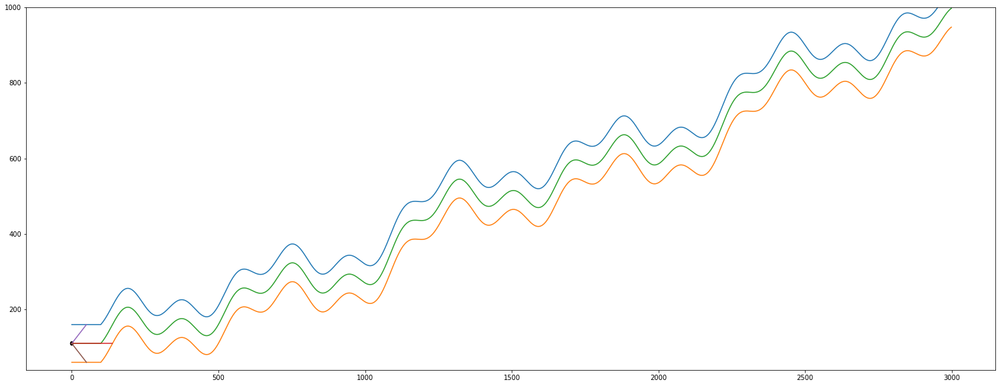

In [5]:
road = Road(wide = 100)
auto = Car(road)

auto.calculate_distances()
auto.plot()

In [6]:
auto.calculate_distances()

Sensor center =  140
Sensor from left wall =  51
Sensor from right wall =  51
most távolsagra van a felső faltól =  50.0
most távolsagra van az alsó faltól =  50.0
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  0
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  0.0
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  0.0
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  0
			 len(self.sensor_left)   =  0
			 len(self.sensor_center) =  0
			 len(self.sensor_right)  =  0
			 self.x                  =  0
			 -------------- Teszt End --------------


# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------
Sensor center =  140
Sensor from left wall =  51
Sensor from right wall =  51
most távolsagra van a felső faltól =  50.0
most távolsagra van az alsó faltól =  50.0
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  0
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  0.0
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  0.0
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  0
			 len(self.sensor_left)   =  0
			 len(self.sensor_center) =  0
			 len(self.sensor_right)  =  0
			 self.x                  =  0
			 -------------- Teszt End --------------
			 ---------------- 

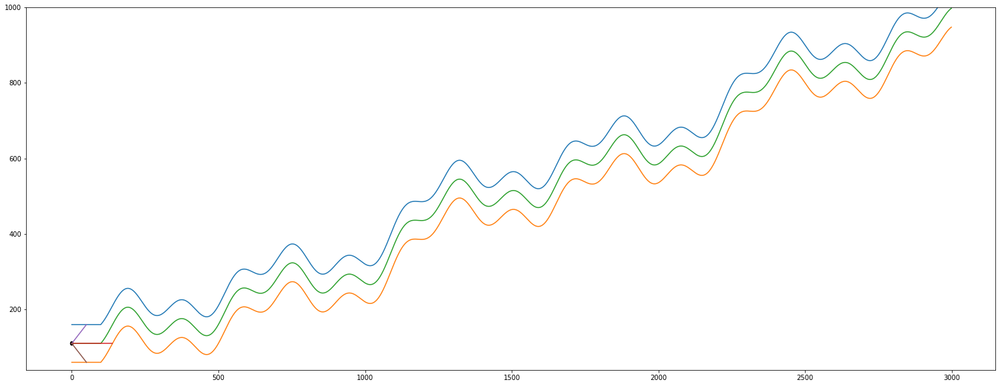

Streaming output truncated to the last 5000 lines.
		  [[ 47.         104.36705314  55.        ]]
		 ---------------Brutálisan hülye dolgot jelez előre ezért ellenőrizni kell, hogy mi a gond. Esetleg a bemeneti adatok?-----------------
		 predicted_position linreg model            =  [[4.]]
		 predicted_position neural net model scaled =  [1.26788339]
		 predicted_position neural net model inverz =  [[3.66970849]]
			 xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx
			    ez az _X úgy, hogy a régi x_minmaxscaler alapján lett -1, 1 közé szorítva
			 _X_scaled =  [[-1.4        -0.87541826  1.4       ]]
			    ez a predicted y úgy, hogy a régi y_minmaxscaler alapján lett -1, 1 közé szorítva
			 predicted_position_scaled =  [1.26788339]
		 --------------------------------------------------------------------------------------------------------------------------------------
		 adott j-re 3 kiszámoltuk az előrejelzést de még nem hoztunk döntést --------------------------------------------

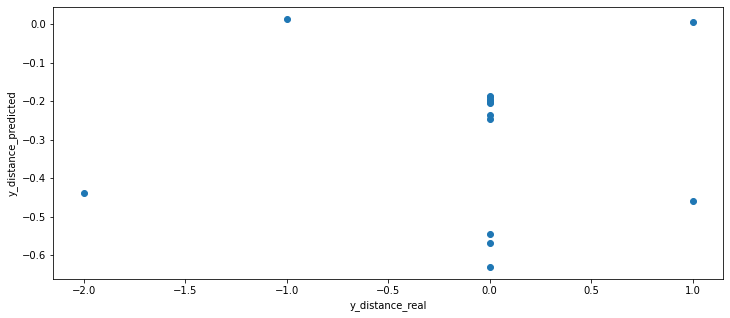

(65, 1)
(65, 1)


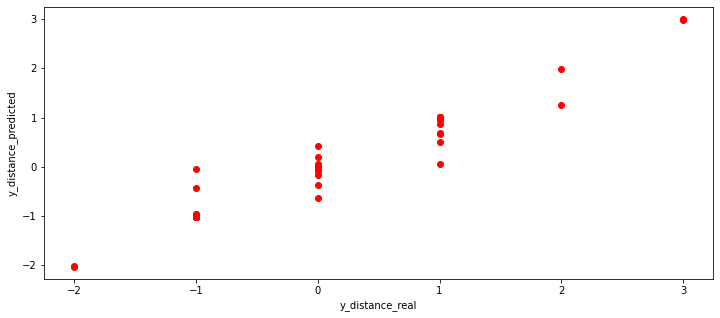

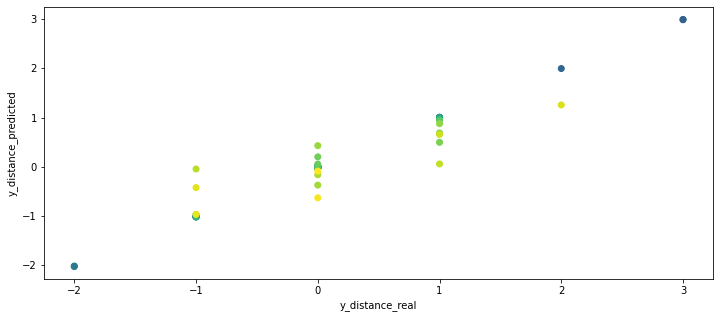

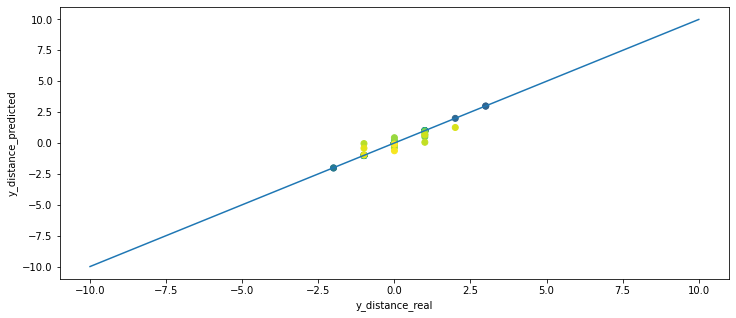

 --- plot predcition --- 


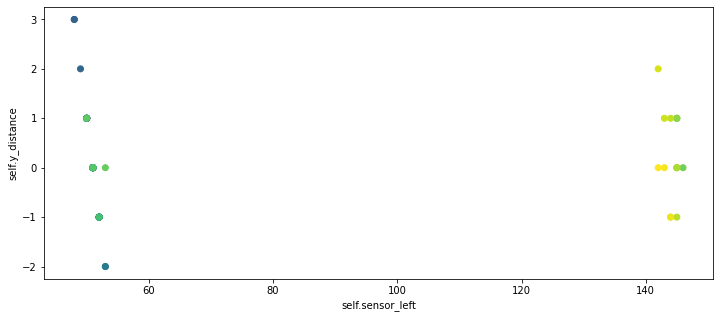

óóóóóó
65
[51, 51, 51, 50, 50, 50, 51, 51, 51, 52, 52, 52, 51, 51, 51, 50, 51, 51, 52, 48, 48, 49, 51, 51, 50, 53, 53, 52, 51, 51, 52, 51, 51, 52, 51, 51, 50, 51, 51, 50, 51, 51, 52, 51, 51, 52, 51, 51, 50, 53, 146, 145, 145, 145, 145, 145, 145, 145, 144, 143, 142, 144, 144, 143, 142]
áááááá
65
[0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 3.0, 3.0, 2.0, 0.0, 0.0, 1.0, -2.0, -2.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, -1.0, 0.0, 0.0, -1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, -1.0, 1.0, 1.0, 2.0, -1.0, -1.0, 0.0, 0.0]
# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
110.0
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken 

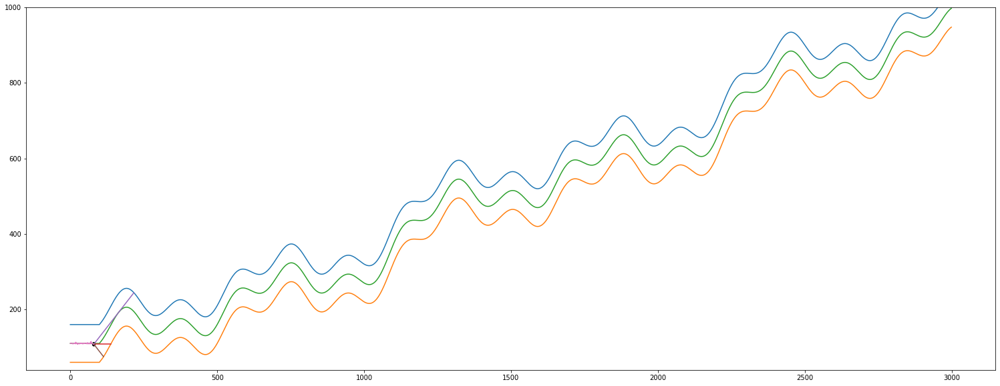

Streaming output truncated to the last 5000 lines.
			 len(self.sensor_left)   =  137
			 len(self.sensor_center) =  137
			 len(self.sensor_right)  =  137
			 self.x                  =  137
			 -------------- Teszt End --------------
			 ---------------- Append ----------------
			 len(self.y_distance)    =  138
			 len(self.sensor_left)   =  138
			 len(self.sensor_center) =  138
			 len(self.sensor_right)  =  138
			 self.x                  =  137
			 -------------- Append End --------------
------------------------------ IF i % 3 == 2 ------------------------------
# i =  137
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> down first
Sensor center =  48
Sensor from left wall =  86
Sensor from right wall =  21
most távolsagra van a felső faltól =  53.37660352763322
most távolsagra van az alsó faltól =  46.62339647236678
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  137
ccc

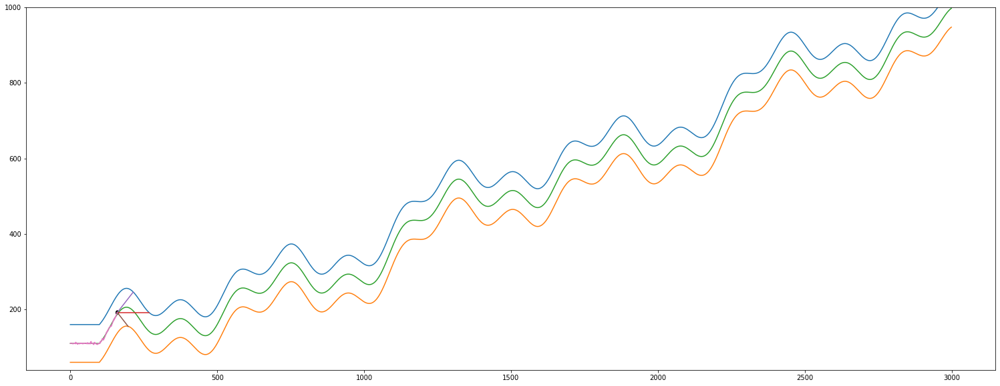

 --- plot --- 
------------------------------ IF i % 3 == 1 ------------------------------
# i =  160
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 55 109  38]]
actual predicted =  [0.05774765]
actual self.y_distance[-1] =  4.321952441913226
len(self.y_distance_real)      =  47
len(self.y_distance_predicted) =  47


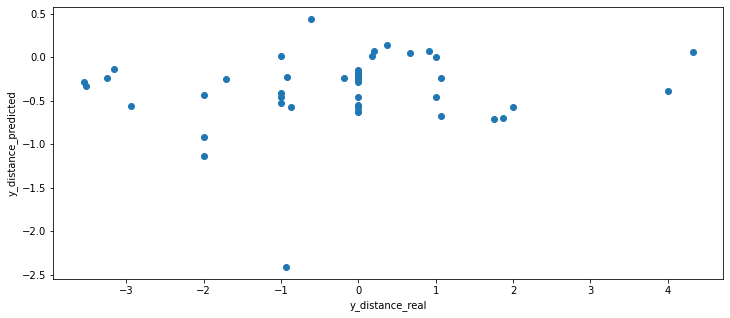

(161, 1)
(161, 1)


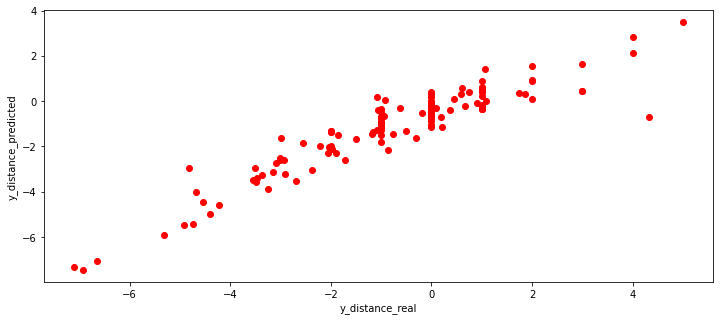

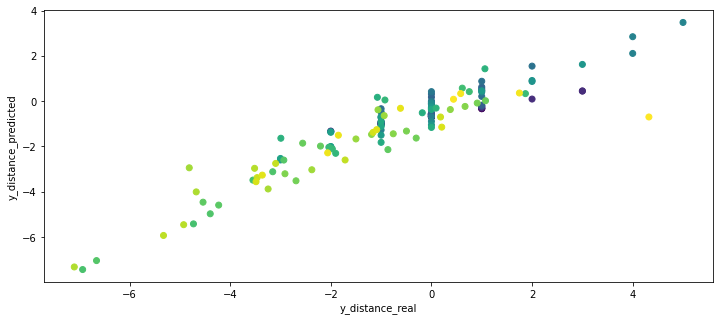

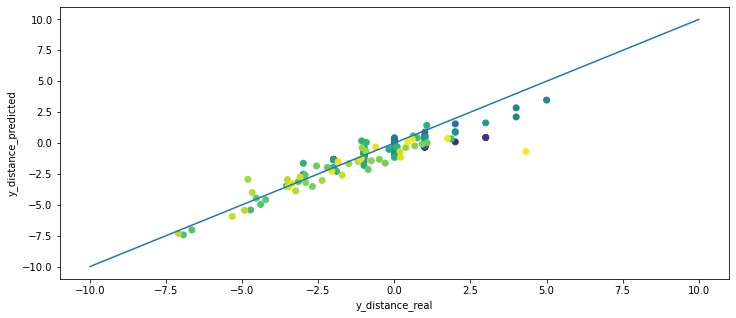

 --- plot predcition --- 


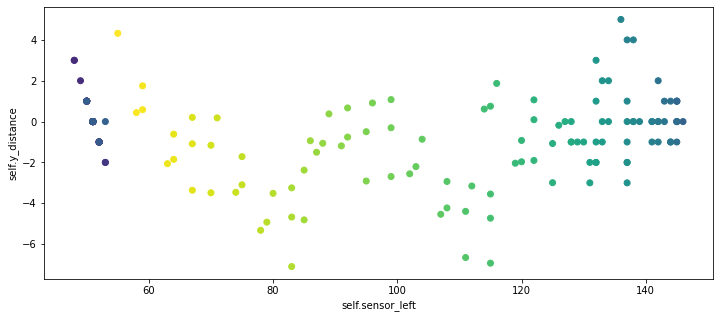

Streaming output truncated to the last 5000 lines.
		 regression_right.intercept_  =  0.0
		 # Ez lesz a bemenete a neurális hálónak
		 -------------------------X-------------------------
		  [[ 22.77858755  61.02112799 110.11611315]]
		 ---------------Brutálisan hülye dolgot jelez előre ezért ellenőrizni kell, hogy mi a gond. Esetleg a bemeneti adatok?-----------------
		 predicted_position linreg model            =  [[0.49405779]]
		 predicted_position neural net model scaled =  [0.28671099]
		 predicted_position neural net model inverz =  [[0.76983446]]
			 xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx
			    ez az _X úgy, hogy a régi x_minmaxscaler alapján lett -1, 1 közé szorítva
			 _X_scaled =  [[-1.03671756 -0.83966228  0.76924492]]
			    ez a predicted y úgy, hogy a régi y_minmaxscaler alapján lett -1, 1 közé szorítva
			 predicted_position_scaled =  [0.28671099]
		 ---------------------------------------------------------------------------------------------------------

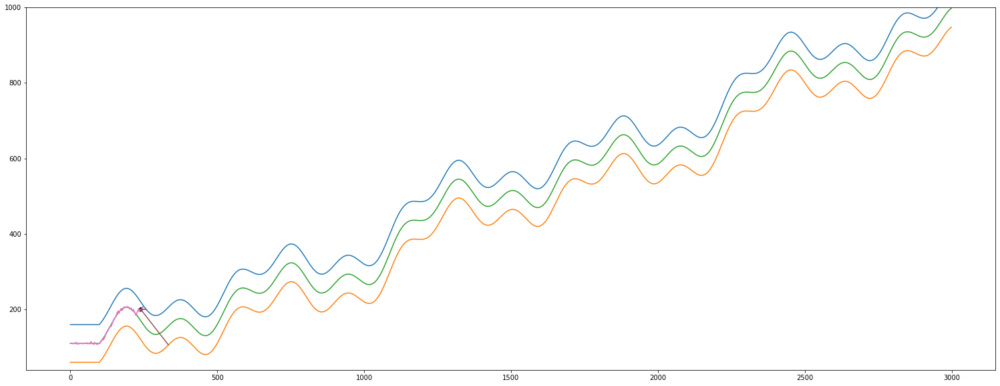

 --- plot --- 
------------------------------ IF i % 3 == 0 ------------------------------
# i =  240
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (241, 3)
y.shape =  (241, 1)
i       =  240
---------------------
X.max =  394
X.min =  10
y.max =  30.34323264156842
y.min =  -7.097270329434792
---------------------
X_scaled.max =  1.0
X_scaled.min =  -1.0
y_scaled.max =  1.0000000000000002
y_scaled.min =  -1.0
---------------------
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  240
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
# Linear Regression Learning --------------------------------------------------------------------------------------
		 # Linear Regression Training Results -------------------------------------------------------------------------
		 ------------------------

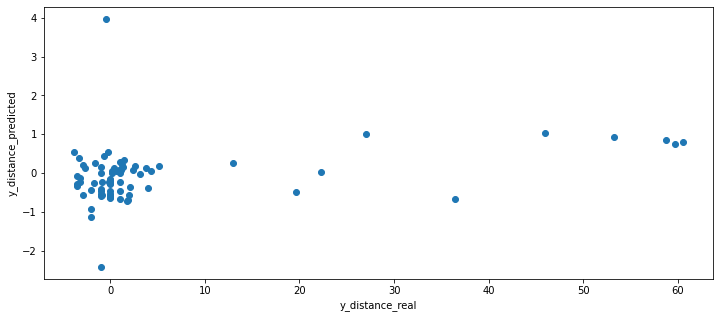

(257, 1)
(257, 1)


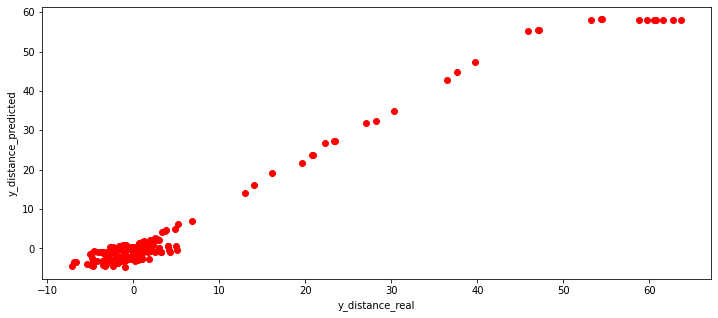

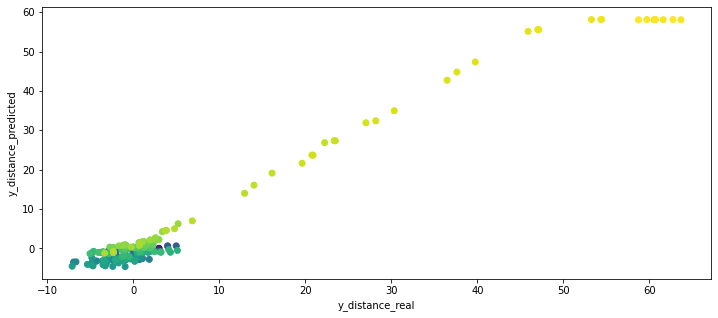

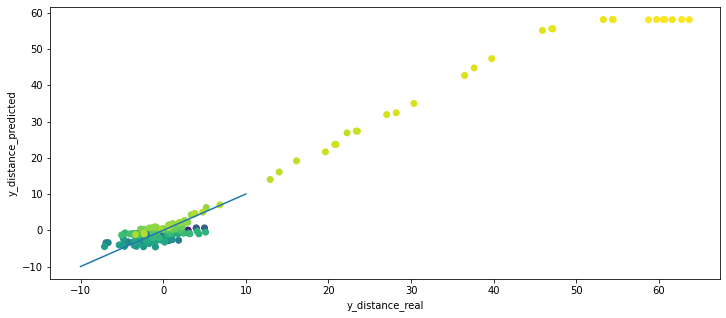

 --- plot predcition --- 


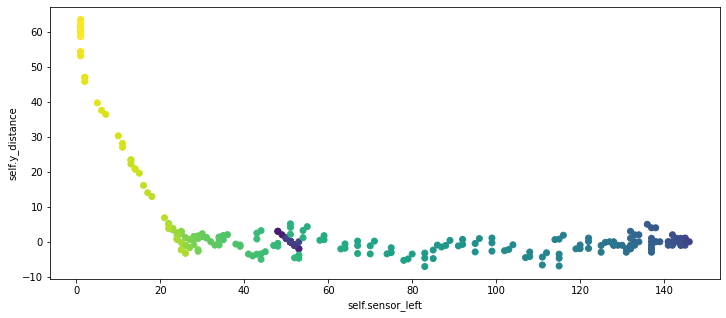

Streaming output truncated to the last 5000 lines.
		 predicted_position linreg model            =  [[25.78036989]]
		 predicted_position neural net model scaled =  [0.75411519]
		 predicted_position neural net model inverz =  [[78.69723449]]
			 xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx
			    ez az _X úgy, hogy a régi x_minmaxscaler alapján lett -1, 1 közé szorítva
			 _X_scaled =  [[-0.98914367 -1.01362105  0.22883553]]
			    ez a predicted y úgy, hogy a régi y_minmaxscaler alapján lett -1, 1 közé szorítva
			 predicted_position_scaled =  [0.75411519]
		 --------------------------------------------------------------------------------------------------------------------------------------
		 adott j-re -2 kiszámoltuk az előrejelzést de még nem hoztunk döntést -------------------------------------------------
		 --------------------------------------------------------------------------------------------------------------------------------------


		 minden j-re kiszámolom a 

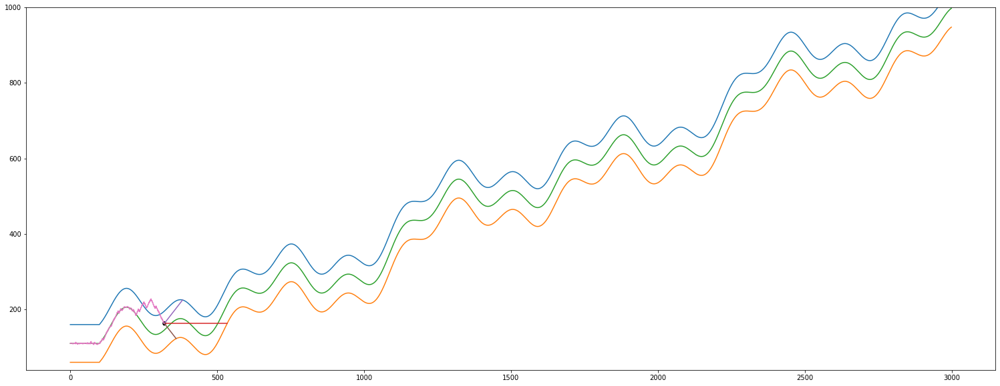

Streaming output truncated to the last 5000 lines.

------------------------------ IF i % 3 == 0 ------------------------------
=================== TAKE ACTION ===================
-------- ennyivel módosítom self.y értékét --------
self.y régi értéke =  154.0
Sensor center =  199
Sensor from left wall =  71
Sensor from right wall =  30
most távolsagra van a felső faltól =  51.72685833669243
most távolsagra van az alsó faltól =  48.273141663307555
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  327
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  -1.7268583366924304
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  -1.7268583366924304
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  328
			 len(self.sensor_left)   =  32

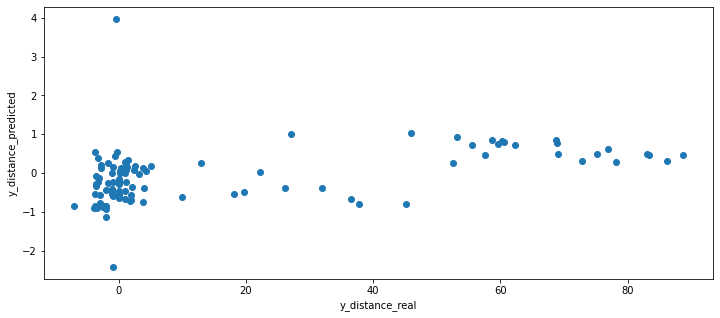

(353, 1)
(353, 1)


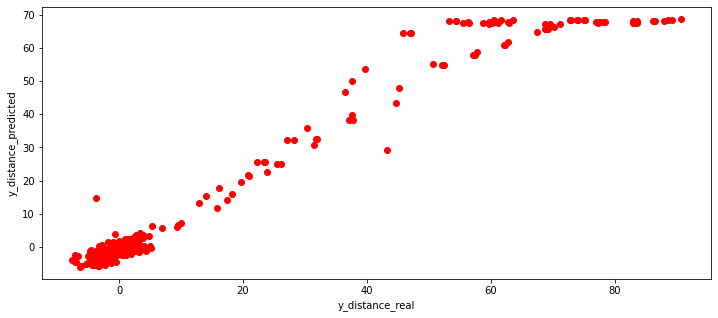

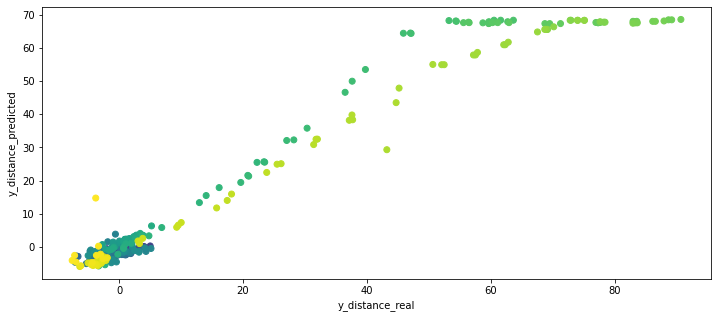

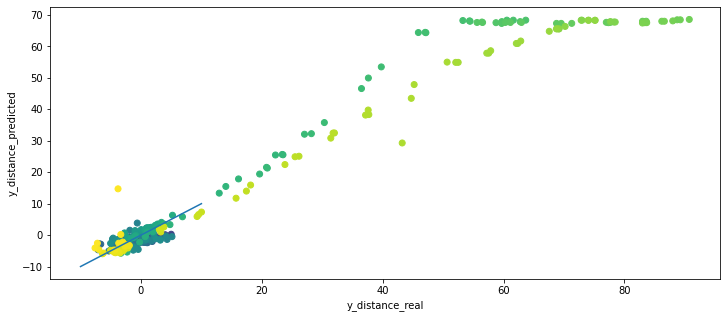

 --- plot predcition --- 


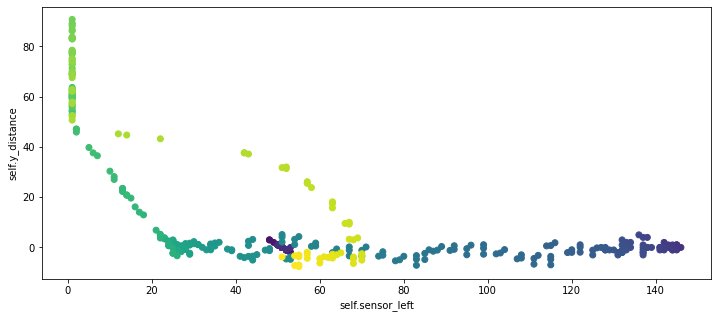

Streaming output truncated to the last 5000 lines.
		 predicted_left   =  [[50.00696899]]
		 predicted_center =  [[144.1273135]]
		 predicted_right  =  [[53.15321645]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.99091661 -0.5297781 ]]
		 regression_center.coef_ =  [[0.95996814 0.13209291]]
		 regression_right.coef_  =  [[0.99929407 1.18992503]]
		 regression_left.intercept_   =  0.0
		 regression_center.intercept_ =  0.0
		 regression_right.intercept_  =  0.0
		 # Ez lesz a bemenete a neurális hálónak
		 -------------------------X-------------------------
		  [[ 50.00696899 144.1273135   53.15321645]]
		 ---------------Brutálisan hülye dolgot jelez előre ezért ellenőrizni kell, hogy mi a gond. Esetleg a bemeneti adatok?-----------------
		 predicted_position linreg model            =  [[6.08212749]]
		 predicted_position neural net model scaled =  [-0.60468244]
		 predicted_position neural net model inverz

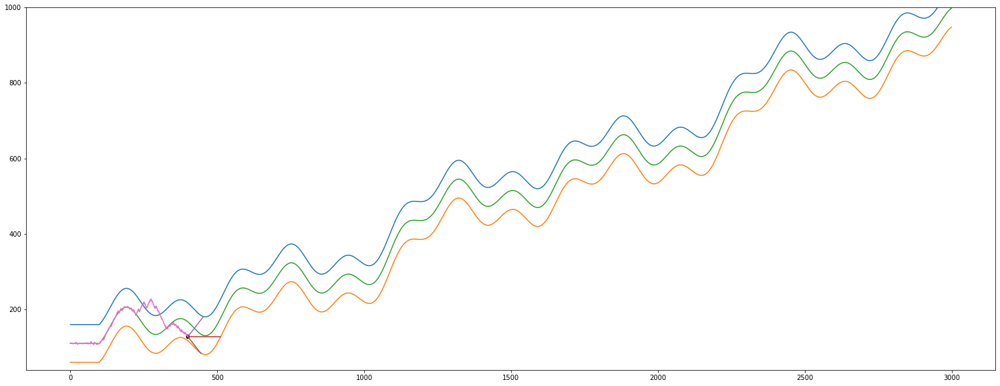

Streaming output truncated to the last 5000 lines.
		 regression_center.coef_ =  [[0.96351906 0.14339092]]
		 regression_right.coef_  =  [[0.99770588 1.35987415]]
		 regression_left.intercept_   =  0.0
		 regression_center.intercept_ =  0.0
		 regression_right.intercept_  =  0.0
		 # Ez lesz a bemenete a neurális hálónak
		 -------------------------X-------------------------
		  [[45.4670373  91.82109251 55.59815997]]
		 ---------------Brutálisan hülye dolgot jelez előre ezért ellenőrizni kell, hogy mi a gond. Esetleg a bemeneti adatok?-----------------
		 predicted_position linreg model            =  [[6.27903623]]
		 predicted_position neural net model scaled =  [-0.47599724]
		 predicted_position neural net model inverz =  [[-8.13712046]]
			 xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx
			    ez az _X úgy, hogy a régi x_minmaxscaler alapján lett -1, 1 közé szorítva
			 _X_scaled =  [[-0.38666155 -0.53780615 -0.28935612]]
			    ez a predicted y úgy, hogy a régi y_minmaxscale

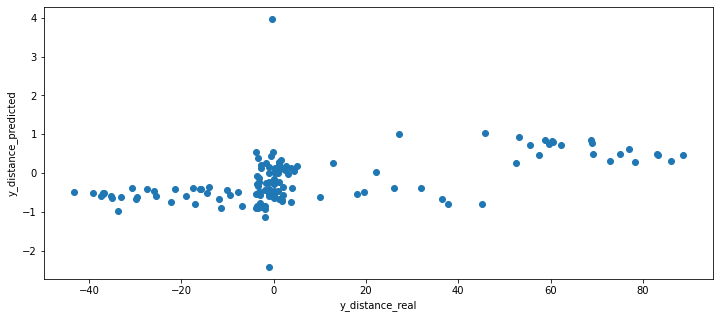

(449, 1)
(449, 1)


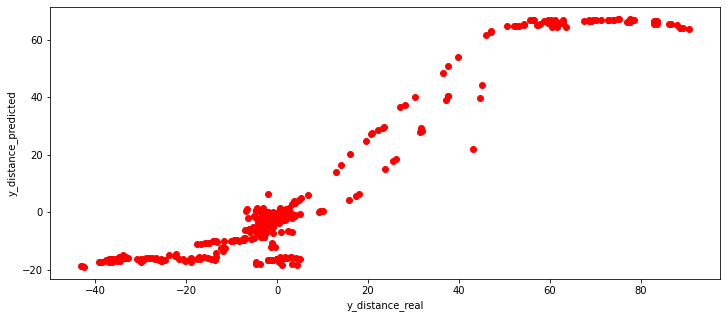

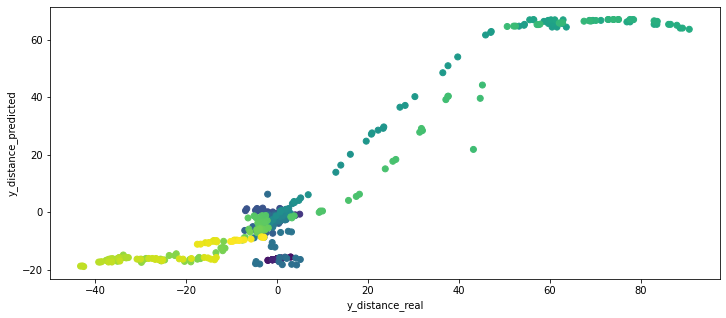

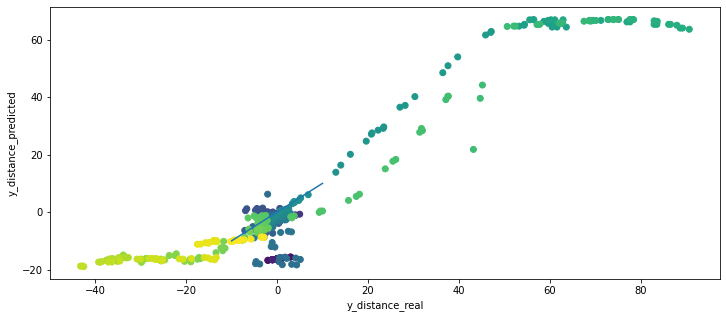

 --- plot predcition --- 


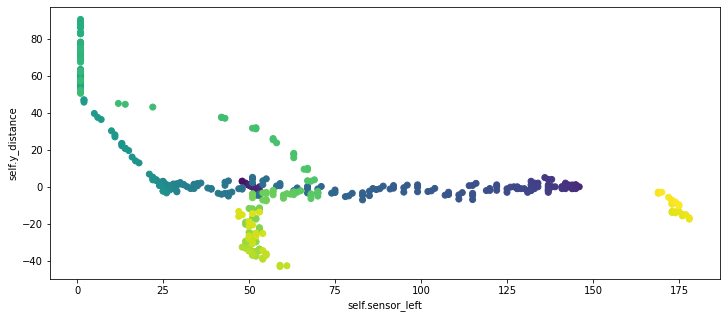

Streaming output truncated to the last 5000 lines.
			 len(self.sensor_center) =  455
			 len(self.sensor_right)  =  455
			 self.x                  =  455
			 -------------- Teszt End --------------
			 ---------------- Append ----------------
			 len(self.y_distance)    =  456
			 len(self.sensor_left)   =  456
			 len(self.sensor_center) =  456
			 len(self.sensor_right)  =  456
			 self.x                  =  455
			 -------------- Append End --------------
------------------------------ IF i % 3 == 2 ------------------------------
# i =  455
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> up second
Sensor center =  57
Sensor from left wall =  170
Sensor from right wall =  33
most távolsagra van a felső faltól =  53.983767807647496
most távolsagra van az alsó faltól =  46.016232192352504
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  455
cccccccccccccccccccccccccccccccccccc

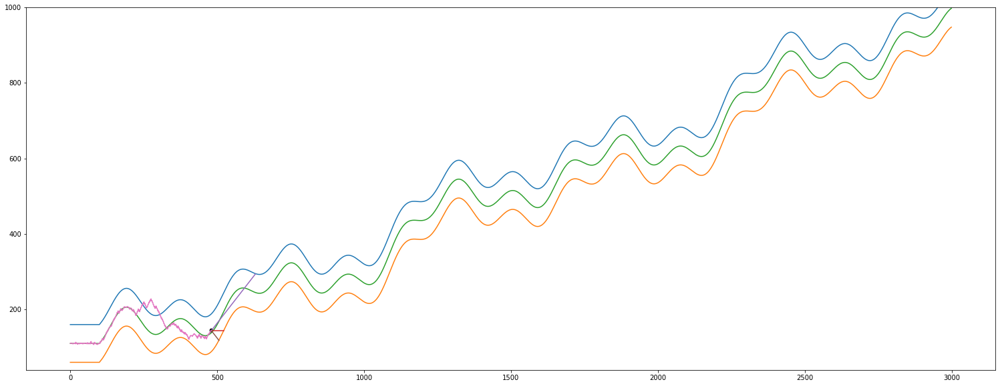

Streaming output truncated to the last 5000 lines.
# 			 _summary_action_were_taken         =  1
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------
Sensor center =  36
Sensor from left wall =  107
Sensor from right wall =  20
most távolsagra van a felső faltól =  50.9288795112586
most távolsagra van az alsó faltól =  49.0711204887414
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  520
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  -0.9288795112586001
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolság

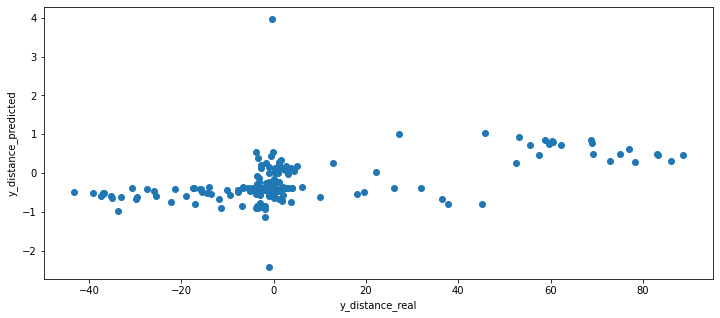

(545, 1)
(545, 1)


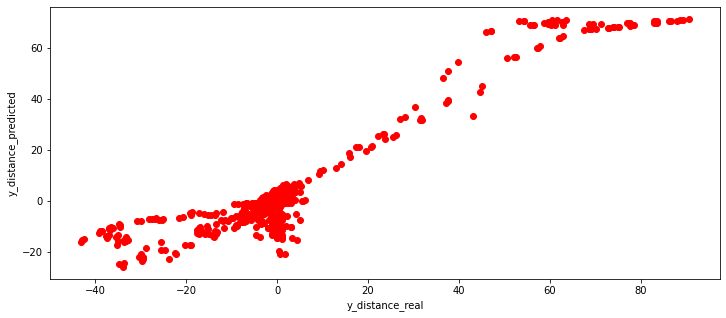

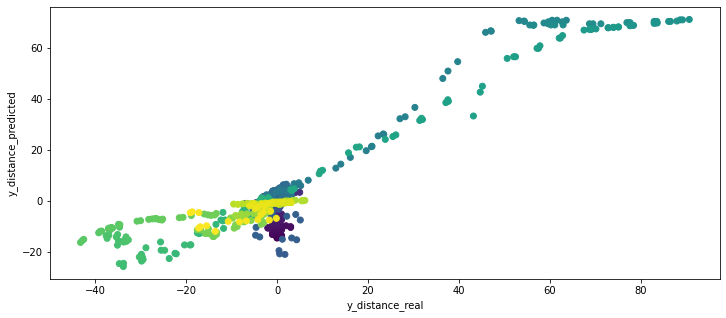

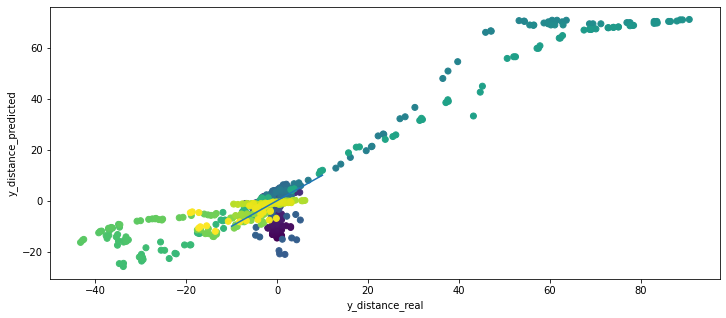

 --- plot predcition --- 


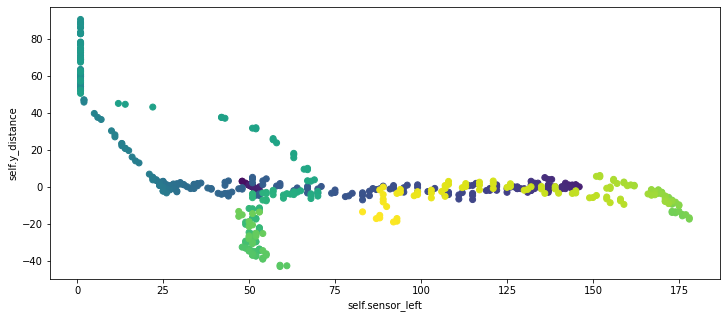

óóóóóó
545
[51, 51, 51, 50, 50, 50, 51, 51, 51, 52, 52, 52, 51, 51, 51, 50, 51, 51, 52, 48, 48, 49, 51, 51, 50, 53, 53, 52, 51, 51, 52, 51, 51, 52, 51, 51, 50, 51, 51, 50, 51, 51, 52, 51, 51, 52, 51, 51, 50, 53, 146, 145, 145, 145, 145, 145, 145, 145, 144, 143, 142, 144, 144, 143, 142, 142, 142, 141, 141, 141, 138, 137, 136, 139, 138, 137, 138, 137, 137, 137, 137, 137, 134, 133, 132, 134, 133, 132, 133, 132, 132, 132, 131, 131, 130, 129, 128, 128, 128, 127, 126, 125, 125, 122, 122, 122, 120, 120, 119, 116, 115, 114, 115, 115, 115, 112, 111, 111, 108, 108, 107, 104, 103, 102, 99, 99, 99, 96, 95, 95, 92, 92, 91, 89, 88, 87, 86, 85, 85, 83, 83, 83, 80, 79, 78, 75, 75, 74, 71, 70, 70, 67, 67, 67, 64, 64, 63, 59, 59, 58, 55, 54, 54, 51, 51, 51, 53, 53, 52, 48, 48, 47, 44, 43, 43, 45, 44, 44, 43, 42, 41, 39, 39, 38, 36, 35, 35, 34, 34, 34, 34, 33, 32, 31, 31, 30, 30, 29, 29, 29, 28, 28, 29, 29, 28, 27, 26, 25, 25, 25, 25, 27, 26, 26, 24, 23, 22, 24, 24, 23, 25, 24, 24, 26, 25, 25, 22, 22, 21

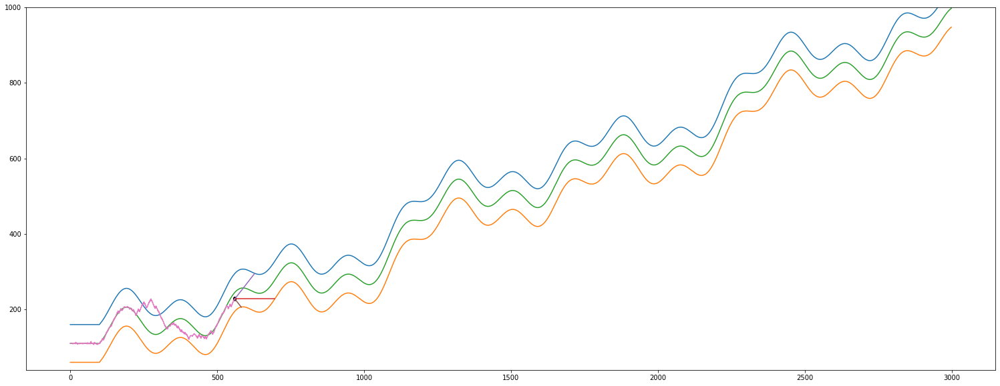

Streaming output truncated to the last 5000 lines.
		 predicted_right  =  [[57.14593981]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.99570183 -0.63384472]]
		 regression_center.coef_ =  [[0.96842999 0.84456539]]
		 regression_right.coef_  =  [[0.99707631 1.10127307]]
		 regression_left.intercept_   =  0.0
		 regression_center.intercept_ =  0.0
		 regression_right.intercept_  =  0.0
		 # Ez lesz a bemenete a neurális hálónak
		 -------------------------X-------------------------
		  [[ 38.92224082 104.2188452   57.14593981]]
		 ---------------Brutálisan hülye dolgot jelez előre ezért ellenőrizni kell, hogy mi a gond. Esetleg a bemeneti adatok?-----------------
		 predicted_position linreg model            =  [[5.4557089]]
		 predicted_position neural net model scaled =  [-0.27187303]
		 predicted_position neural net model inverz =  [[5.53489605]]
			 xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx
			 

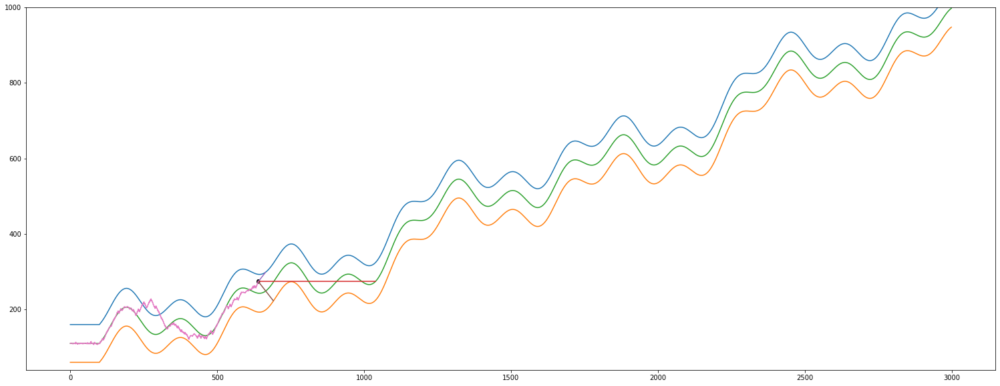

 --- plot --- 
------------------------------ IF i % 3 == 1 ------------------------------
# i =  640
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 25 400  52]]
actual predicted =  [0.09558629]
actual self.y_distance[-1] =  30.98061716188772
len(self.y_distance_real)      =  207
len(self.y_distance_predicted) =  207


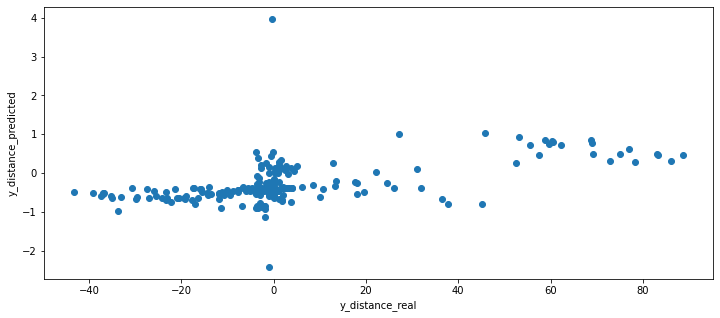

(641, 1)
(641, 1)


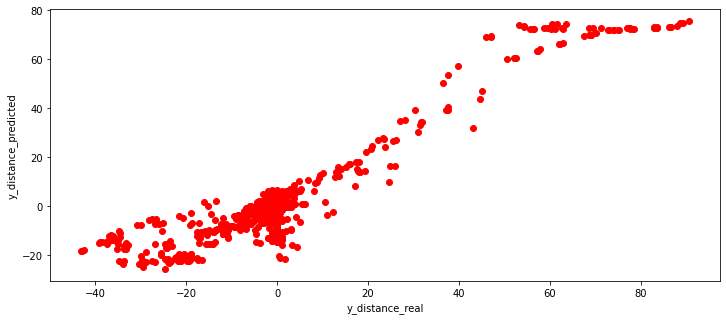

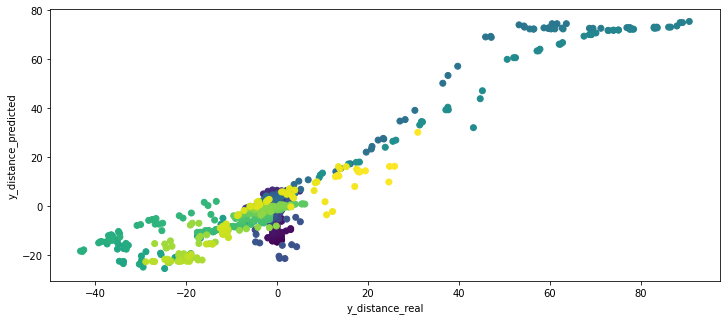

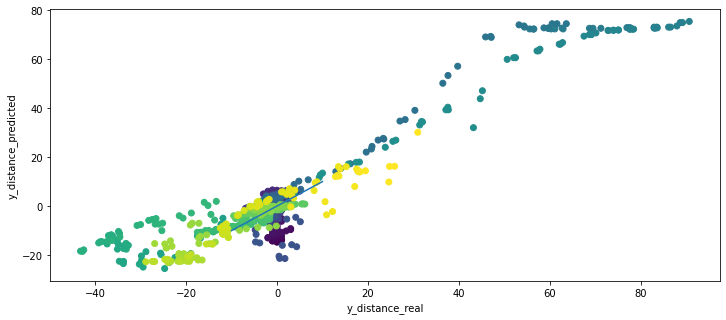

 --- plot predcition --- 


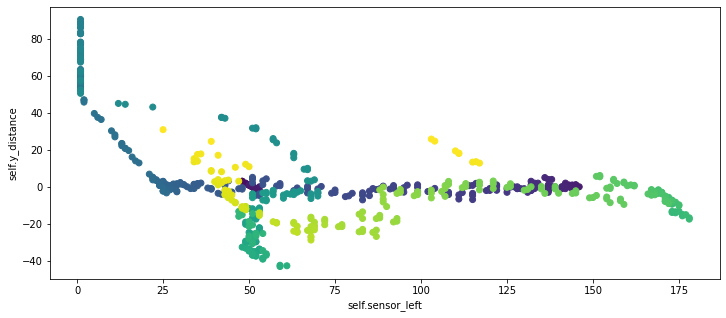

Streaming output truncated to the last 5000 lines.
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  -9.743987367594457
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  695
			 len(self.sensor_left)   =  695
			 len(self.sensor_center) =  695
			 len(self.sensor_right)  =  695
			 self.x                  =  695
			 -------------- Teszt End --------------
			 ---------------- Append ----------------
			 len(self.y_distance)    =  696
			 len(self.sensor_left)   =  696
			 len(self.sensor_center) =  696
			 len(self.sensor_right)  =  696
			 self.x                  =  695
			 -------------- Append End --------------
------------------------------ IF i % 3 == 2 ------------------------------
# i =  695
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> up second
Sensor center =  42
Sensor from left wall =  89
Sens

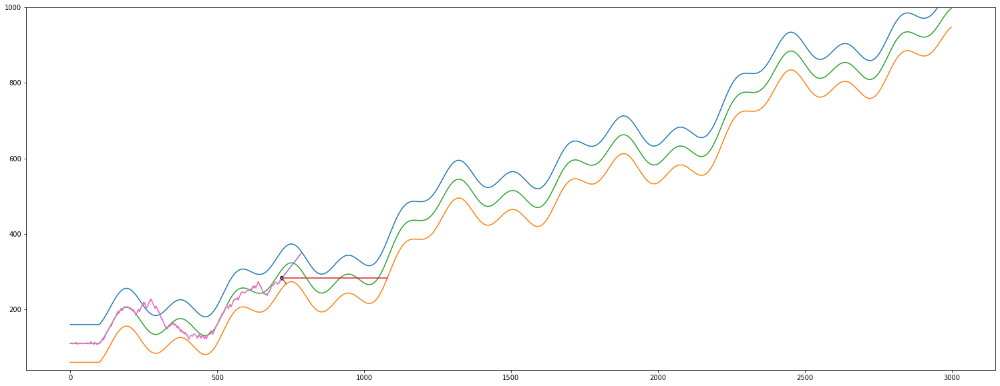

 --- plot --- 
------------------------------ IF i % 3 == 0 ------------------------------
# i =  720
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (721, 3)
y.shape =  (721, 1)
i       =  720
---------------------
X.max =  400
X.min =  1
y.max =  90.72356321549958
y.min =  -43.23425365063727
---------------------
X_scaled.max =  1.0000000000000002
X_scaled.min =  -1.0
y_scaled.max =  1.0
y_scaled.min =  -1.0
---------------------
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  720
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
# Linear Regression Learning --------------------------------------------------------------------------------------
		 # Linear Regression Training Results -------------------------------------------------------------------------
		 -------------------------

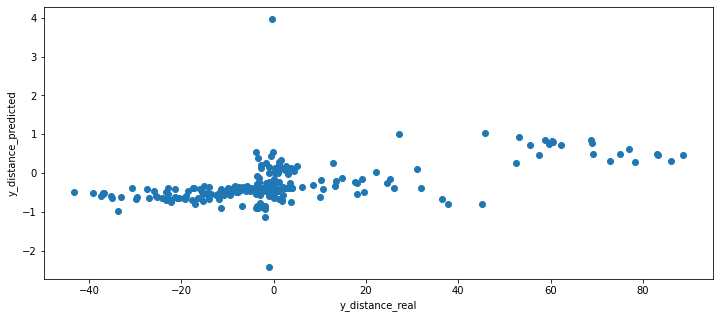

(737, 1)
(737, 1)


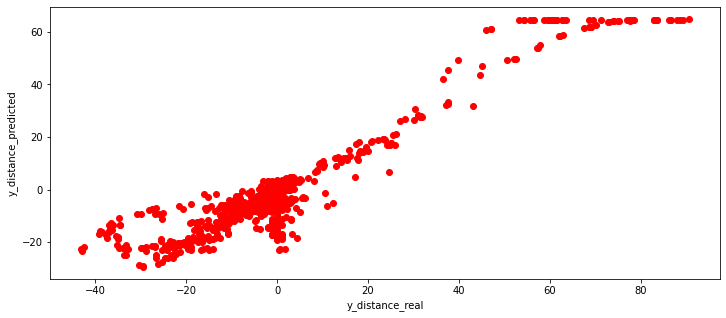

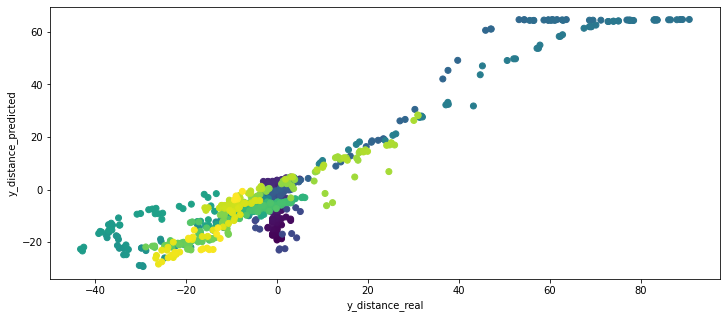

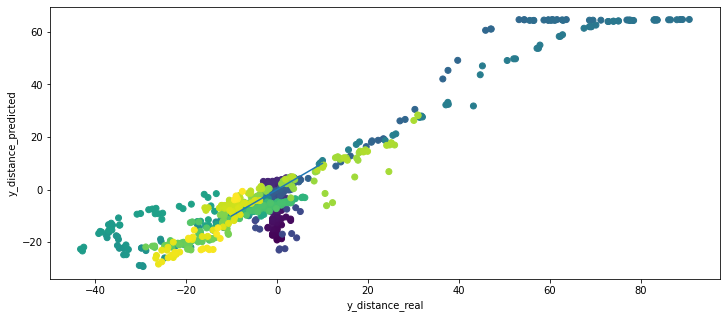

 --- plot predcition --- 


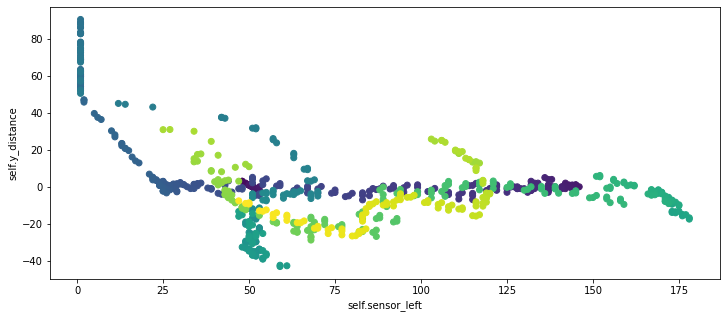

Streaming output truncated to the last 5000 lines.
		 regression_left.coef_   =  [[ 0.99388523 -0.95686135]]
		 regression_center.coef_ =  [[0.94556549 1.36516408]]
		 regression_right.coef_  =  [[0.99914029 1.07301722]]
		 regression_left.intercept_   =  0.0
		 regression_center.intercept_ =  0.0
		 regression_right.intercept_  =  0.0
		 # Ez lesz a bemenete a neurális hálónak
		 -------------------------X-------------------------
		  [[ 22.97043183  49.48263567 113.12448384]]
		 ---------------Brutálisan hülye dolgot jelez előre ezért ellenőrizni kell, hogy mi a gond. Esetleg a bemeneti adatok?-----------------
		 predicted_position linreg model            =  [[21.49820425]]
		 predicted_position neural net model scaled =  [-0.28718179]
		 predicted_position neural net model inverz =  [[4.50953196]]
			 xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx
			    ez az _X úgy, hogy a régi x_minmaxscaler alapján lett -1, 1 közé szorítva
			 _X_scaled =  [[-0.75174653 -0.75697927  0.7586

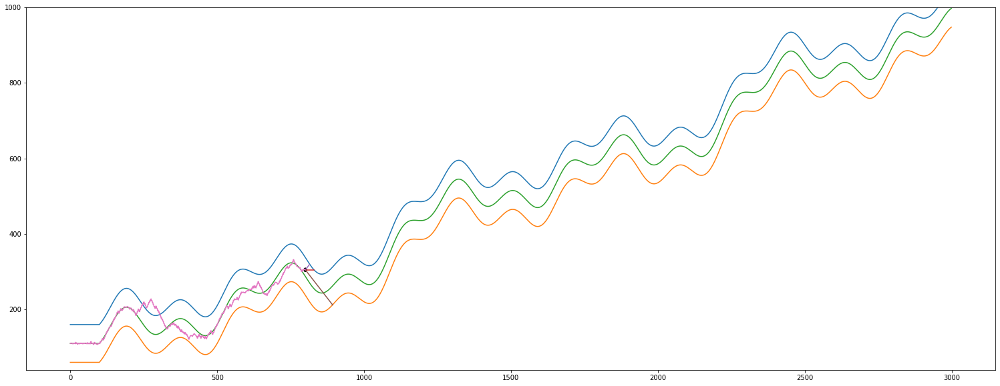

Streaming output truncated to the last 5000 lines.
		 ---------------------
		  action =  1
		  predicted_position =  [[24.37163453]]
		  distance from 0 (tmp)=  [[24.37163453]]
		 ---------------------
		 adott j-re 1 kiszámoltuk az előrejelzést de még nem hoztunk döntést -------------------------------------------------
		 --------------------------------------------------------------------------------------------------------------------------------------


		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  2
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[13  2]]
		 _X_center =  [[27  2]]
		 _X_right  =  [[89  2]]
		 predicted_left   =  [[11.02836794]]
		 predicted_center =  [[28.14425325]]
		 predicted_right  =  [[91.06590519]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.99379456 -0.94

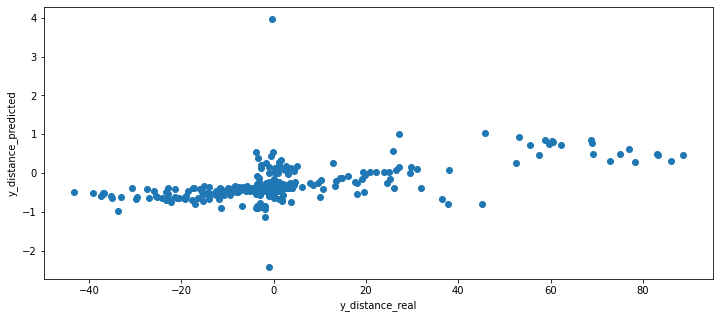

(833, 1)
(833, 1)


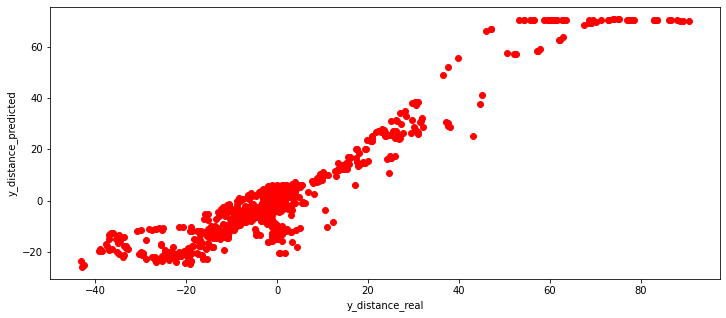

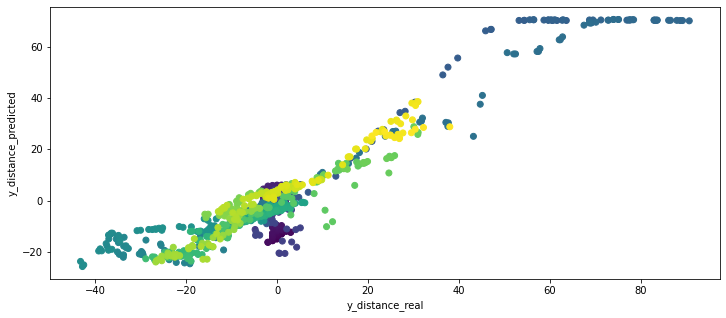

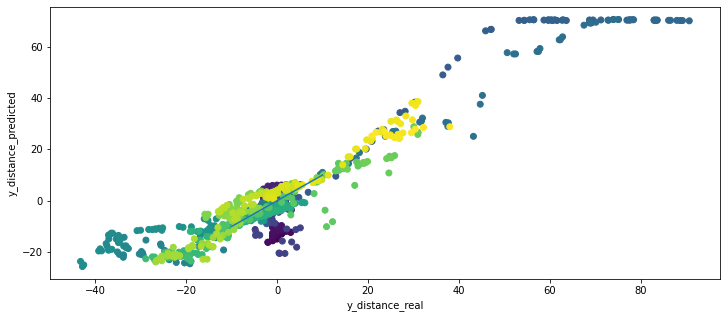

 --- plot predcition --- 


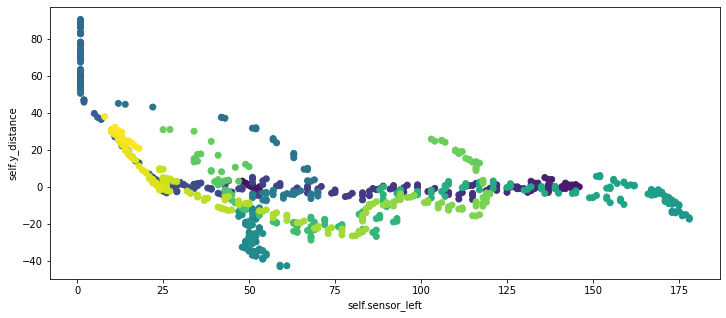

Streaming output truncated to the last 5000 lines.
		 predicted_left   =  [[59.65352338]]
		 predicted_center =  [[210.20899964]]
		 predicted_right  =  [[51.02577755]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.99388239 -0.97330258]]
		 regression_center.coef_ =  [[0.95579974 0.88885599]]
		 regression_right.coef_  =  [[0.99996394 1.02758057]]
		 regression_left.intercept_   =  0.0
		 regression_center.intercept_ =  0.0
		 regression_right.intercept_  =  0.0
		 # Ez lesz a bemenete a neurális hálónak
		 -------------------------X-------------------------
		  [[ 59.65352338 210.20899964  51.02577755]]
		 ---------------Brutálisan hülye dolgot jelez előre ezért ellenőrizni kell, hogy mi a gond. Esetleg a bemeneti adatok?-----------------
		 predicted_position linreg model            =  [[-1.74156185]]
		 predicted_position neural net model scaled =  [-0.10210732]
		 predicted_position neural net model inve

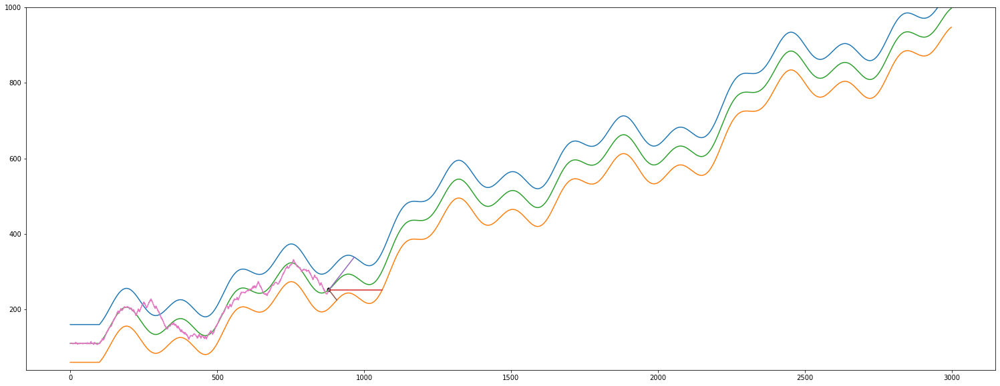

Streaming output truncated to the last 5000 lines.
		 _X_right  =  [[29  4]]
		 predicted_left   =  [[64.70661136]]
		 predicted_center =  [[166.04366819]]
		 predicted_right  =  [[33.01565207]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.99448766 -0.97825928]]
		 regression_center.coef_ =  [[0.95857894 1.01095662]]
		 regression_right.coef_  =  [[1.00005877 1.00348695]]
		 regression_left.intercept_   =  0.0
		 regression_center.intercept_ =  0.0
		 regression_right.intercept_  =  0.0
		 # Ez lesz a bemenete a neurális hálónak
		 -------------------------X-------------------------
		  [[ 64.70661136 166.04366819  33.01565207]]
		 ---------------Brutálisan hülye dolgot jelez előre ezért ellenőrizni kell, hogy mi a gond. Esetleg a bemeneti adatok?-----------------
		 predicted_position linreg model            =  [[-3.77010066]]
		 predicted_position neural net model scaled =  [-0.51221602]
		 predicted_posi

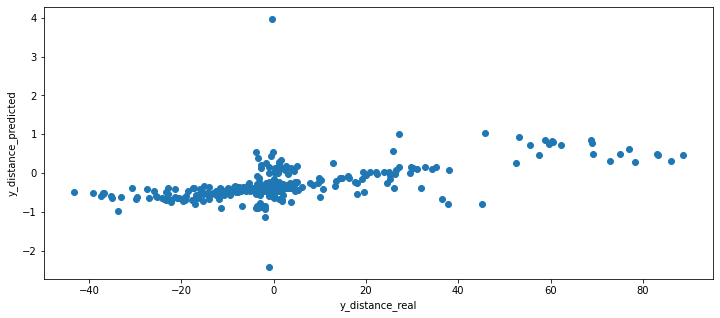

(929, 1)
(929, 1)


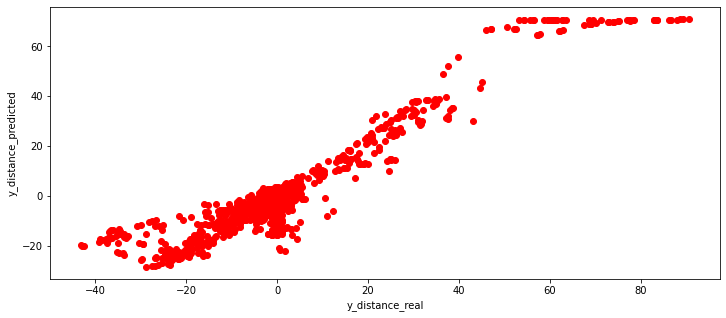

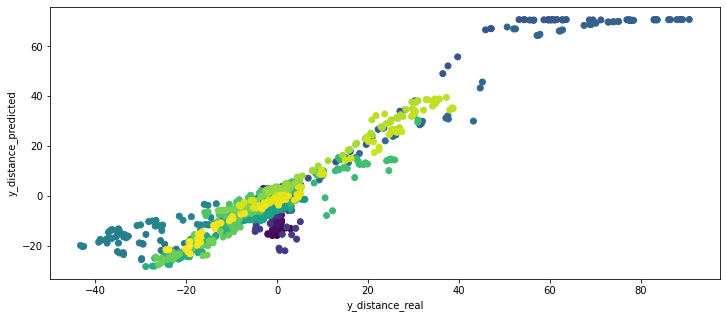

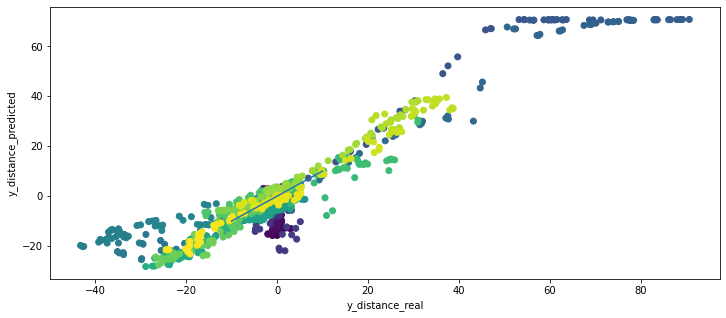

 --- plot predcition --- 


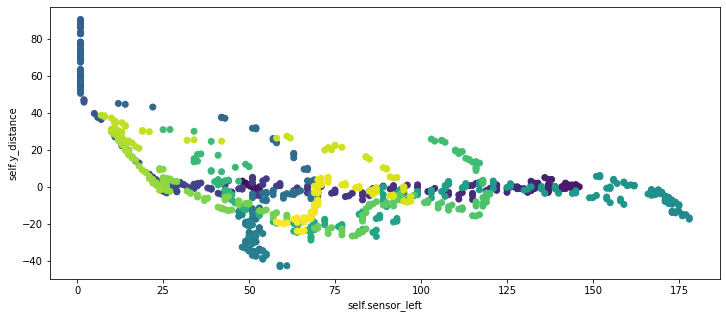

Streaming output truncated to the last 5000 lines.
		 regression_left.coef_   =  [[ 0.99461189 -0.97117332]]
		 regression_center.coef_ =  [[0.96038579 1.00014677]]
		 regression_right.coef_  =  [[1.00011177 1.00532663]]
		 regression_left.intercept_   =  0.0
		 regression_center.intercept_ =  0.0
		 regression_right.intercept_  =  0.0
		 # Ez lesz a bemenete a neurális hálónak
		 -------------------------X-------------------------
		  [[ 49.84778712 141.37551559  42.03076866]]
		 ---------------Brutálisan hülye dolgot jelez előre ezért ellenőrizni kell, hogy mi a gond. Esetleg a bemeneti adatok?-----------------
		 predicted_position linreg model            =  [[-0.01057336]]
		 predicted_position neural net model scaled =  [-0.60895796]
		 predicted_position neural net model inverz =  [[-17.04268454]]
			 xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx
			    ez az _X úgy, hogy a régi x_minmaxscaler alapján lett -1, 1 közé szorítva
			 _X_scaled =  [[-0.4480476  -0.29636333 -0.47

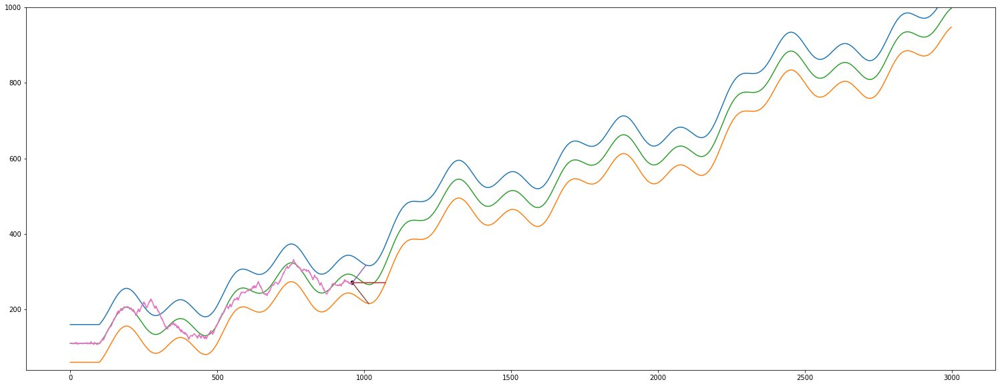

Streaming output truncated to the last 5000 lines.
		 -------------------------X-------------------------
		  [[24.86632126 82.75785004 53.98678344]]
		 ---------------Brutálisan hülye dolgot jelez előre ezért ellenőrizni kell, hogy mi a gond. Esetleg a bemeneti adatok?-----------------
		 predicted_position linreg model            =  [[6.34049707]]
		 predicted_position neural net model scaled =  [0.02906845]
		 predicted_position neural net model inverz =  [[25.69162795]]
			 xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx
			    ez az _X úgy, hogy a régi x_minmaxscaler alapján lett -1, 1 közé szorítva
			 _X_scaled =  [[-0.73032405 -0.59018622 -0.26979507]]
			    ez a predicted y úgy, hogy a régi y_minmaxscaler alapján lett -1, 1 közé szorítva
			 predicted_position_scaled =  [0.02906845]
		 --------------------------------------------------------------------------------------------------------------------------------------
		 adott j-re 0 kiszámoltuk az előrejelzést de még nem

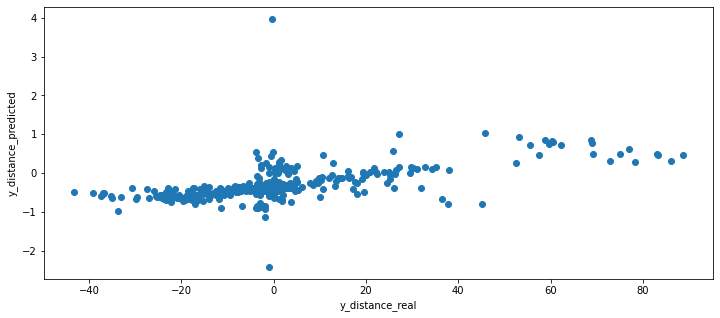

(1025, 1)
(1025, 1)


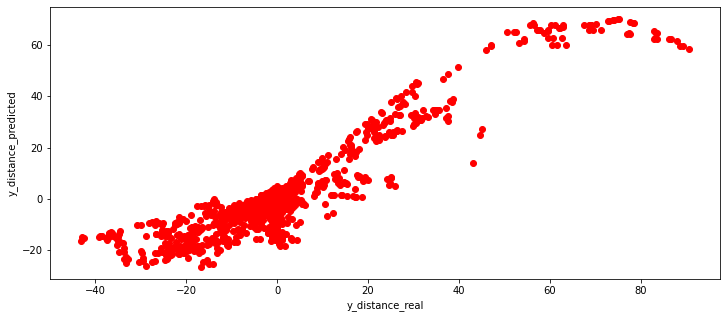

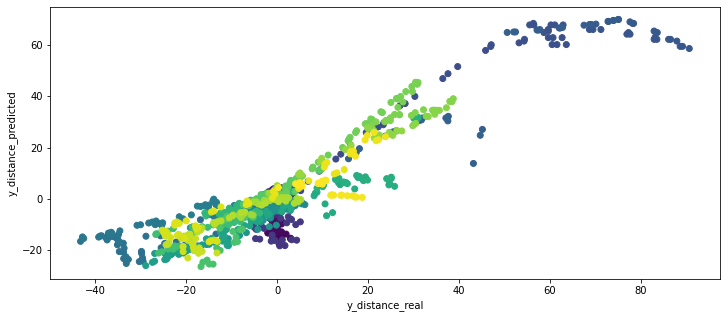

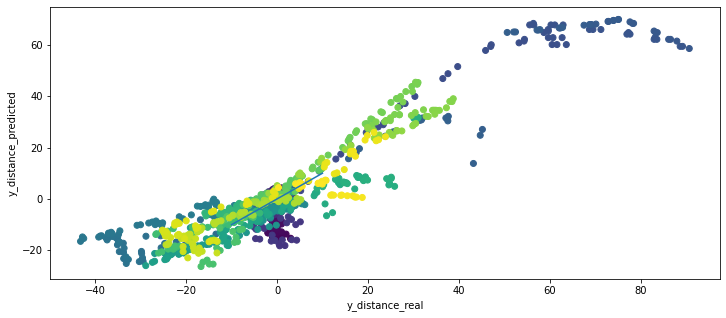

 --- plot predcition --- 


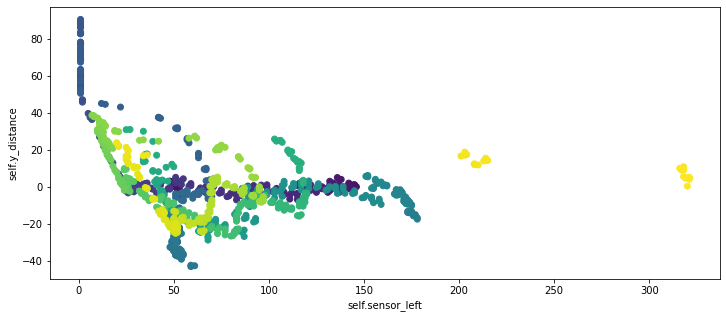

óóóóóó
1025
[51, 51, 51, 50, 50, 50, 51, 51, 51, 52, 52, 52, 51, 51, 51, 50, 51, 51, 52, 48, 48, 49, 51, 51, 50, 53, 53, 52, 51, 51, 52, 51, 51, 52, 51, 51, 50, 51, 51, 50, 51, 51, 52, 51, 51, 52, 51, 51, 50, 53, 146, 145, 145, 145, 145, 145, 145, 145, 144, 143, 142, 144, 144, 143, 142, 142, 142, 141, 141, 141, 138, 137, 136, 139, 138, 137, 138, 137, 137, 137, 137, 137, 134, 133, 132, 134, 133, 132, 133, 132, 132, 132, 131, 131, 130, 129, 128, 128, 128, 127, 126, 125, 125, 122, 122, 122, 120, 120, 119, 116, 115, 114, 115, 115, 115, 112, 111, 111, 108, 108, 107, 104, 103, 102, 99, 99, 99, 96, 95, 95, 92, 92, 91, 89, 88, 87, 86, 85, 85, 83, 83, 83, 80, 79, 78, 75, 75, 74, 71, 70, 70, 67, 67, 67, 64, 64, 63, 59, 59, 58, 55, 54, 54, 51, 51, 51, 53, 53, 52, 48, 48, 47, 44, 43, 43, 45, 44, 44, 43, 42, 41, 39, 39, 38, 36, 35, 35, 34, 34, 34, 34, 33, 32, 31, 31, 30, 30, 29, 29, 29, 28, 28, 29, 29, 28, 27, 26, 25, 25, 25, 25, 27, 26, 26, 24, 23, 22, 24, 24, 23, 25, 24, 24, 26, 25, 25, 22, 22, 2

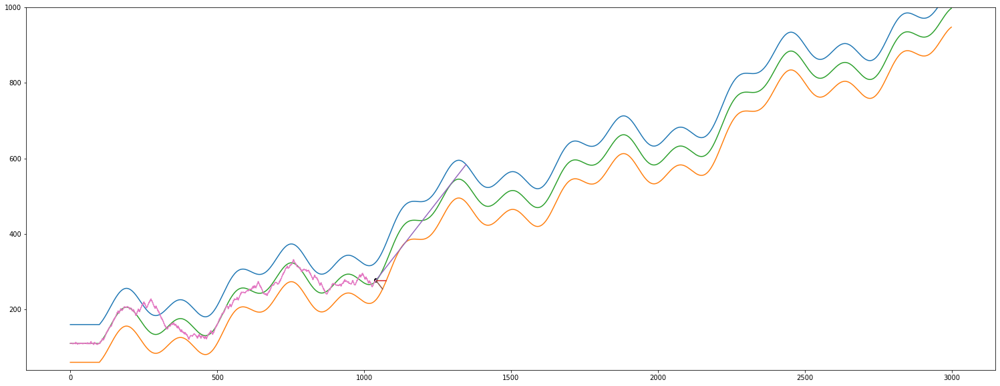

Streaming output truncated to the last 5000 lines.
# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
358.0
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  1
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------
Sensor center =  26
Sensor from left wall =  236
Sensor from right wall =  15
most távolsagra van a felső faltól =  59.77571143263475
most távolsagra van az alsó faltól 

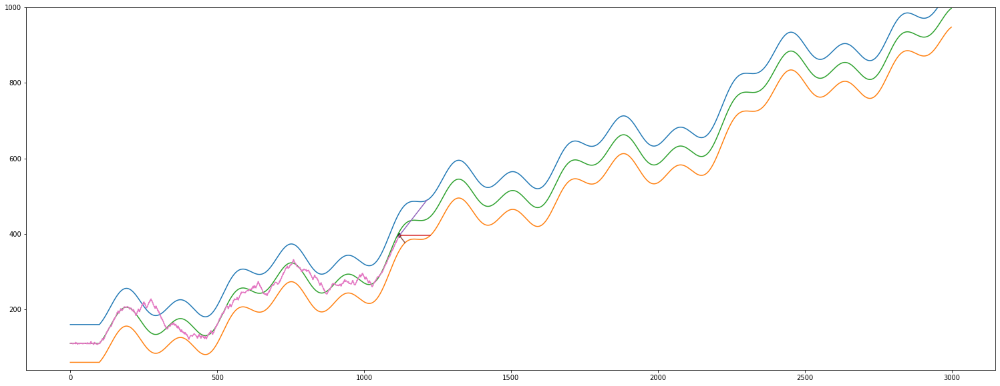

 --- plot --- 
------------------------------ IF i % 3 == 1 ------------------------------
# i =  1120
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 94 107  20]]
actual predicted =  [-0.54018829]
actual self.y_distance[-1] =  -10.106392667115188
len(self.y_distance_real)      =  367
len(self.y_distance_predicted) =  367


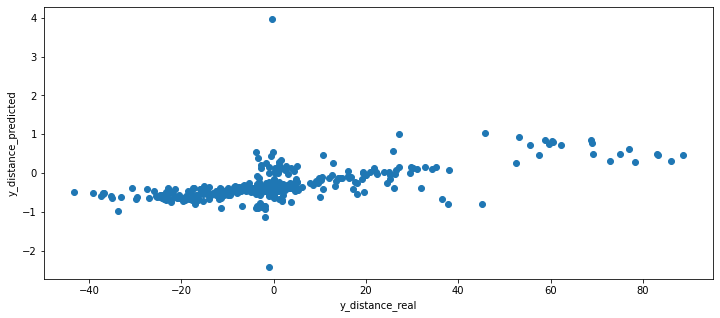

(1121, 1)
(1121, 1)


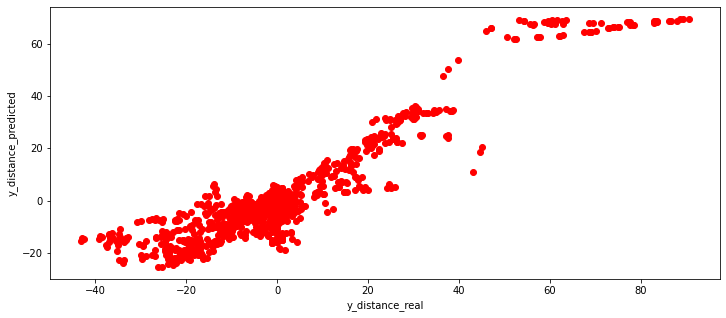

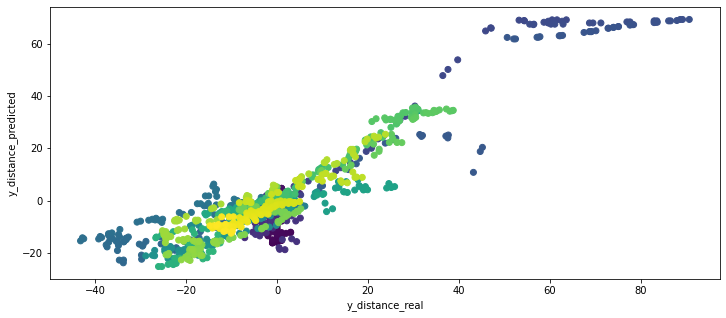

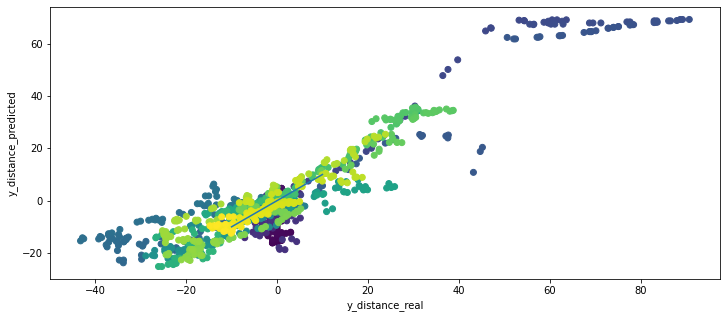

 --- plot predcition --- 


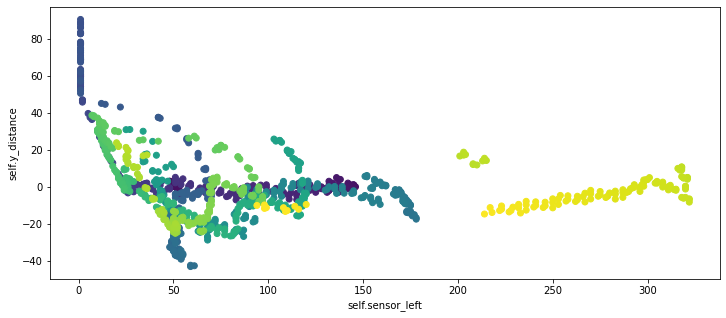

Streaming output truncated to the last 5000 lines.
most távolsagra van a felső faltól =  48.42254265364801
most távolsagra van az alsó faltól =  51.57745734635199
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  1173
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  1.5774573463519914
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  1.5774573463519914
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  1174
			 len(self.sensor_left)   =  1174
			 len(self.sensor_center) =  1174
			 len(self.sensor_right)  =  1174
			 self.x                  =  1173
			 -------------- Teszt End --------------
self.y új értéke   =  438.0
action             =  2
----------------- módosítás vége -----------------
# A run ciklus vége ----------

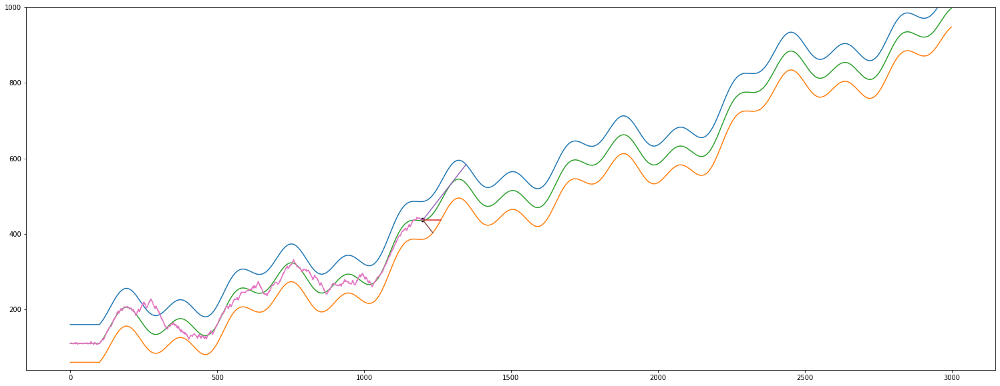

 --- plot --- 
------------------------------ IF i % 3 == 0 ------------------------------
# i =  1200
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (1201, 3)
y.shape =  (1201, 1)
i       =  1200
---------------------
X.max =  400
X.min =  1
y.max =  90.72356321549958
y.min =  -43.23425365063727
---------------------
X_scaled.max =  1.0
X_scaled.min =  -1.0
y_scaled.max =  1.0
y_scaled.min =  -1.0
---------------------
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  1200
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
# Linear Regression Learning --------------------------------------------------------------------------------------
		 # Linear Regression Training Results -------------------------------------------------------------------------
		 ------------------------------- val

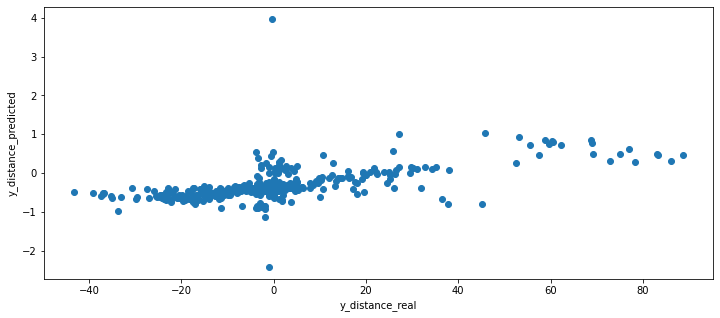

(1217, 1)
(1217, 1)


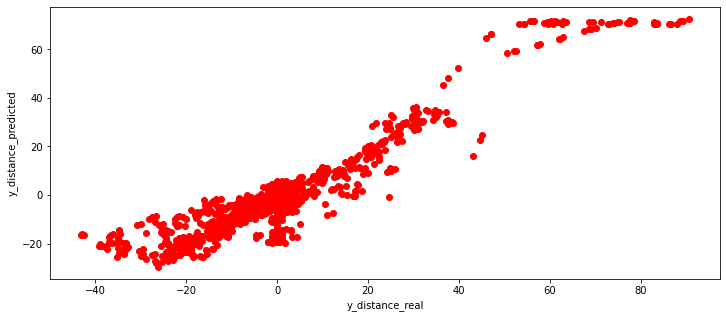

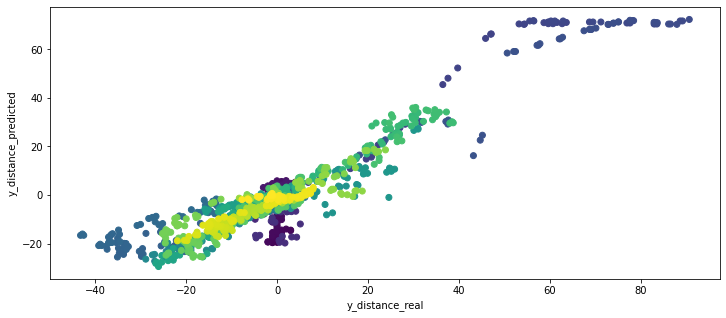

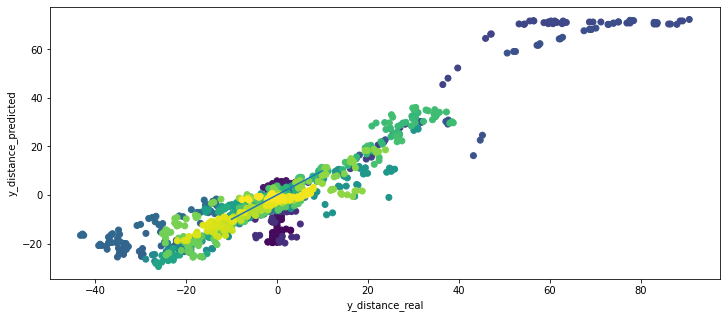

 --- plot predcition --- 


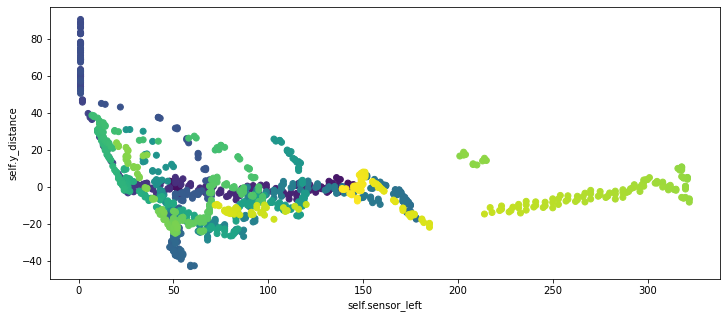

Streaming output truncated to the last 5000 lines.
actual _X_test =  [[97 43 24]]
actual predicted =  [-0.40379242]
actual self.y_distance[-1] =  4.746560955358063
len(self.y_distance_real)      =  412
len(self.y_distance_predicted) =  412
# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
483.0
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  1
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus eleje ----------------------------------------------------------------------------------------------------------------------

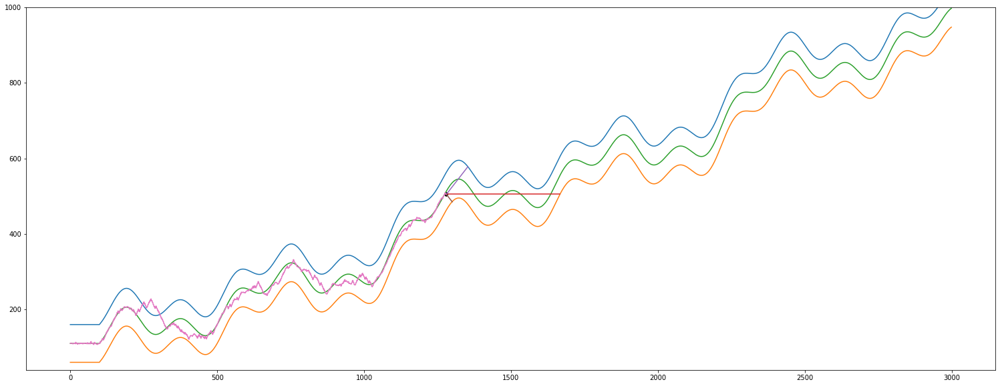

Streaming output truncated to the last 5000 lines.

------------------------------ IF i % 3 == 0 ------------------------------
=================== TAKE ACTION ===================
-------- ennyivel módosítom self.y értékét --------
self.y régi értéke =  516.0
Sensor center =  302
Sensor from left wall =  63
Sensor from right wall =  28
most távolsagra van a felső faltól =  52.38576496788619
most távolsagra van az alsó faltól =  47.614235032113754
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  1287
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  -2.385764967886189
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  -2.385764967886189
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  1288
			 len(self.sensor_left)   =  12

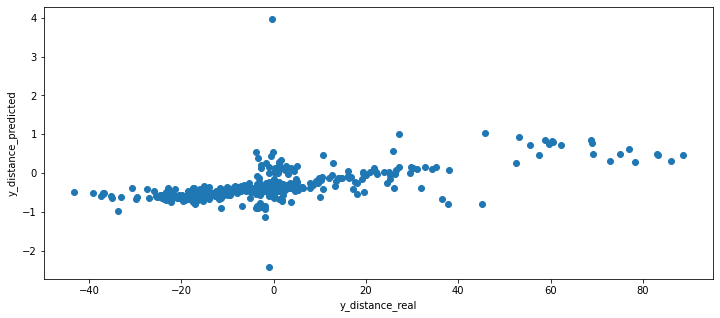

(1313, 1)
(1313, 1)


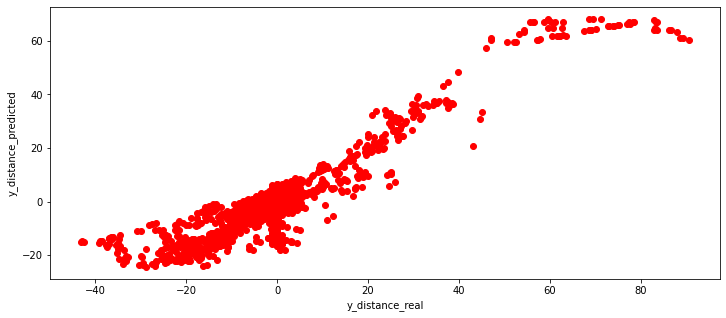

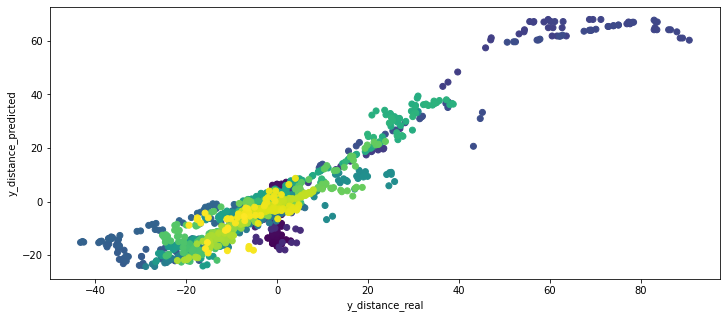

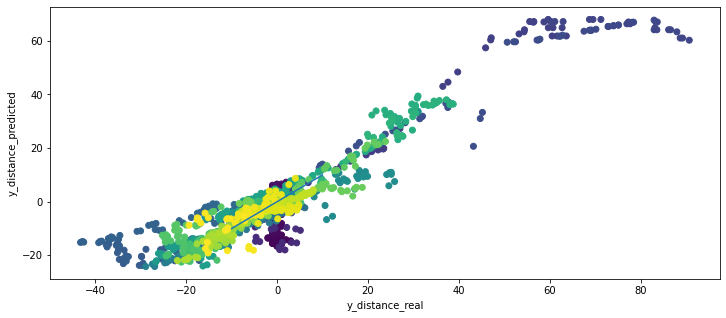

 --- plot predcition --- 


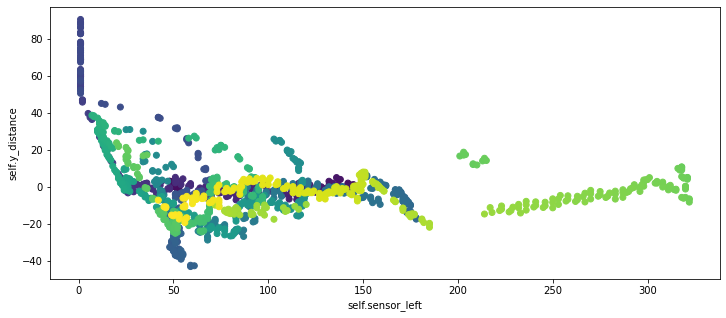

Streaming output truncated to the last 5000 lines.
		 predicted_position neural net model scaled =  [-0.32521247]
		 predicted_position neural net model inverz =  [[1.96227856]]
			 xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx
			    ez az _X úgy, hogy a régi x_minmaxscaler alapján lett -1, 1 közé szorítva
			 _X_scaled =  [[-0.84773955 -0.76296844  0.7707352 ]]
			    ez a predicted y úgy, hogy a régi y_minmaxscaler alapján lett -1, 1 közé szorítva
			 predicted_position_scaled =  [-0.32521247]
		 --------------------------------------------------------------------------------------------------------------------------------------
		 adott j-re 1 kiszámoltuk az előrejelzést de még nem hoztunk döntést -------------------------------------------------
		 --------------------------------------------------------------------------------------------------------------------------------------


		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellb

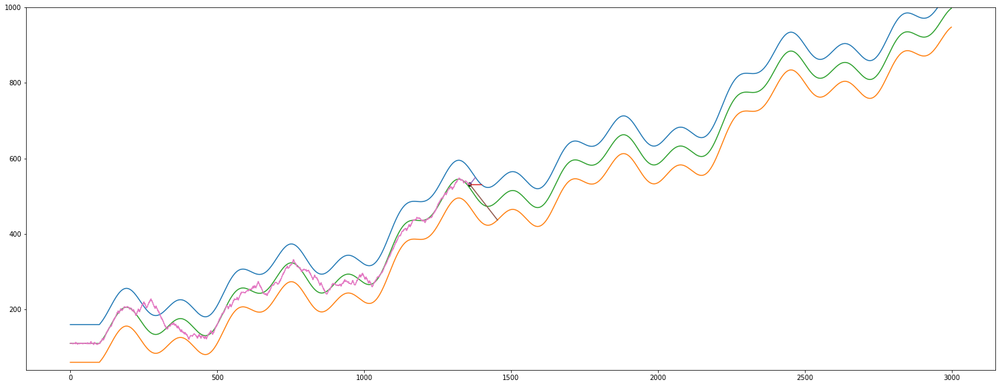

Streaming output truncated to the last 5000 lines.
		 _X_left   =  [[24  3]]
		 _X_center =  [[283   3]]
		 _X_right  =  [[69  3]]
		 predicted_left   =  [[19.61536109]]
		 predicted_center =  [[270.9015997]]
		 predicted_right  =  [[71.64136175]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.99583695 -1.42824194]]
		 regression_center.coef_ =  [[0.9501195  0.67259337]]
		 regression_right.coef_  =  [[0.99973178 0.88662302]]
		 regression_left.intercept_   =  0.0
		 regression_center.intercept_ =  0.0
		 regression_right.intercept_  =  0.0
		 # Ez lesz a bemenete a neurális hálónak
		 -------------------------X-------------------------
		  [[ 19.61536109 270.9015997   71.64136175]]
		 ---------------Brutálisan hülye dolgot jelez előre ezért ellenőrizni kell, hogy mi a gond. Esetleg a bemeneti adatok?-----------------
		 predicted_position linreg model            =  [[0.26057622]]
		 predicted_position neural

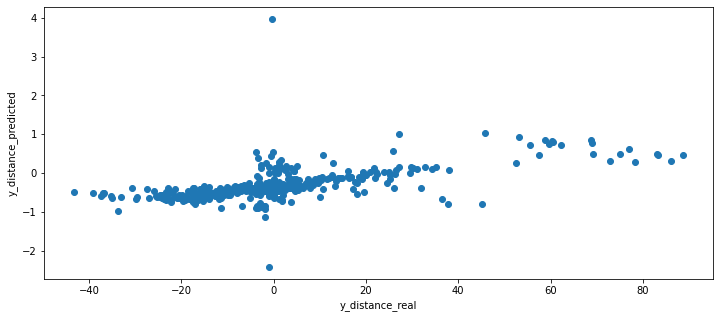

(1409, 1)
(1409, 1)


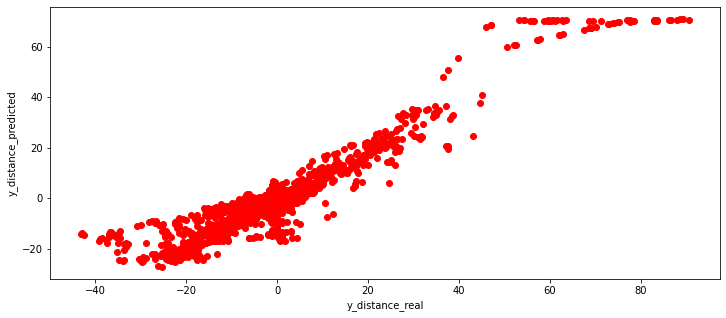

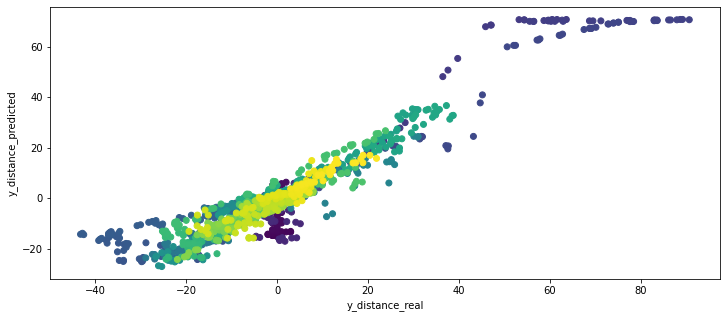

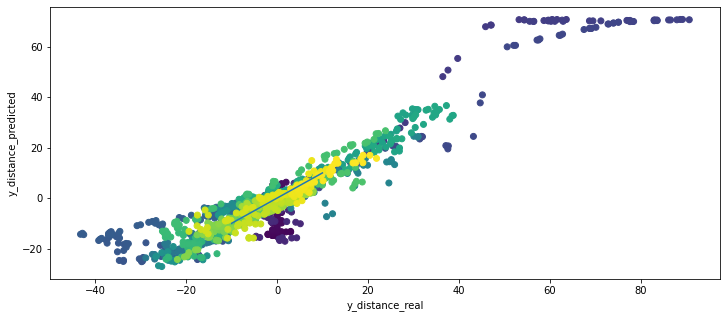

 --- plot predcition --- 


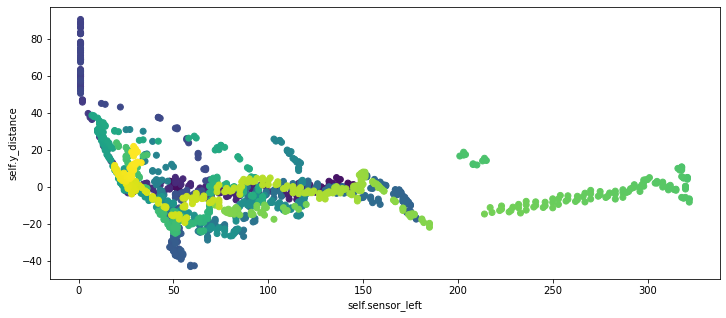

Streaming output truncated to the last 5000 lines.
		 regression_center.intercept_ =  0.0
		 regression_right.intercept_  =  0.0
		 # Ez lesz a bemenete a neurális hálónak
		 -------------------------X-------------------------
		  [[ 29.01159011 240.78965498  55.75267387]]
		 ---------------Brutálisan hülye dolgot jelez előre ezért ellenőrizni kell, hogy mi a gond. Esetleg a bemeneti adatok?-----------------
		 predicted_position linreg model            =  [[-0.3157452]]
		 predicted_position neural net model scaled =  [-0.06357749]
		 predicted_position neural net model inverz =  [[19.48630364]]
			 xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx
			    ez az _X úgy, hogy a régi x_minmaxscaler alapján lett -1, 1 közé szorítva
			 _X_scaled =  [[-0.82547296  0.20195316 -0.23908393]]
			    ez a predicted y úgy, hogy a régi y_minmaxscaler alapján lett -1, 1 közé szorítva
			 predicted_position_scaled =  [-0.06357749]
		 ---------------------------------------------------------------

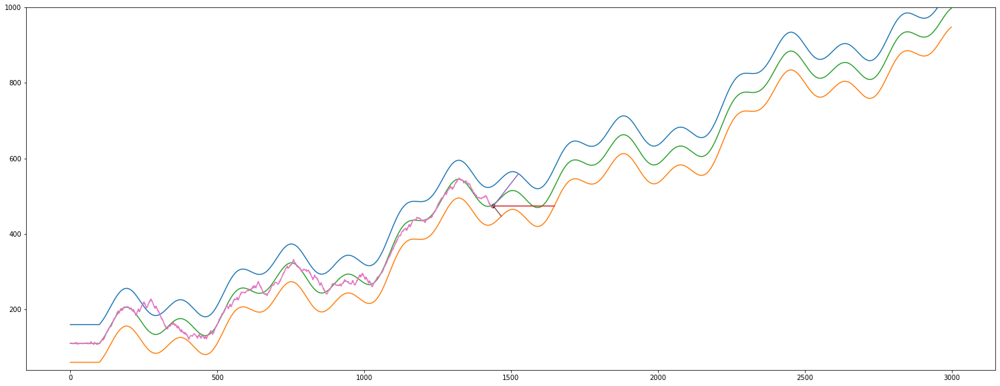

Streaming output truncated to the last 5000 lines.
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[50  5]]
		 _X_center =  [[192   5]]
		 _X_right  =  [[57  5]]
		 predicted_left   =  [[42.72479298]]
		 predicted_center =  [[187.27423962]]
		 predicted_right  =  [[61.36808936]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.99601519 -1.4151933 ]]
		 regression_center.coef_ =  [[0.95882813 0.63584786]]
		 regression_right.coef_  =  [[0.99979015 0.87601022]]
		 regression_left.intercept_   =  0.0
		 regression_center.intercept_ =  0.0
		 regression_right.intercept_  =  0.0
		 # Ez lesz a bemenete a neurális hálónak
		 -------------------------X-------------------------
		  [[ 42.72479298 187.27423962  61.36808936]]
		 ---------------Brutálisan hülye dolgot jelez előre ezért ellenőrizni kell, hogy mi a gond. Esetleg a bemeneti adatok?------------

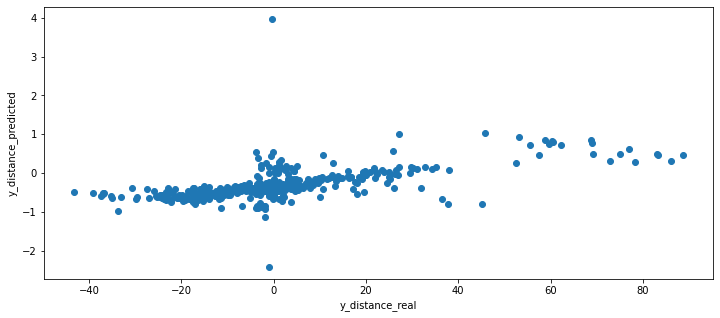

(1505, 1)
(1505, 1)


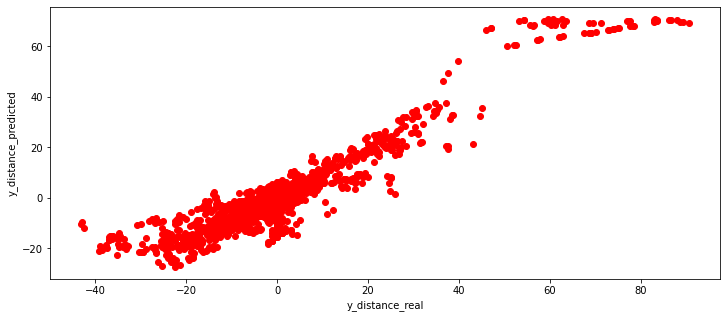

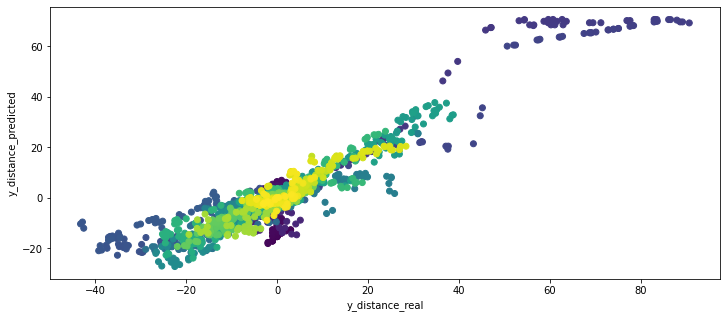

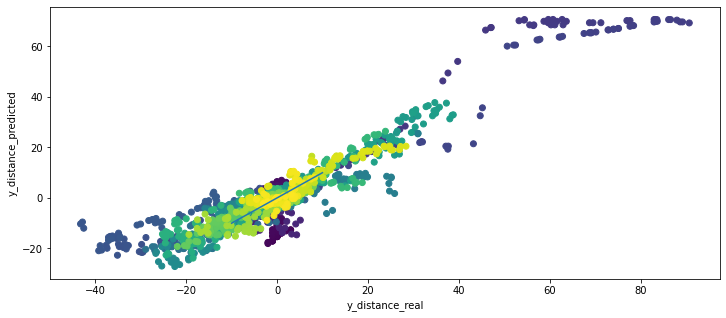

 --- plot predcition --- 


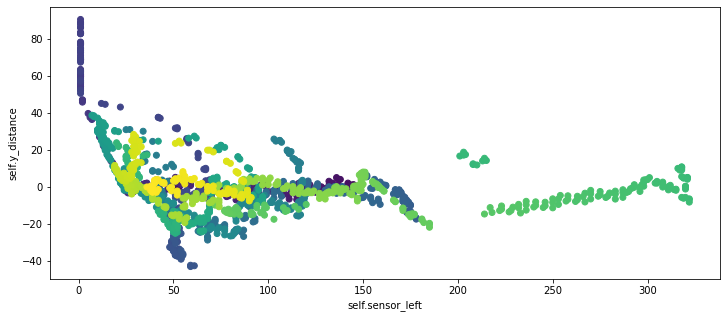

óóóóóó
1505
[51, 51, 51, 50, 50, 50, 51, 51, 51, 52, 52, 52, 51, 51, 51, 50, 51, 51, 52, 48, 48, 49, 51, 51, 50, 53, 53, 52, 51, 51, 52, 51, 51, 52, 51, 51, 50, 51, 51, 50, 51, 51, 52, 51, 51, 52, 51, 51, 50, 53, 146, 145, 145, 145, 145, 145, 145, 145, 144, 143, 142, 144, 144, 143, 142, 142, 142, 141, 141, 141, 138, 137, 136, 139, 138, 137, 138, 137, 137, 137, 137, 137, 134, 133, 132, 134, 133, 132, 133, 132, 132, 132, 131, 131, 130, 129, 128, 128, 128, 127, 126, 125, 125, 122, 122, 122, 120, 120, 119, 116, 115, 114, 115, 115, 115, 112, 111, 111, 108, 108, 107, 104, 103, 102, 99, 99, 99, 96, 95, 95, 92, 92, 91, 89, 88, 87, 86, 85, 85, 83, 83, 83, 80, 79, 78, 75, 75, 74, 71, 70, 70, 67, 67, 67, 64, 64, 63, 59, 59, 58, 55, 54, 54, 51, 51, 51, 53, 53, 52, 48, 48, 47, 44, 43, 43, 45, 44, 44, 43, 42, 41, 39, 39, 38, 36, 35, 35, 34, 34, 34, 34, 33, 32, 31, 31, 30, 30, 29, 29, 29, 28, 28, 29, 29, 28, 27, 26, 25, 25, 25, 25, 27, 26, 26, 24, 23, 22, 24, 24, 23, 25, 24, 24, 26, 25, 25, 22, 22, 2

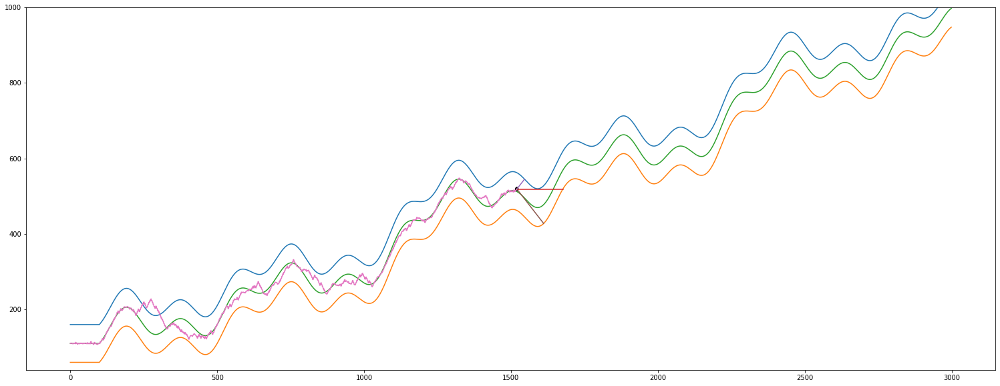

Streaming output truncated to the last 5000 lines.
			 _X_scaled =  [[ 0.01657512 -0.64880018 -0.4318789 ]]
			    ez a predicted y úgy, hogy a régi y_minmaxscaler alapján lett -1, 1 közé szorítva
			 predicted_position_scaled =  [-0.33822214]
		 --------------------------------------------------------------------------------------------------------------------------------------
		 adott j-re 3 kiszámoltuk az előrejelzést de még nem hoztunk döntést -------------------------------------------------
		 --------------------------------------------------------------------------------------------------------------------------------------


		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  4
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[169   4]]
		 _X_center =  [[72  4]]
		 _X_right  =  [[42  4]]
		 predicted_left   =  [[162.78486441]]
		 predicted_center =  [[71.6764569

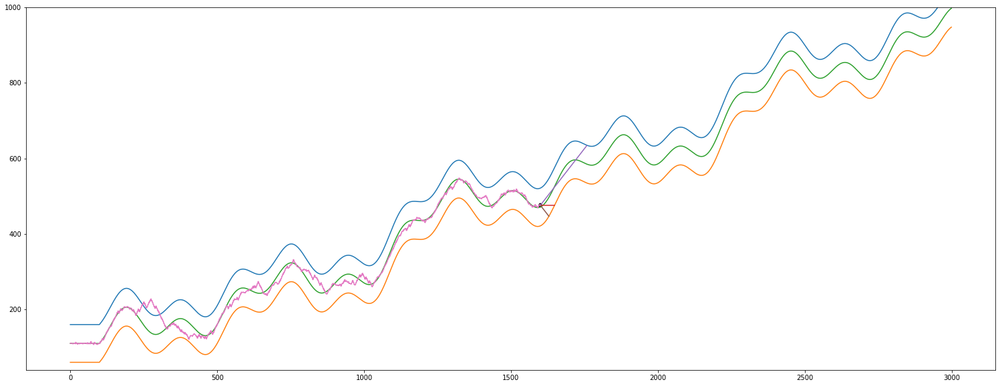

 --- plot --- 
------------------------------ IF i % 3 == 1 ------------------------------
# i =  1600
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[159  49  30]]
actual predicted =  [-0.34875565]
actual self.y_distance[-1] =  4.502941203340583
len(self.y_distance_real)      =  527
len(self.y_distance_predicted) =  527


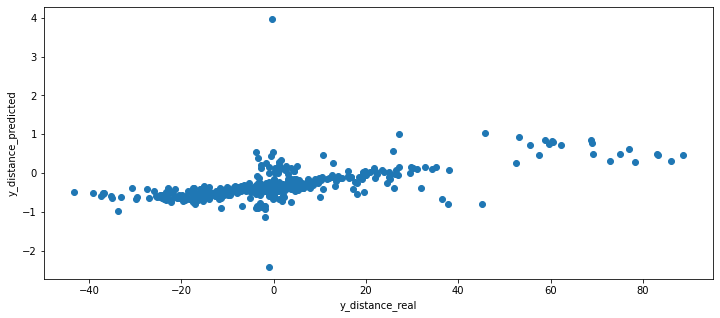

(1601, 1)
(1601, 1)


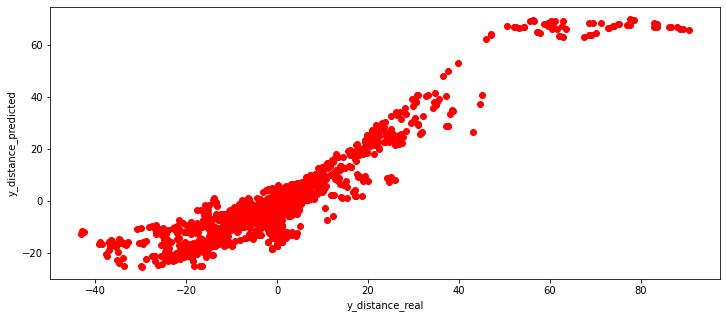

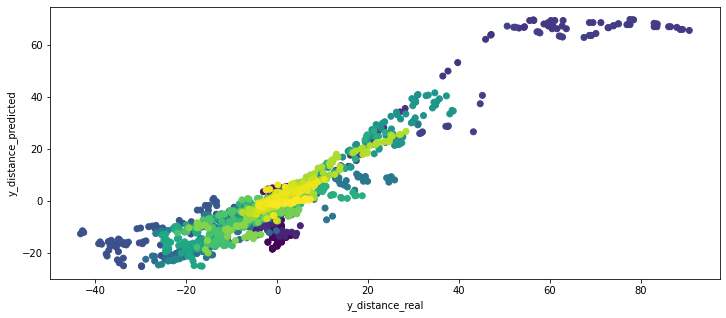

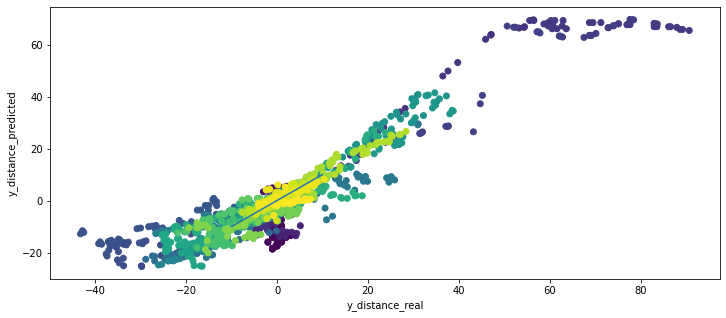

 --- plot predcition --- 


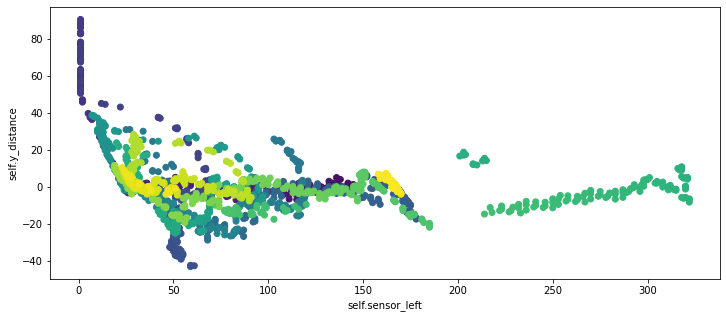

Streaming output truncated to the last 5000 lines.
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  0
# 			 _summary_mesterseges_mozgatas      =  1
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------
Sensor center =  33
Sensor from left wall =  104
Sensor from right wall =  18
most távolsagra van a felső faltól =  57.3676078855658
most távolsagra van az alsó faltól =  42.63239211443414
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  1656
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  

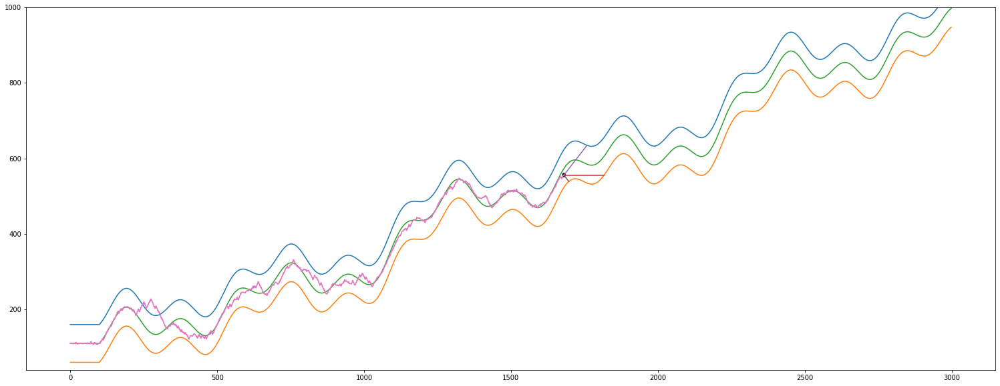

 --- plot --- 
------------------------------ IF i % 3 == 0 ------------------------------
# i =  1680
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (1681, 3)
y.shape =  (1681, 1)
i       =  1680
---------------------
X.max =  400
X.min =  1
y.max =  90.72356321549958
y.min =  -43.23425365063727
---------------------
X_scaled.max =  1.0
X_scaled.min =  -1.0
y_scaled.max =  1.0
y_scaled.min =  -1.0
---------------------
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  1680
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
# Linear Regression Learning --------------------------------------------------------------------------------------
		 # Linear Regression Training Results -------------------------------------------------------------------------
		 ------------------------------- val

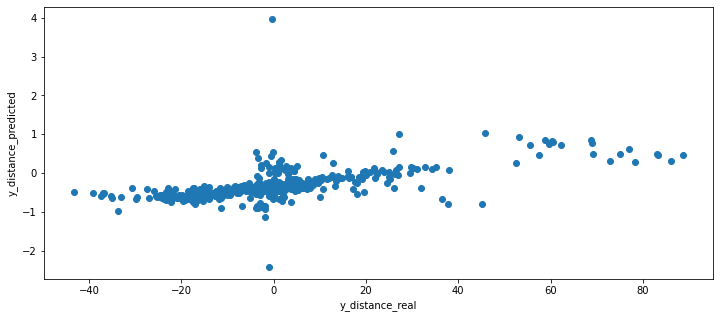

(1697, 1)
(1697, 1)


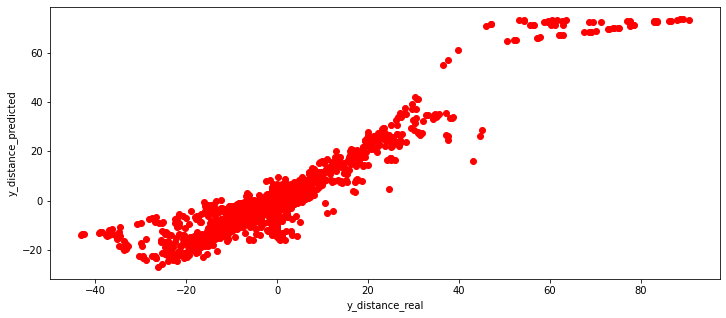

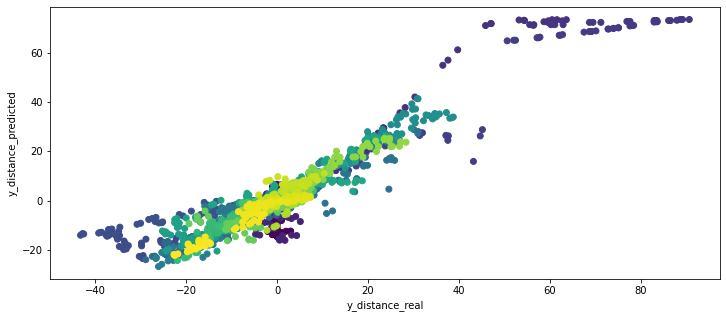

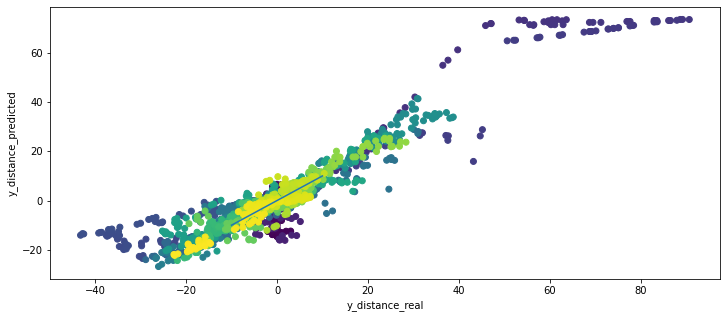

 --- plot predcition --- 


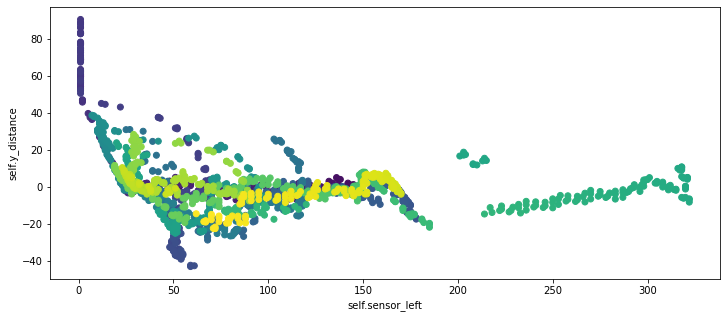

Streaming output truncated to the last 5000 lines.
			    ez az _X úgy, hogy a régi x_minmaxscaler alapján lett -1, 1 közé szorítva
			 _X_scaled =  [[-0.15726795 -0.5227382  -0.47177431]]
			    ez a predicted y úgy, hogy a régi y_minmaxscaler alapján lett -1, 1 közé szorítva
			 predicted_position_scaled =  [-0.43342262]
		 --------------------------------------------------------------------------------------------------------------------------------------
		 ---------------------
		  action =  5
		  predicted_position =  [[-5.28551902]]
		  distance from 0 (tmp)=  [[5.28551902]]
		 ---------------------
		 adott j-re 5 kiszámoltuk az előrejelzést de még nem hoztunk döntést -------------------------------------------------
		 --------------------------------------------------------------------------------------------------------------------------------------
	 minden j-re kiszámoltuk az előrejelzést de még nem hoztunk döntést -------------------------------------------------

-------

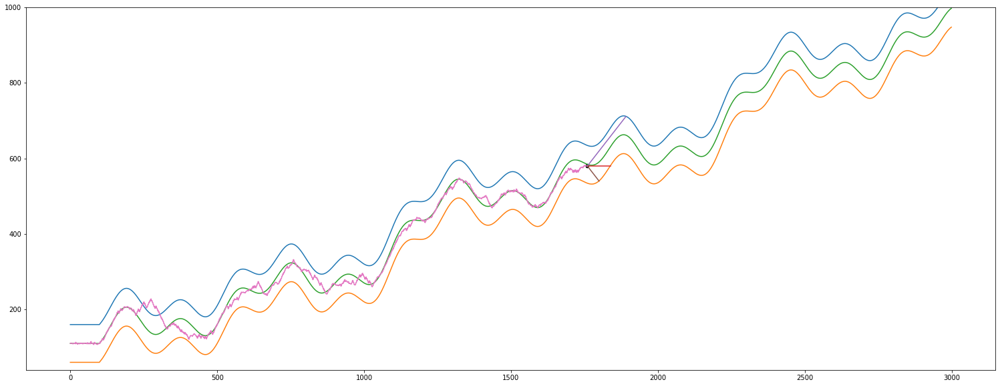

Streaming output truncated to the last 5000 lines.
			 _X_scaled =  [[-0.22465535 -0.65185127 -0.52180617]]
			    ez a predicted y úgy, hogy a régi y_minmaxscaler alapján lett -1, 1 közé szorítva
			 predicted_position_scaled =  [-0.26003401]
		 --------------------------------------------------------------------------------------------------------------------------------------
		 adott j-re 4 kiszámoltuk az előrejelzést de még nem hoztunk döntést -------------------------------------------------
		 --------------------------------------------------------------------------------------------------------------------------------------


		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  5
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[132   5]]
		 _X_center =  [[70  5]]
		 _X_right  =  [[36  5]]
		 predicted_left   =  [[123.96551954]]
		 predicted_center =  [[71.2185146

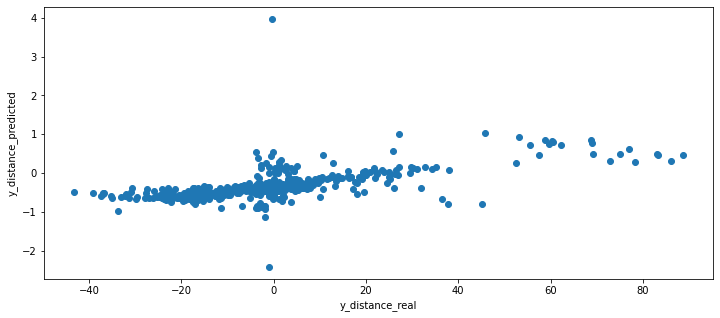

(1793, 1)
(1793, 1)


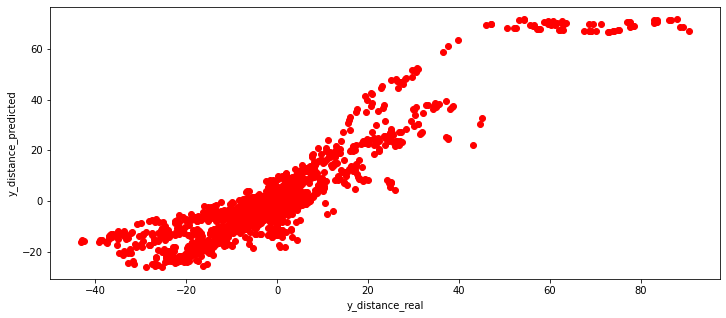

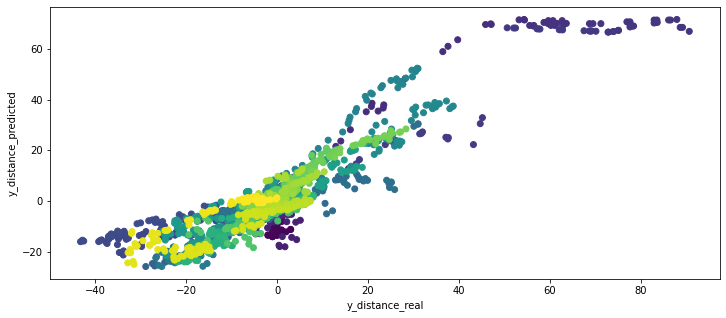

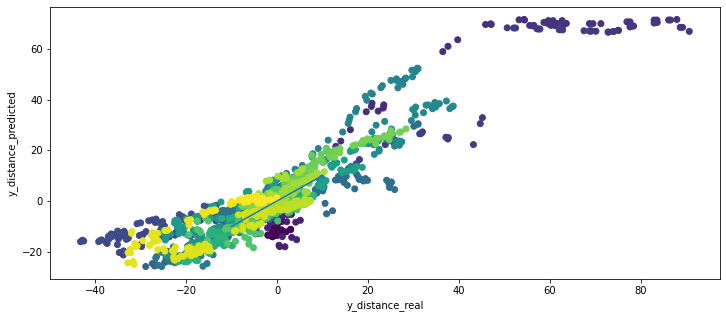

 --- plot predcition --- 


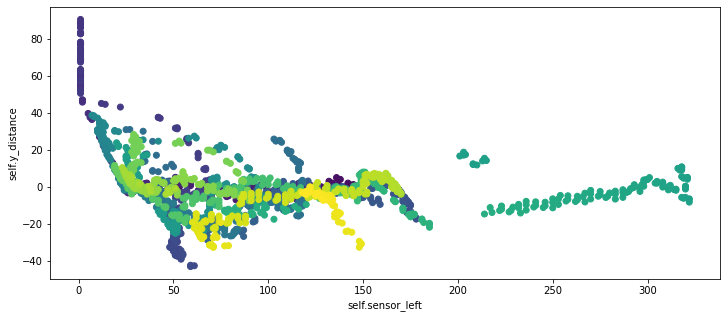

Streaming output truncated to the last 5000 lines.
			 ---------------- Append ----------------
			 len(self.y_distance)    =  1817
			 len(self.sensor_left)   =  1817
			 len(self.sensor_center) =  1817
			 len(self.sensor_right)  =  1817
			 self.x                  =  1816
			 -------------- Append End --------------
------------------------------ IF i % 3 == 1 ------------------------------
# i =  1816
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[95 50 25]]
actual predicted =  [-0.41870789]
actual self.y_distance[-1] =  1.1097815823887913
len(self.y_distance_real)      =  599
len(self.y_distance_predicted) =  599
# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
606.0
# 		 ----------------- Summary 

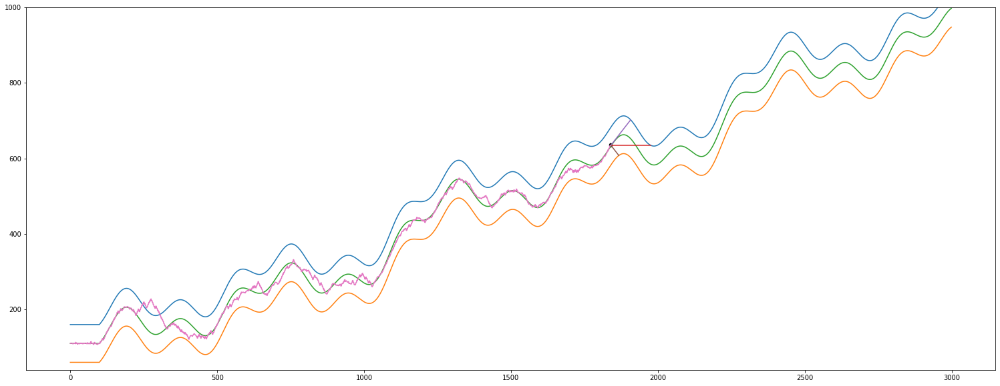

Streaming output truncated to the last 5000 lines.
		 --------------------------------------------------------------------------------------------------------------------------------------
		 ---------------------
		  action =  3
		  predicted_position =  [[0.46049261]]
		  distance from 0 (tmp)=  [[0.46049261]]
		 ---------------------
		 adott j-re 3 kiszámoltuk az előrejelzést de még nem hoztunk döntést -------------------------------------------------
		 --------------------------------------------------------------------------------------------------------------------------------------


		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  4
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[45  4]]
		 _X_center =  [[85  4]]
		 _X_right  =  [[126   4]]
		 predicted_left   =  [[39.04357568]]
		 predicted_center =  [[84.95947399]]
		 predicted_right  =  [[129.6818135]]
	

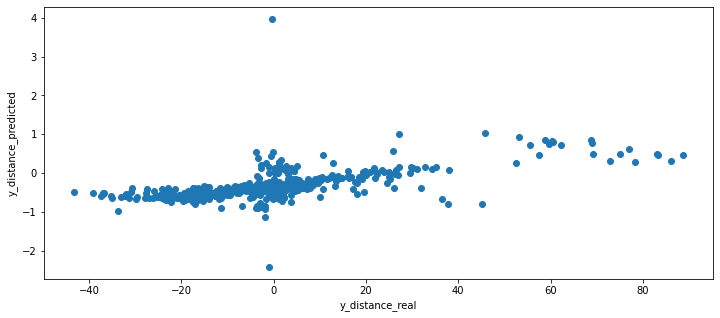

(1889, 1)
(1889, 1)


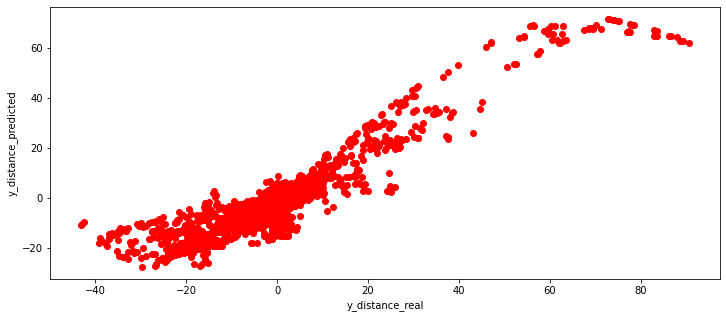

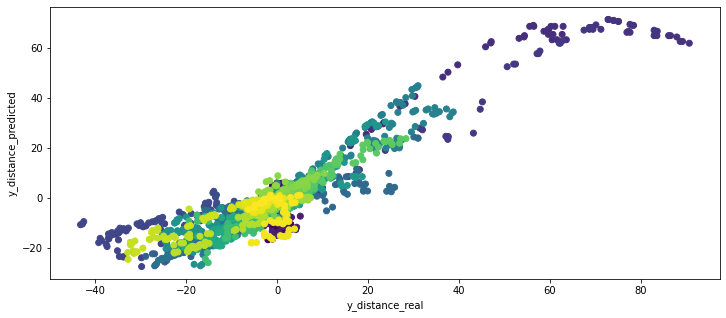

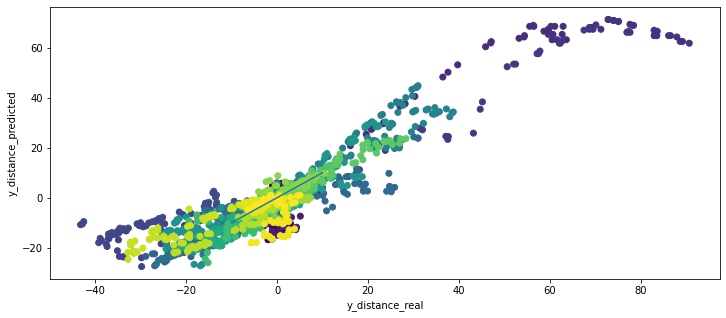

 --- plot predcition --- 


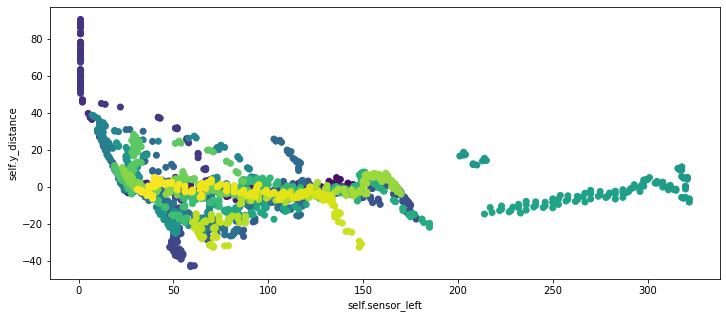

Streaming output truncated to the last 5000 lines.


		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  4
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[32  4]]
		 _X_center =  [[58  4]]
		 _X_right  =  [[116   4]]
		 predicted_left   =  [[26.1389683]]
		 predicted_center =  [[58.93387554]]
		 predicted_right  =  [[119.66914757]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.99544375 -1.42880789]]
		 regression_center.coef_ =  [[0.96196684 0.78494974]]
		 regression_right.coef_  =  [[1.00070815 0.89675044]]
		 regression_left.intercept_   =  0.0
		 regression_center.intercept_ =  0.0
		 regression_right.intercept_  =  0.0
		 # Ez lesz a bemenete a neurális hálónak
		 -------------------------X-------------------------
		  [[ 26.1389683   58.93387554 119.66914757]]
		 ---------------Brutális

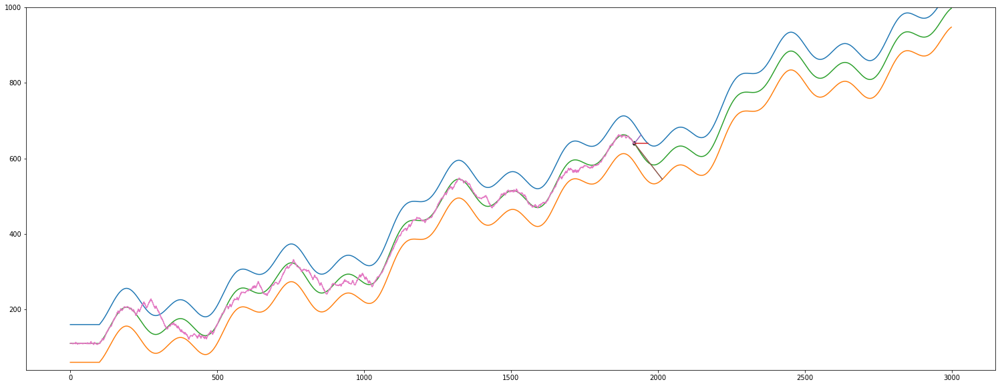

Streaming output truncated to the last 5000 lines.
			 _X_scaled =  [[-0.83007665  0.16599537 -0.20046611]]
			    ez a predicted y úgy, hogy a régi y_minmaxscaler alapján lett -1, 1 közé szorítva
			 predicted_position_scaled =  [-0.10195145]
		 --------------------------------------------------------------------------------------------------------------------------------------
		 adott j-re -1 kiszámoltuk az előrejelzést de még nem hoztunk döntést -------------------------------------------------
		 --------------------------------------------------------------------------------------------------------------------------------------


		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  0
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[27  0]]
		 _X_center =  [[243   0]]
		 _X_right  =  [[60  0]]
		 predicted_left   =  [[26.87122409]]
		 predicted_center =  [[234.001400

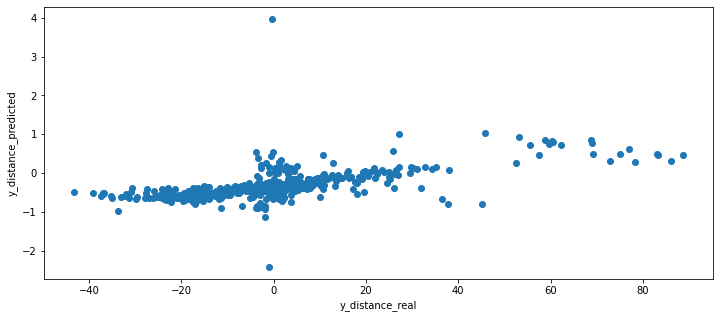

(1985, 1)
(1985, 1)


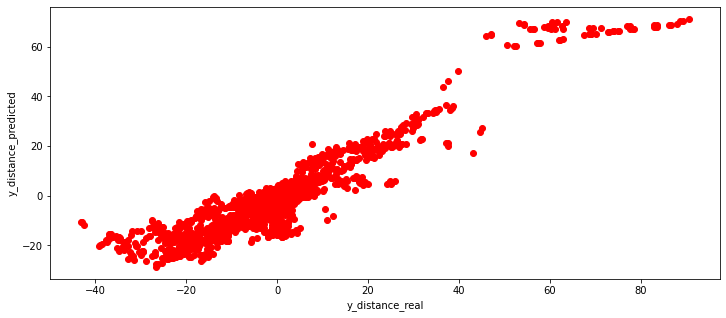

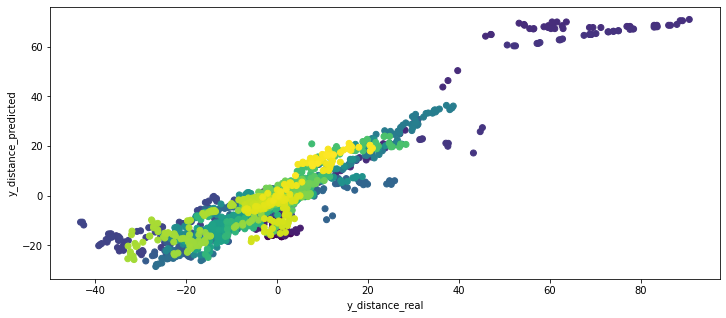

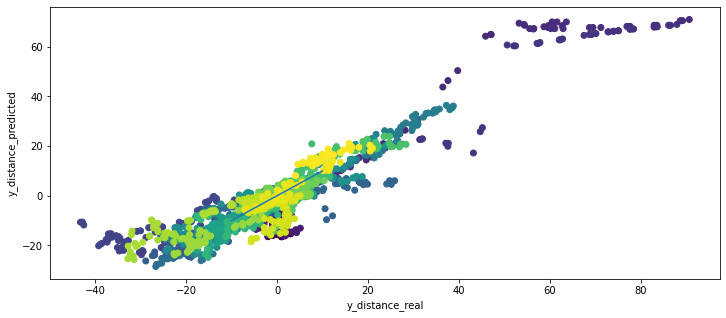

 --- plot predcition --- 


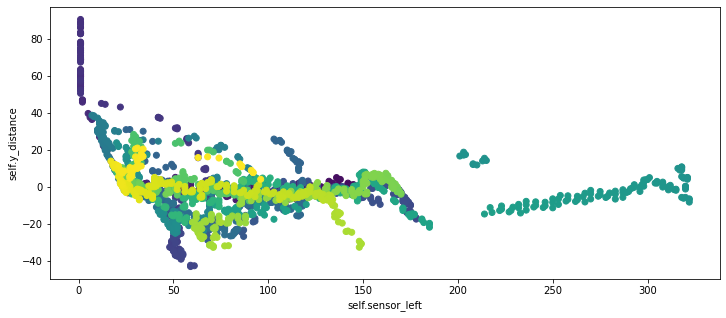

óóóóóó
1985
[51, 51, 51, 50, 50, 50, 51, 51, 51, 52, 52, 52, 51, 51, 51, 50, 51, 51, 52, 48, 48, 49, 51, 51, 50, 53, 53, 52, 51, 51, 52, 51, 51, 52, 51, 51, 50, 51, 51, 50, 51, 51, 52, 51, 51, 52, 51, 51, 50, 53, 146, 145, 145, 145, 145, 145, 145, 145, 144, 143, 142, 144, 144, 143, 142, 142, 142, 141, 141, 141, 138, 137, 136, 139, 138, 137, 138, 137, 137, 137, 137, 137, 134, 133, 132, 134, 133, 132, 133, 132, 132, 132, 131, 131, 130, 129, 128, 128, 128, 127, 126, 125, 125, 122, 122, 122, 120, 120, 119, 116, 115, 114, 115, 115, 115, 112, 111, 111, 108, 108, 107, 104, 103, 102, 99, 99, 99, 96, 95, 95, 92, 92, 91, 89, 88, 87, 86, 85, 85, 83, 83, 83, 80, 79, 78, 75, 75, 74, 71, 70, 70, 67, 67, 67, 64, 64, 63, 59, 59, 58, 55, 54, 54, 51, 51, 51, 53, 53, 52, 48, 48, 47, 44, 43, 43, 45, 44, 44, 43, 42, 41, 39, 39, 38, 36, 35, 35, 34, 34, 34, 34, 33, 32, 31, 31, 30, 30, 29, 29, 29, 28, 28, 29, 29, 28, 27, 26, 25, 25, 25, 25, 27, 26, 26, 24, 23, 22, 24, 24, 23, 25, 24, 24, 26, 25, 25, 22, 22, 2

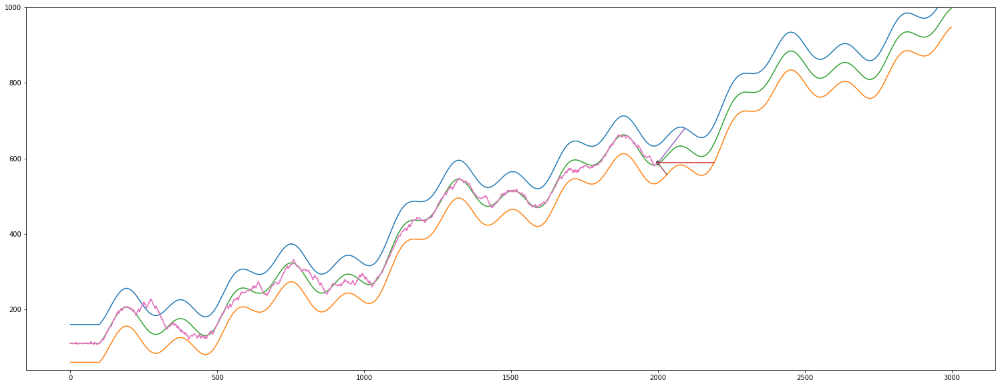

Streaming output truncated to the last 5000 lines.
			 _X_scaled =  [[-0.67261982 -0.2673552  -0.6157407 ]]
			    ez a predicted y úgy, hogy a régi y_minmaxscaler alapján lett -1, 1 közé szorítva
			 predicted_position_scaled =  [-0.60150028]
		 --------------------------------------------------------------------------------------------------------------------------------------
		 adott j-re 3 kiszámoltuk az előrejelzést de még nem hoztunk döntést -------------------------------------------------
		 --------------------------------------------------------------------------------------------------------------------------------------


		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  4
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[58  4]]
		 _X_center =  [[151   4]]
		 _X_right  =  [[32  4]]
		 predicted_left   =  [[52.14621443]]
		 predicted_center =  [[147.6223247

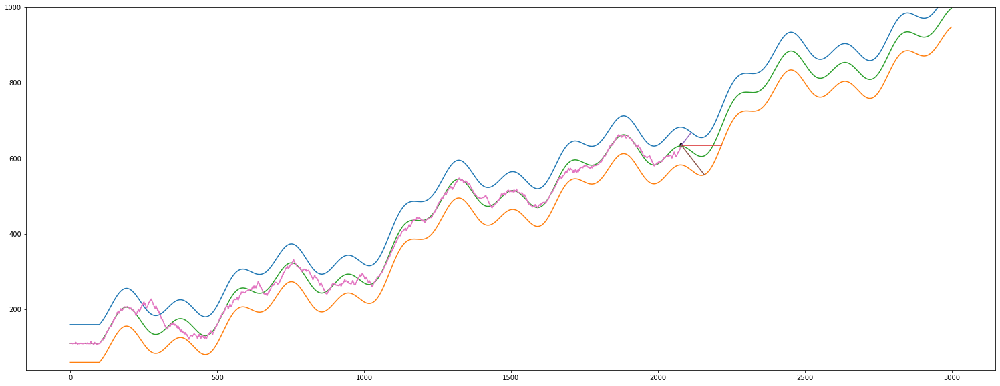

 --- plot --- 
------------------------------ IF i % 3 == 1 ------------------------------
# i =  2080
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 34 138  79]]
actual predicted =  [-0.52858682]
actual self.y_distance[-1] =  2.134114126079794
len(self.y_distance_real)      =  687
len(self.y_distance_predicted) =  687


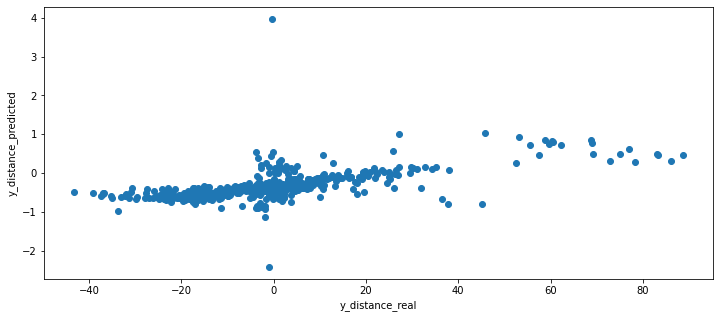

(2081, 1)
(2081, 1)


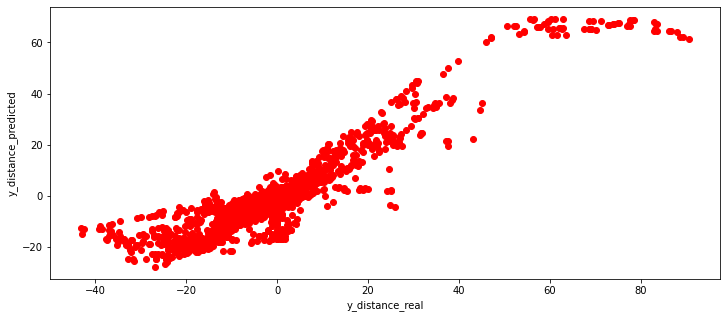

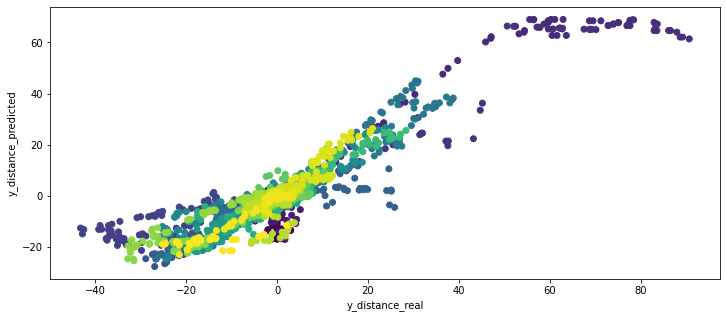

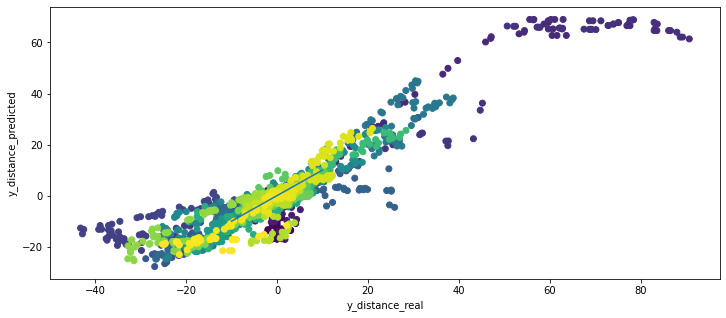

 --- plot predcition --- 


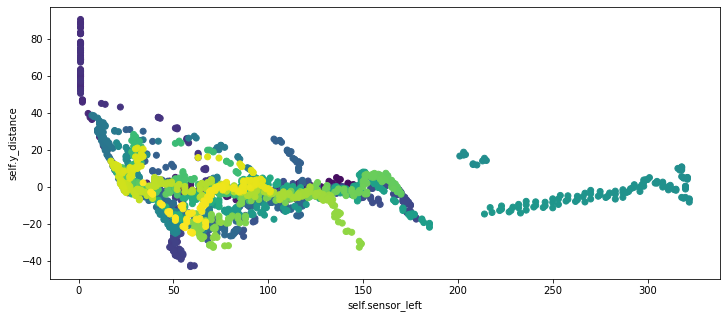

Streaming output truncated to the last 5000 lines.
			 len(self.sensor_center) =  2134
			 len(self.sensor_right)  =  2134
			 self.x                  =  2134
			 -------------- Teszt End --------------
			 ---------------- Append ----------------
			 len(self.y_distance)    =  2135
			 len(self.sensor_left)   =  2135
			 len(self.sensor_center) =  2135
			 len(self.sensor_right)  =  2135
			 self.x                  =  2134
			 -------------- Append End --------------
------------------------------ IF i % 3 == 1 ------------------------------
# i =  2134
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[332  65  37]]
actual predicted =  [-0.37515758]
actual self.y_distance[-1] =  -8.200328698816065
len(self.y_distance_real)      =  705
len(self.y_distance_predicted) =  705
# A run ciklus vége -------------------------------------------------------------------------------------

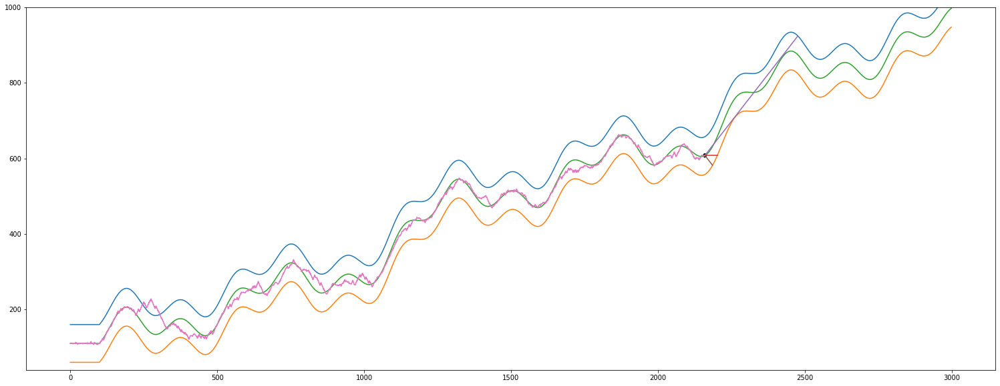

 --- plot --- 
------------------------------ IF i % 3 == 0 ------------------------------
# i =  2160
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (2161, 3)
y.shape =  (2161, 1)
i       =  2160
---------------------
X.max =  400
X.min =  1
y.max =  90.72356321549958
y.min =  -43.23425365063727
---------------------
X_scaled.max =  1.0
X_scaled.min =  -0.9999999999999999
y_scaled.max =  1.0
y_scaled.min =  -1.0
---------------------
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  2160
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
# Linear Regression Learning --------------------------------------------------------------------------------------
		 # Linear Regression Training Results -------------------------------------------------------------------------
		 --------------------

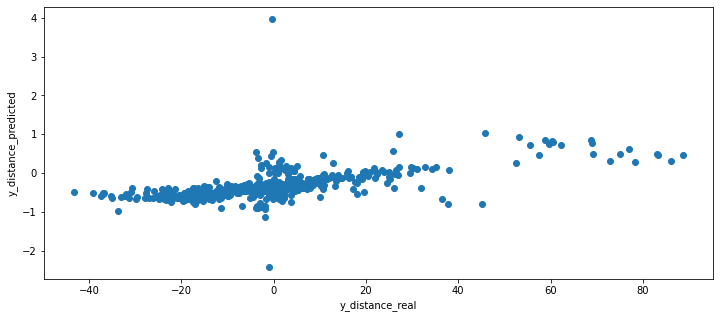

(2177, 1)
(2177, 1)


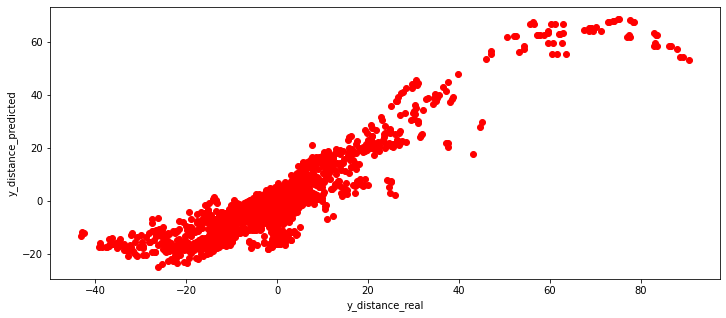

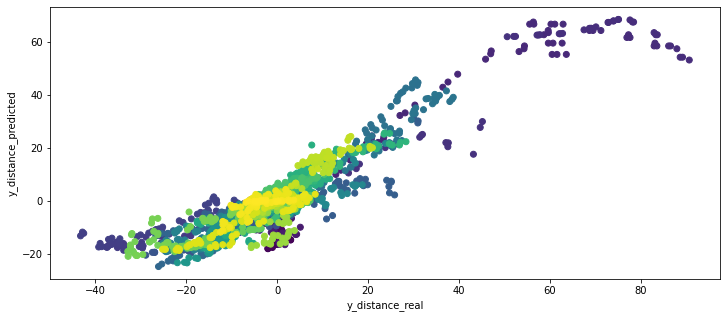

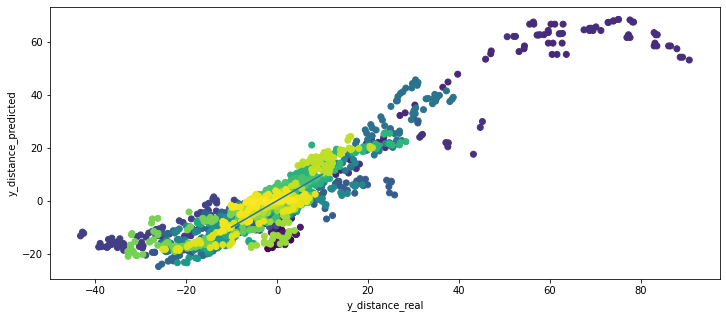

 --- plot predcition --- 


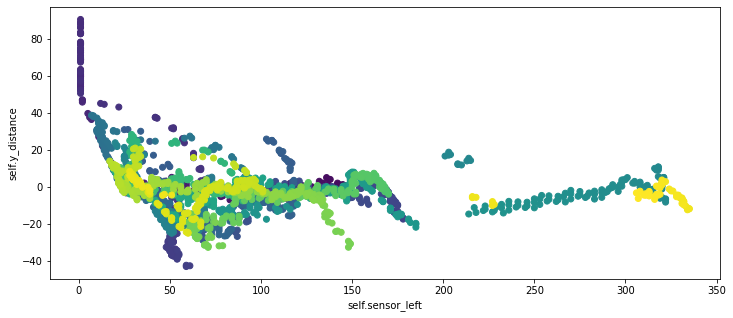

Streaming output truncated to the last 5000 lines.
			 len(self.y_distance)    =  2217
			 len(self.sensor_left)   =  2217
			 len(self.sensor_center) =  2217
			 len(self.sensor_right)  =  2217
			 self.x                  =  2217
			 -------------- Teszt End --------------
			 ---------------- Append ----------------
			 len(self.y_distance)    =  2218
			 len(self.sensor_left)   =  2218
			 len(self.sensor_center) =  2218
			 len(self.sensor_right)  =  2218
			 self.x                  =  2217
			 -------------- Append End --------------
------------------------------ IF i % 3 == 0 ------------------------------
# i =  2217
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (2218, 3)
y.shape =  (2218, 1)
i       =  2217
---------------------
X.max =  400
X.min =  1
y.max =  90.72356321549958
y.min =  -43.23425365063727
---------------------
X_scaled.max =  1.0
X_scaled.min =  -0.9999999999999999
y_scal

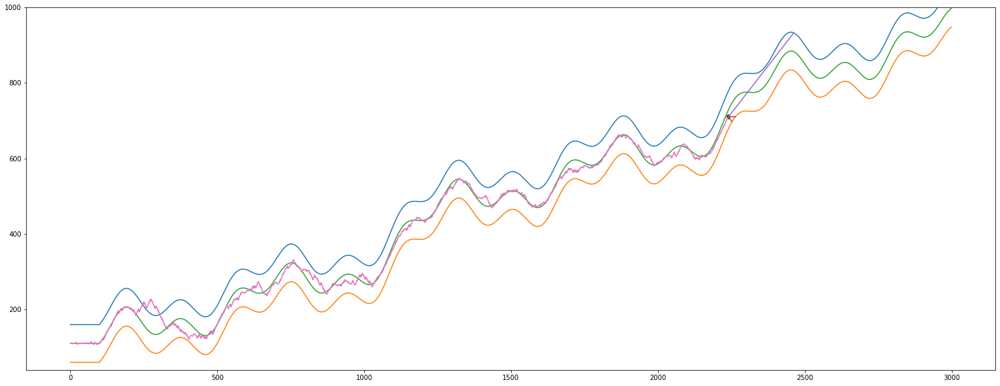

Streaming output truncated to the last 5000 lines.
			 len(self.sensor_center) =  2248
			 len(self.sensor_right)  =  2248
			 self.x                  =  2247
			 -------------- Teszt End --------------
self.y új értéke   =  726.0
action             =  5
----------------- módosítás vége -----------------
# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
726.0
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  1
# 			 _summary_mlp_prediction_was_taken  =  0
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  1
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus eleje ----------------------------------------------------

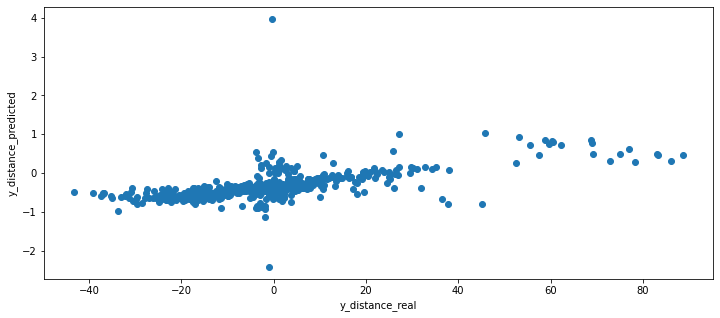

(2273, 1)
(2273, 1)


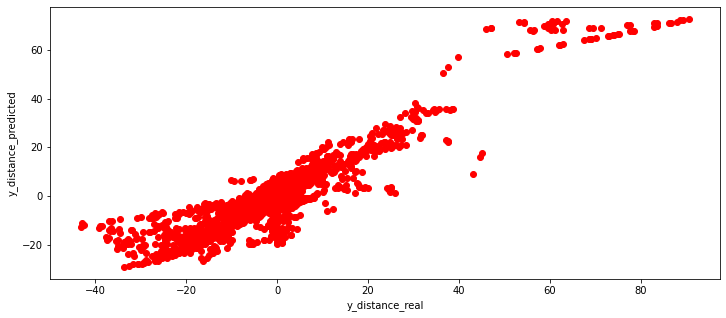

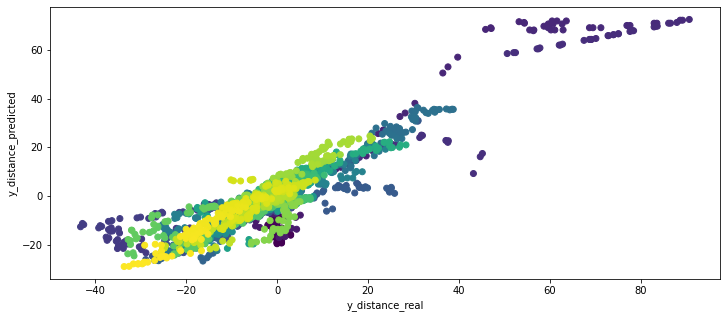

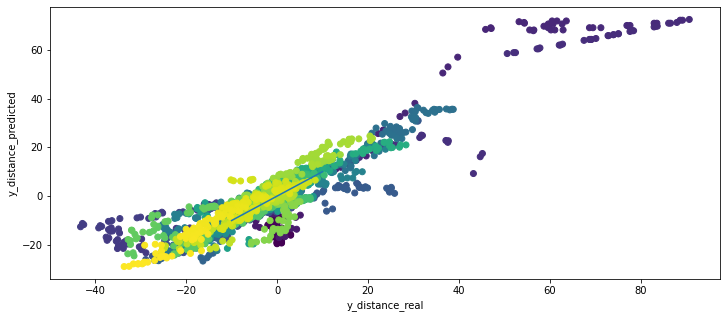

 --- plot predcition --- 


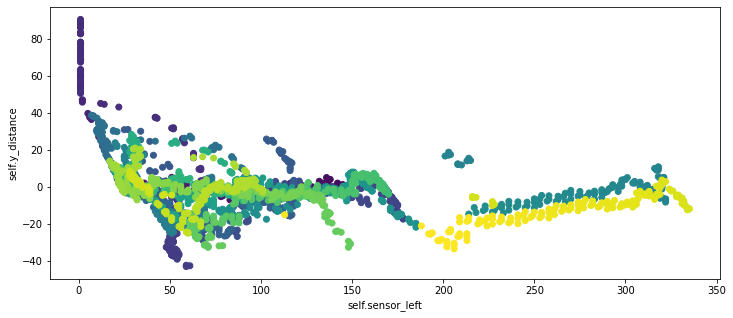

A streamkimeneten csak az utolsó 5000 sor látható.
			 predicted_position_scaled =  [-0.47296936]
		 --------------------------------------------------------------------------------------------------------------------------------------
		 ---------------------
		  action =  4
		  predicted_position =  [[-7.93431649]]
		  distance from 0 (tmp)=  [[7.93431649]]
		 ---------------------
		 adott j-re 4 kiszámoltuk az előrejelzést de még nem hoztunk döntést -------------------------------------------------
		 --------------------------------------------------------------------------------------------------------------------------------------


		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  5
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[169   5]]
		 _X_center =  [[90  5]]
		 _X_right  =  [[40  5]]
		 predicted_left   =  [[161.64809691]]
		 predicted_center =  [[89.80

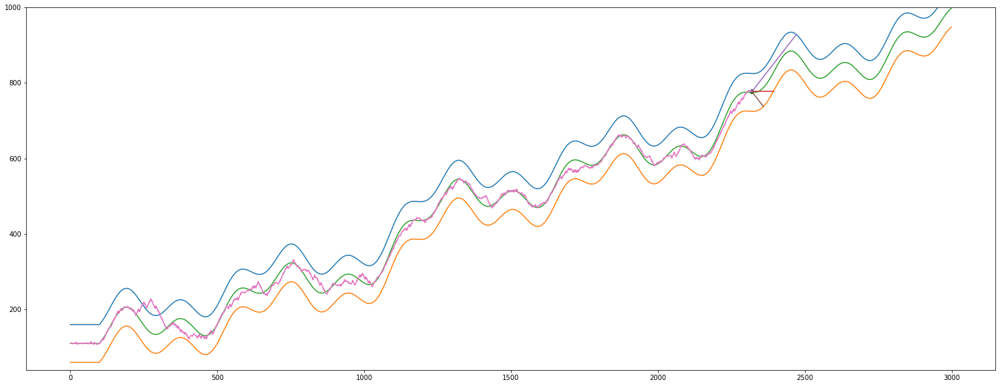

A streamkimeneten csak az utolsó 5000 sor látható.
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  -3.996808072527756
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  2344
			 len(self.sensor_left)   =  2344
			 len(self.sensor_center) =  2344
			 len(self.sensor_right)  =  2344
			 self.x                  =  2343
			 -------------- Teszt End --------------
self.y új értéke   =  774.0
action             =  -2
----------------- módosítás vége -----------------
# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
774.0
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  1
# 			 _summary_mlp_prediction_was_taken  =  0
# 			 _summary_mesterseges_mozgatas      =  0
# 

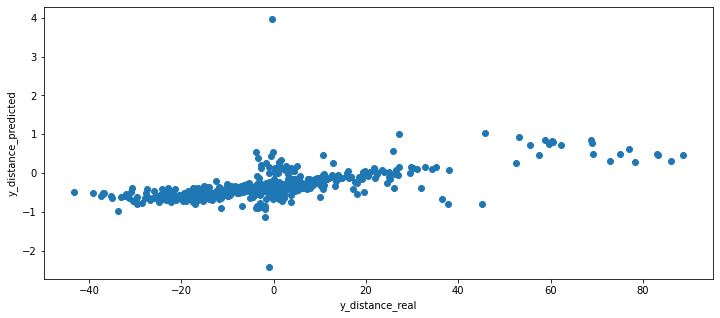

(2369, 1)
(2369, 1)


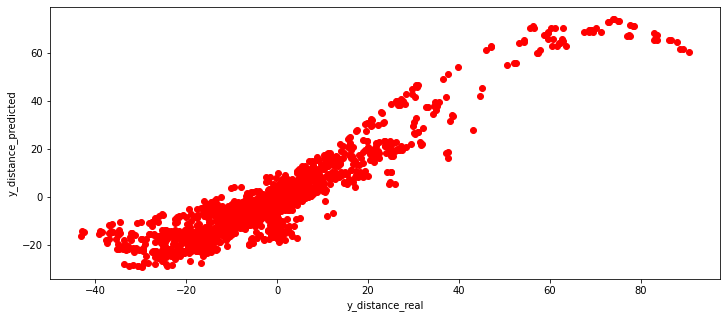

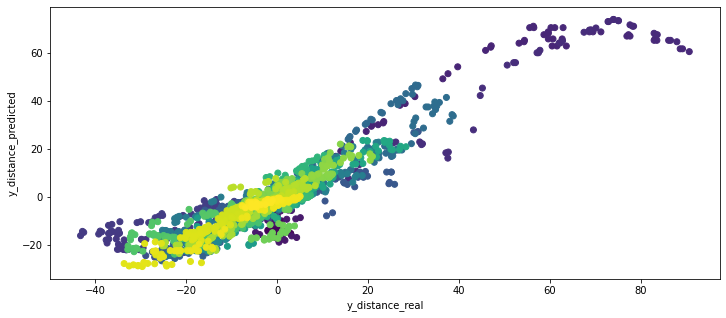

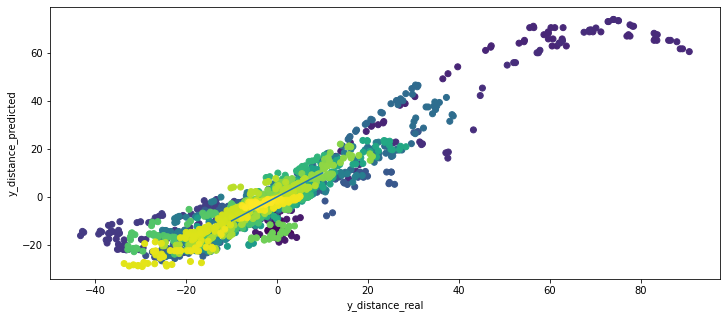

 --- plot predcition --- 


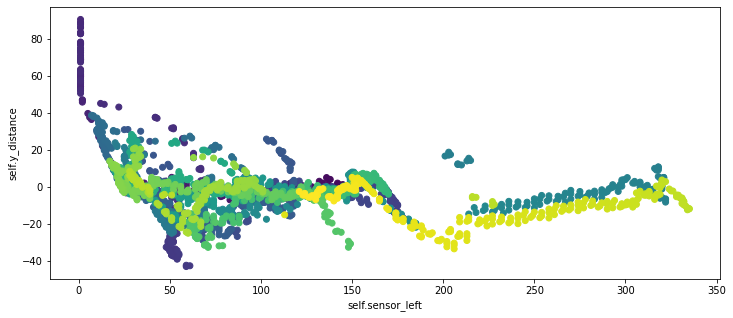

A streamkimeneten csak az utolsó 5000 sor látható.
self.vertical_distance_from_middle =  -2.5800717765455374
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  -2.5800717765455374
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  2376
			 len(self.sensor_left)   =  2376
			 len(self.sensor_center) =  2376
			 len(self.sensor_right)  =  2376
			 self.x                  =  2376
			 -------------- Teszt End --------------
			 ---------------- Append ----------------
			 len(self.y_distance)    =  2377
			 len(self.sensor_left)   =  2377
			 len(self.sensor_center) =  2377
			 len(self.sensor_right)  =  2377
			 self.x                  =  2376
			 -------------- Append End --------------
------------------------------ IF i % 3 == 0 ------------------------------
# i =  2376
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (m

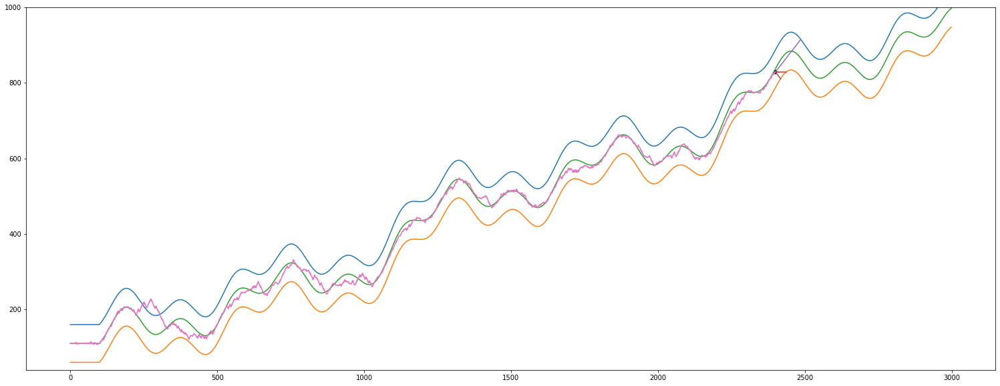

A streamkimeneten csak az utolsó 5000 sor látható.
		 _X_right  =  [[116   4]]
		 predicted_left   =  [[37.37744641]]
		 predicted_center =  [[83.19457002]]
		 predicted_right  =  [[119.63018872]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.99931215 -1.39824402]]
		 regression_center.coef_ =  [[0.9659938  0.51277261]]
		 regression_right.coef_  =  [[1.00133714 0.86877005]]
		 regression_left.intercept_   =  0.0
		 regression_center.intercept_ =  0.0
		 regression_right.intercept_  =  0.0
		 # Ez lesz a bemenete a neurális hálónak
		 -------------------------X-------------------------
		  [[ 37.37744641  83.19457002 119.63018872]]
		 ---------------Brutálisan hülye dolgot jelez előre ezért ellenőrizni kell, hogy mi a gond. Esetleg a bemeneti adatok?-----------------
		 predicted_position linreg model            =  [[11.86015133]]
		 predicted_position neural net model scaled =  [-0.41371842]
		 predicted_po

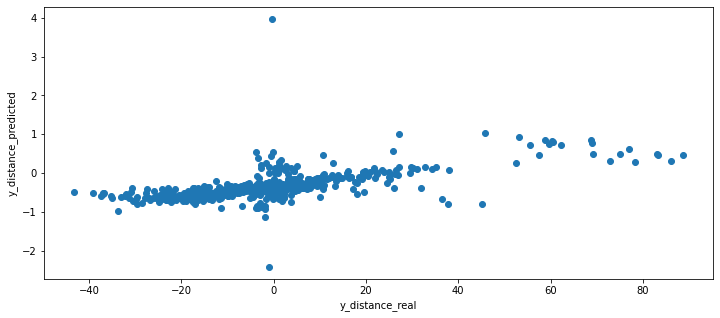

(2465, 1)
(2465, 1)


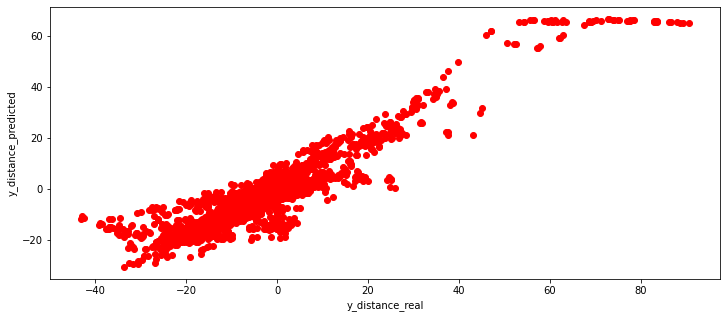

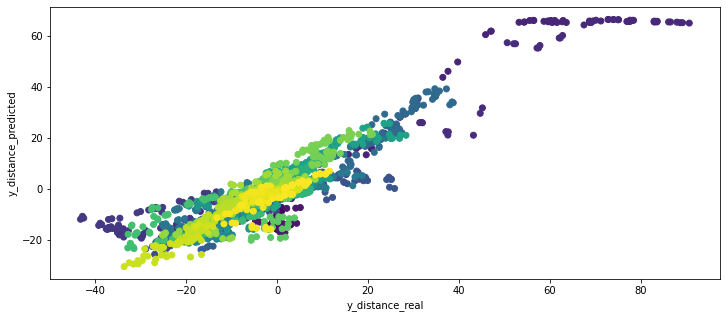

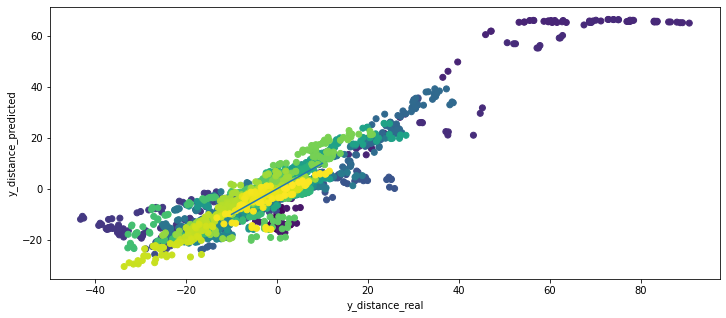

 --- plot predcition --- 


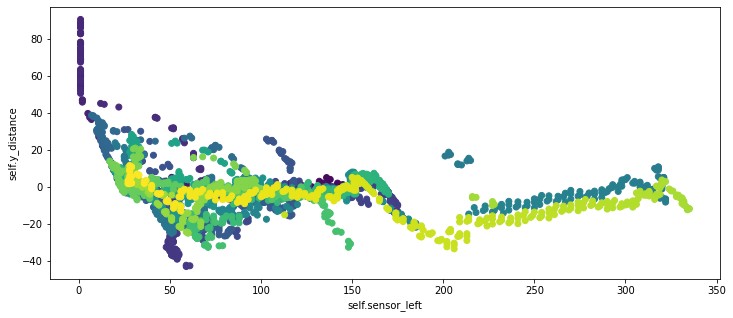

óóóóóó
2465
[51, 51, 51, 50, 50, 50, 51, 51, 51, 52, 52, 52, 51, 51, 51, 50, 51, 51, 52, 48, 48, 49, 51, 51, 50, 53, 53, 52, 51, 51, 52, 51, 51, 52, 51, 51, 50, 51, 51, 50, 51, 51, 52, 51, 51, 52, 51, 51, 50, 53, 146, 145, 145, 145, 145, 145, 145, 145, 144, 143, 142, 144, 144, 143, 142, 142, 142, 141, 141, 141, 138, 137, 136, 139, 138, 137, 138, 137, 137, 137, 137, 137, 134, 133, 132, 134, 133, 132, 133, 132, 132, 132, 131, 131, 130, 129, 128, 128, 128, 127, 126, 125, 125, 122, 122, 122, 120, 120, 119, 116, 115, 114, 115, 115, 115, 112, 111, 111, 108, 108, 107, 104, 103, 102, 99, 99, 99, 96, 95, 95, 92, 92, 91, 89, 88, 87, 86, 85, 85, 83, 83, 83, 80, 79, 78, 75, 75, 74, 71, 70, 70, 67, 67, 67, 64, 64, 63, 59, 59, 58, 55, 54, 54, 51, 51, 51, 53, 53, 52, 48, 48, 47, 44, 43, 43, 45, 44, 44, 43, 42, 41, 39, 39, 38, 36, 35, 35, 34, 34, 34, 34, 33, 32, 31, 31, 30, 30, 29, 29, 29, 28, 28, 29, 29, 28, 27, 26, 25, 25, 25, 25, 27, 26, 26, 24, 23, 22, 24, 24, 23, 25, 24, 24, 26, 25, 25, 22, 22, 2

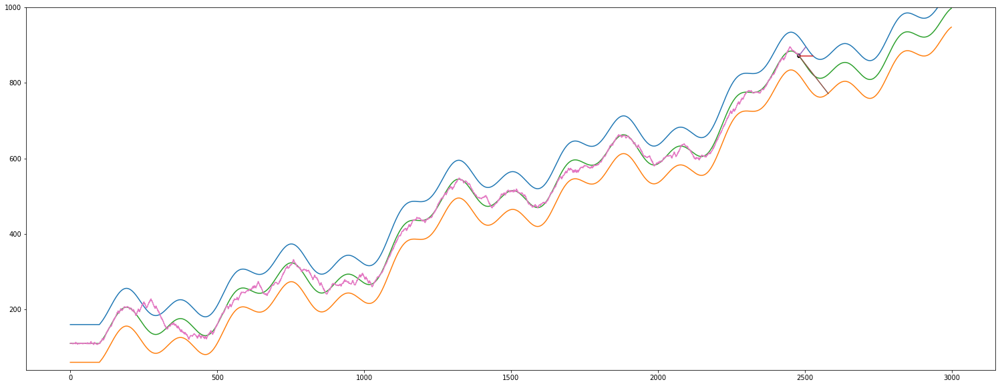

A streamkimeneten csak az utolsó 5000 sor látható.
			    ez az _X úgy, hogy a régi x_minmaxscaler alapján lett -1, 1 közé szorítva
			 _X_scaled =  [[-0.83249123  0.2453118  -0.21542324]]
			    ez a predicted y úgy, hogy a régi y_minmaxscaler alapján lett -1, 1 közé szorítva
			 predicted_position_scaled =  [-0.05350003]
		 --------------------------------------------------------------------------------------------------------------------------------------
		 ---------------------
		  action =  0
		  predicted_position =  [[20.16128137]]
		  distance from 0 (tmp)=  [[20.16128137]]
		 ---------------------
		 adott j-re 0 kiszámoltuk az előrejelzést de még nem hoztunk döntést -------------------------------------------------
		 --------------------------------------------------------------------------------------------------------------------------------------


		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  1
		 ----------------

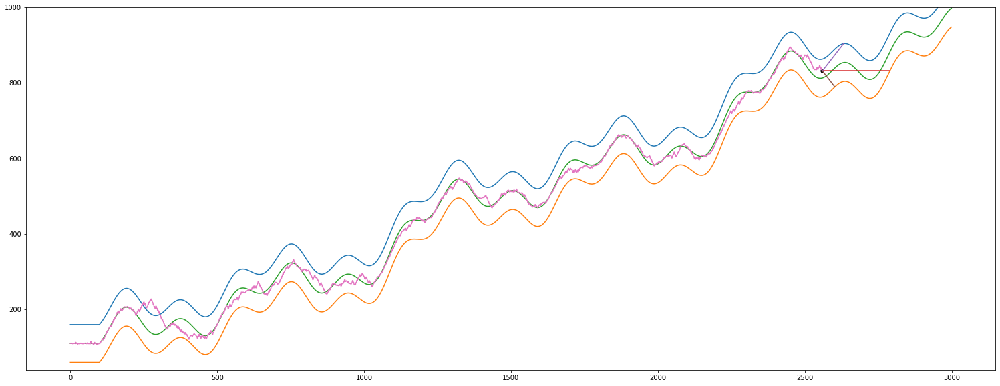

 --- plot --- 
------------------------------ IF i % 3 == 1 ------------------------------
# i =  2560
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 73 231  43]]
actual predicted =  [-0.14503637]
actual self.y_distance[-1] =  18.75049256363434
len(self.y_distance_real)      =  847
len(self.y_distance_predicted) =  847


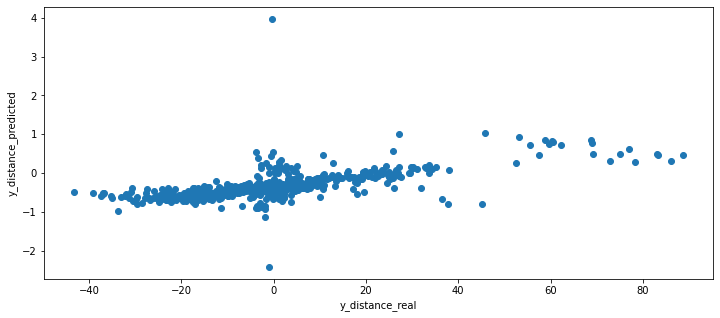

(2561, 1)
(2561, 1)


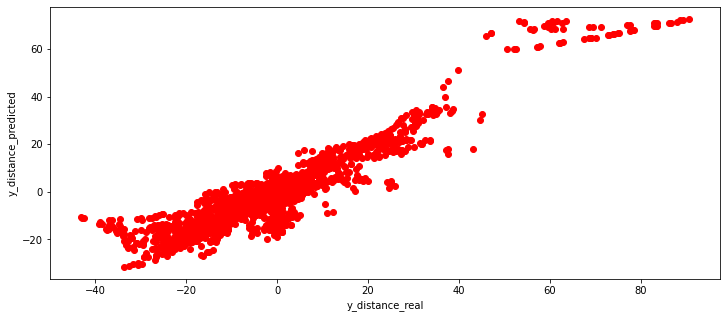

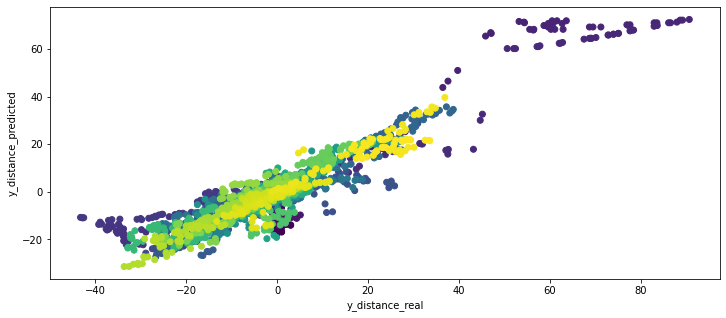

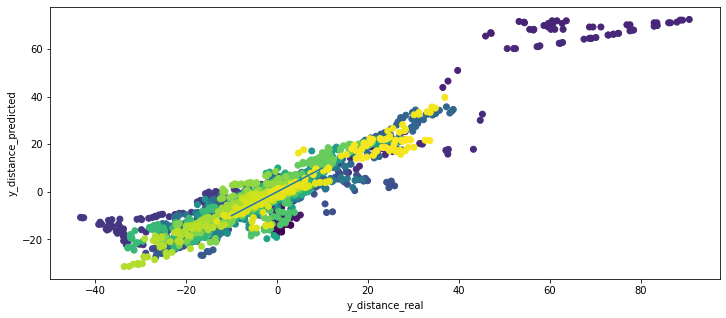

 --- plot predcition --- 


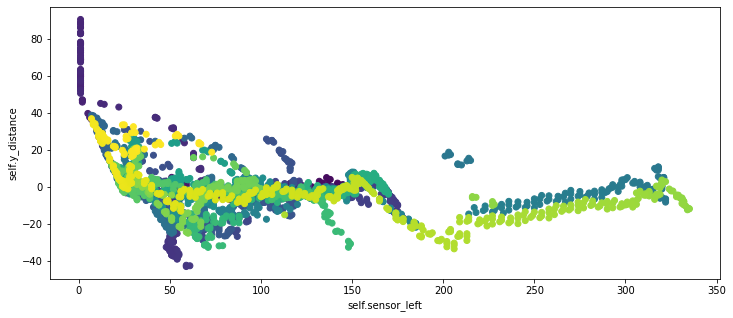

A streamkimeneten csak az utolsó 5000 sor látható.
		 regression_right.intercept_  =  0.0
		 # Ez lesz a bemenete a neurális hálónak
		 -------------------------X-------------------------
		  [[ 50.11646496 174.82643163  36.30641351]]
		 ---------------Brutálisan hülye dolgot jelez előre ezért ellenőrizni kell, hogy mi a gond. Esetleg a bemeneti adatok?-----------------
		 predicted_position linreg model            =  [[-0.90902644]]
		 predicted_position neural net model scaled =  [-0.511996]
		 predicted_position neural net model inverz =  [[-10.54827864]]
			 xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx
			    ez az _X úgy, hogy a régi x_minmaxscaler alapján lett -1, 1 közé szorítva
			 _X_scaled =  [[-0.70588943 -0.12868957 -0.56155977]]
			    ez a predicted y úgy, hogy a régi y_minmaxscaler alapján lett -1, 1 közé szorítva
			 predicted_position_scaled =  [-0.511996]
		 --------------------------------------------------------------------------------------------------------

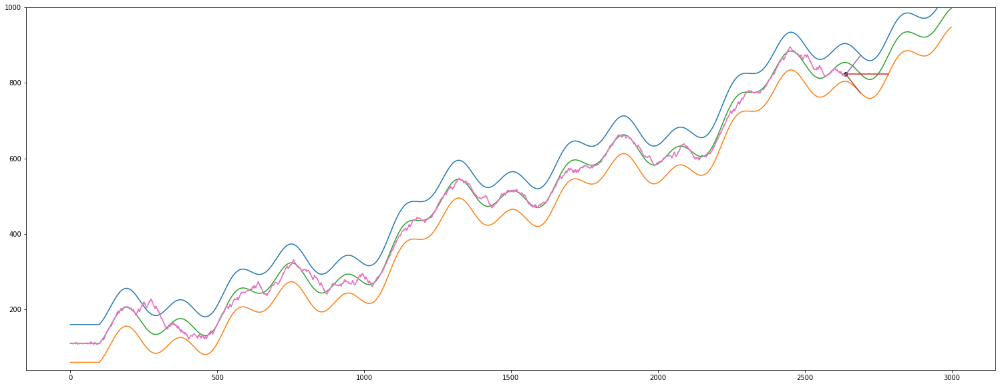

 --- plot --- 
------------------------------ IF i % 3 == 0 ------------------------------
# i =  2640
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (2641, 3)
y.shape =  (2641, 1)
i       =  2640
---------------------
X.max =  400
X.min =  1
y.max =  90.72356321549958
y.min =  -43.23425365063727
---------------------
X_scaled.max =  1.0
X_scaled.min =  -1.0
y_scaled.max =  1.0
y_scaled.min =  -1.0
---------------------
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  2640
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
# Linear Regression Learning --------------------------------------------------------------------------------------
		 # Linear Regression Training Results -------------------------------------------------------------------------
		 ------------------------------- val

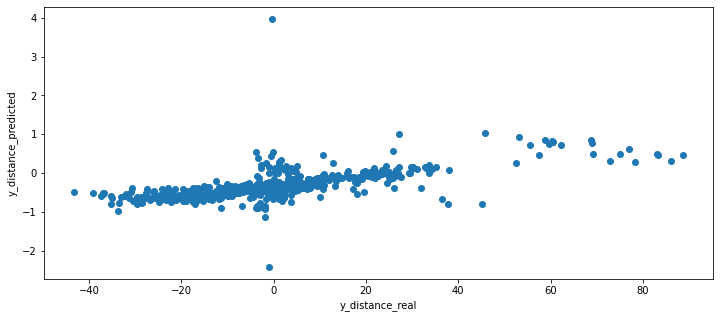

(2657, 1)
(2657, 1)


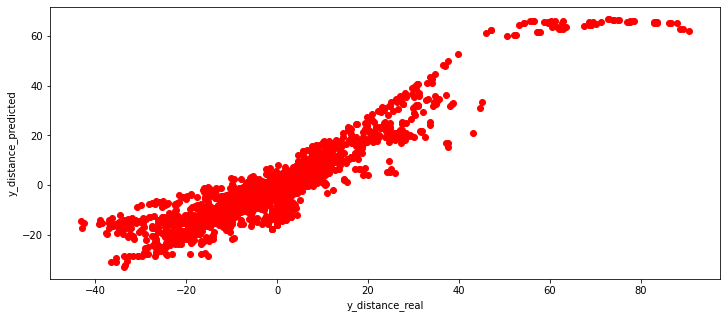

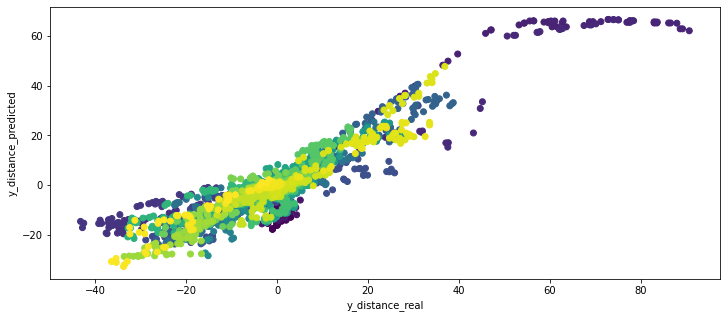

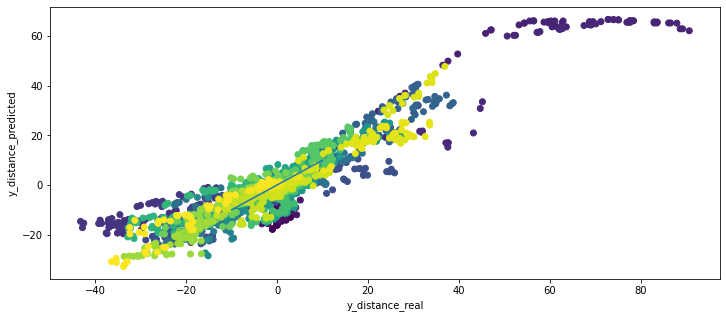

 --- plot predcition --- 


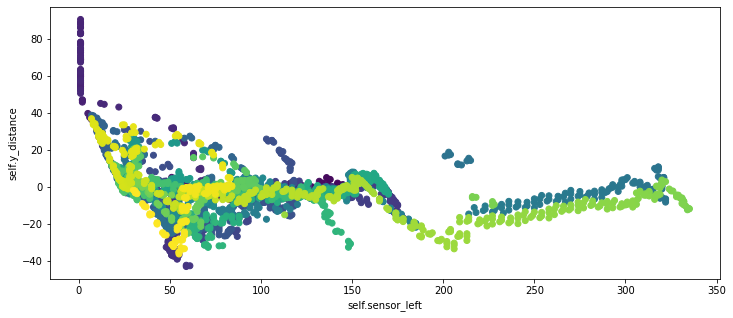

A streamkimeneten csak az utolsó 5000 sor látható.
		 predicted_position linreg model            =  [[-2.99911995]]
		 predicted_position neural net model scaled =  [-0.37565472]
		 predicted_position neural net model inverz =  [[-1.41628832]]
			 xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx
			    ez az _X úgy, hogy a régi x_minmaxscaler alapján lett -1, 1 közé szorítva
			 _X_scaled =  [[-0.0251042  -0.57787001 -0.28879531]]
			    ez a predicted y úgy, hogy a régi y_minmaxscaler alapján lett -1, 1 közé szorítva
			 predicted_position_scaled =  [-0.37565472]
		 --------------------------------------------------------------------------------------------------------------------------------------
		 ---------------------
		  action =  3
		  predicted_position =  [[-1.41628832]]
		  distance from 0 (tmp)=  [[1.41628832]]
		 ---------------------
		 adott j-re 3 kiszámoltuk az előrejelzést de még nem hoztunk döntést -------------------------------------------------
		 -------------

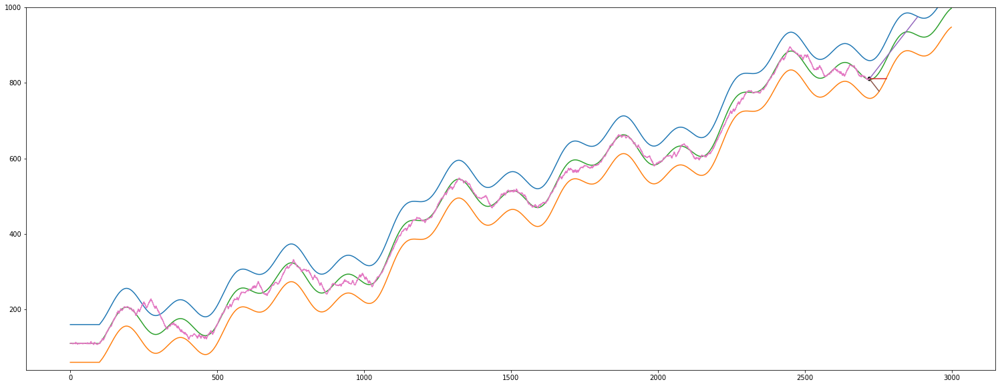

A streamkimeneten csak az utolsó 5000 sor látható.
		 -------------------------X-------------------------
		  [[154.85280276  51.81209873  35.36790883]]
		 ---------------Brutálisan hülye dolgot jelez előre ezért ellenőrizni kell, hogy mi a gond. Esetleg a bemeneti adatok?-----------------
		 predicted_position linreg model            =  [[-3.91778656]]
		 predicted_position neural net model scaled =  [-0.2552314]
		 predicted_position neural net model inverz =  [[6.64953407]]
			 xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx
			    ez az _X úgy, hogy a régi x_minmaxscaler alapján lett -1, 1 közé szorítva
			 _X_scaled =  [[-0.07872573 -0.74530276 -0.57720152]]
			    ez a predicted y úgy, hogy a régi y_minmaxscaler alapján lett -1, 1 közé szorítva
			 predicted_position_scaled =  [-0.2552314]
		 --------------------------------------------------------------------------------------------------------------------------------------
		 adott j-re 5 kiszámoltuk az előrejelzést de még 

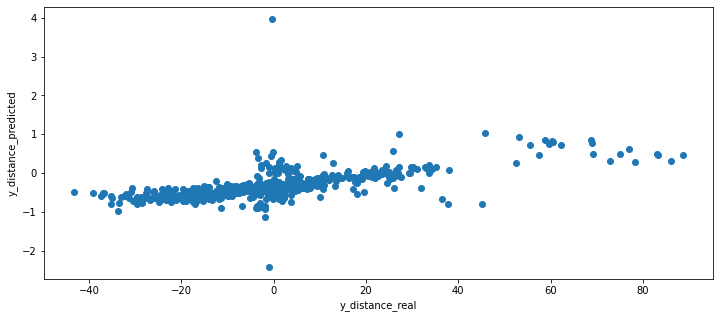

(2753, 1)
(2753, 1)


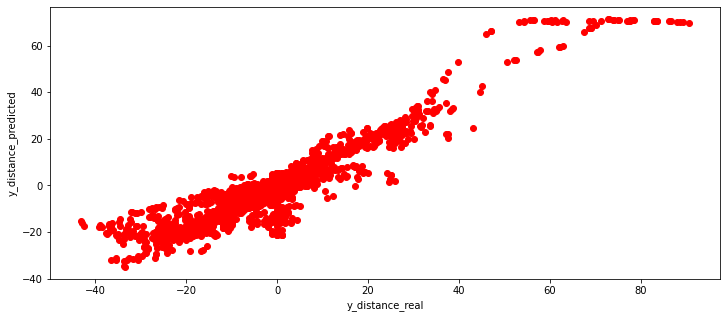

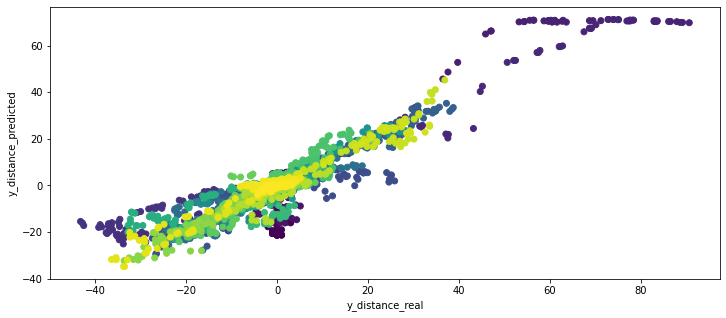

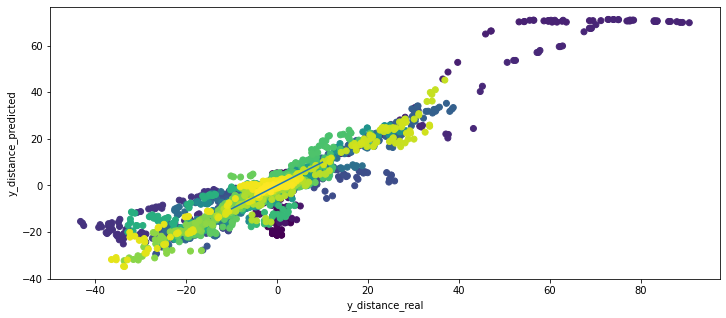

 --- plot predcition --- 


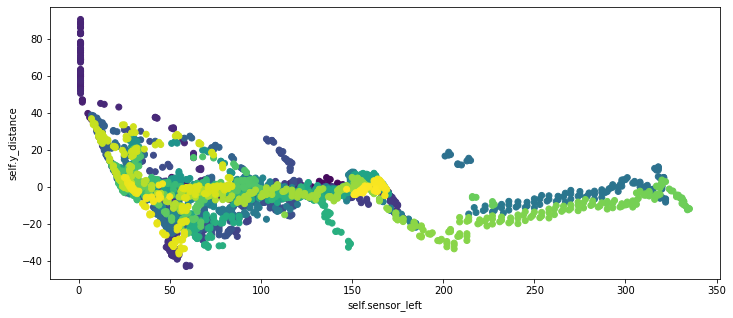

A streamkimeneten csak az utolsó 5000 sor látható.
			 len(self.sensor_left)   =  2777
			 len(self.sensor_center) =  2777
			 len(self.sensor_right)  =  2777
			 self.x                  =  2777
			 -------------- Teszt End --------------
			 ---------------- Append ----------------
			 len(self.y_distance)    =  2778
			 len(self.sensor_left)   =  2778
			 len(self.sensor_center) =  2778
			 len(self.sensor_right)  =  2778
			 self.x                  =  2777
			 -------------- Append End --------------
------------------------------ IF i % 3 == 2 ------------------------------
# i =  2777
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> down first
Sensor center =  28
Sensor from left wall =  120
Sensor from right wall =  17
most távolsagra van a felső faltól =  58.51820360749616
most távolsagra van az alsó faltól =  41.48179639250384
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                      

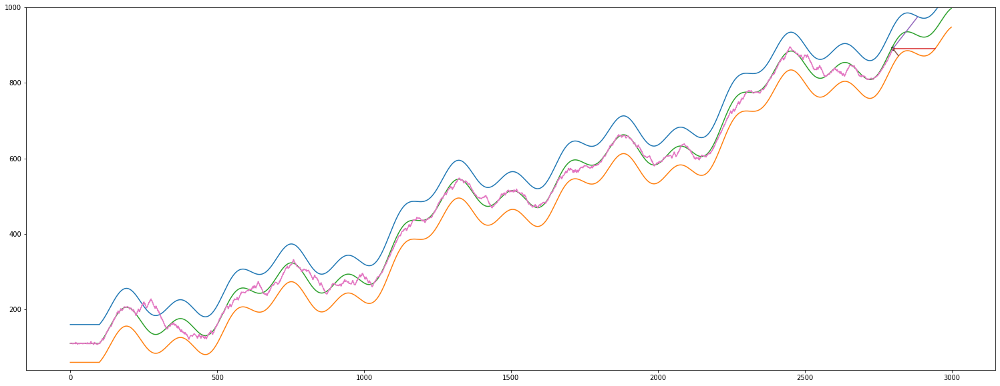

A streamkimeneten csak az utolsó 5000 sor látható.
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  2823
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  -14.849839388036571
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  -14.849839388036571
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  2824
			 len(self.sensor_left)   =  2824
			 len(self.sensor_center) =  2824
			 len(self.sensor_right)  =  2824
			 self.x                  =  2823
			 -------------- Teszt End --------------
self.y új értéke   =  910.0
action             =  -1
----------------- módosítás vége -----------------
# A run ciklus vége -----------------------------------------------------------------------------------------------------------------------

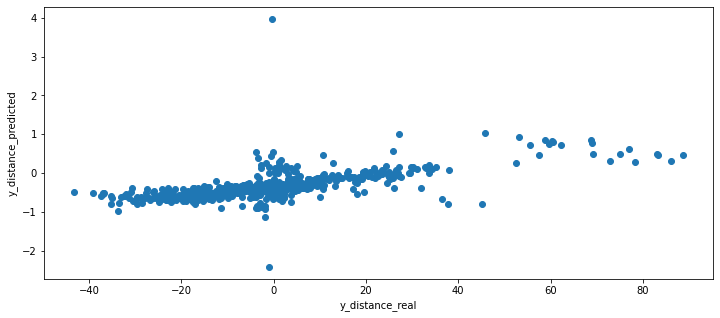

(2849, 1)
(2849, 1)


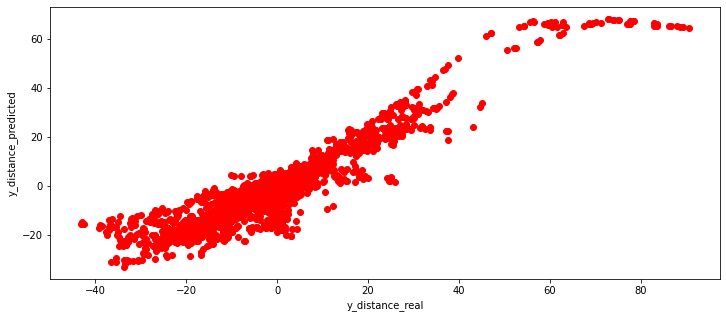

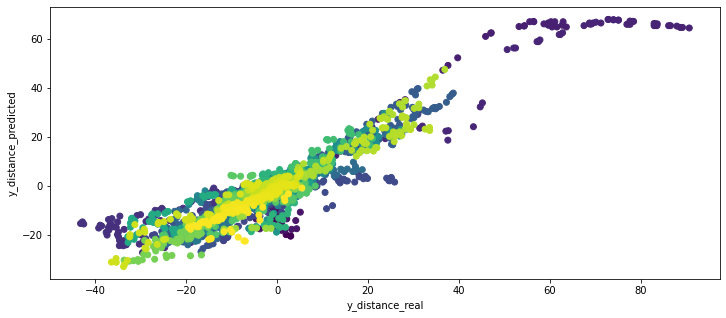

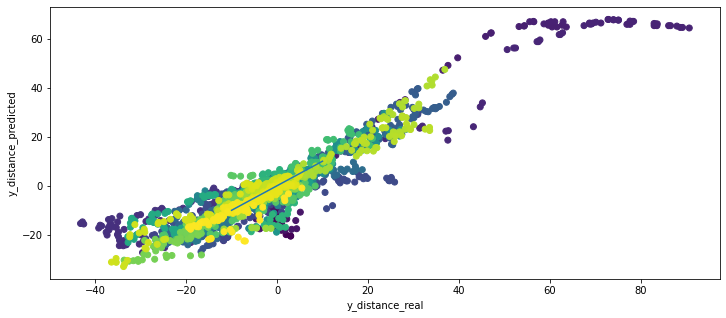

 --- plot predcition --- 


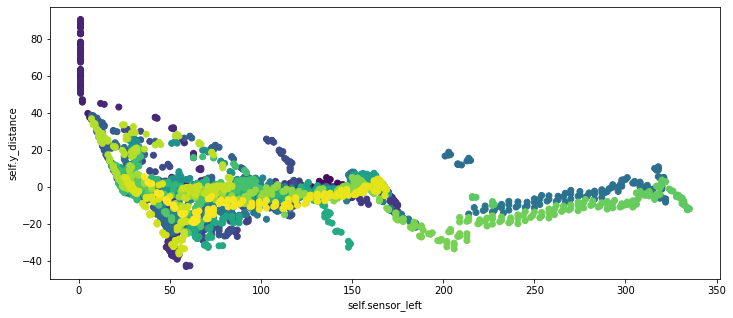

A streamkimeneten csak az utolsó 5000 sor látható.
		 predicted_position linreg model            =  [[5.0661991]]
		 predicted_position neural net model scaled =  [-0.23871625]
		 predicted_position neural net model inverz =  [[7.75570109]]
			 xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx
			    ez az _X úgy, hogy a régi x_minmaxscaler alapján lett -1, 1 közé szorítva
			 _X_scaled =  [[-0.84934996 -0.3100265   0.07303212]]
			    ez a predicted y úgy, hogy a régi y_minmaxscaler alapján lett -1, 1 közé szorítva
			 predicted_position_scaled =  [-0.23871625]
		 --------------------------------------------------------------------------------------------------------------------------------------
		 adott j-re 5 kiszámoltuk az előrejelzést de még nem hoztunk döntést -------------------------------------------------
		 --------------------------------------------------------------------------------------------------------------------------------------
	 minden j-re kiszámoltuk az elő

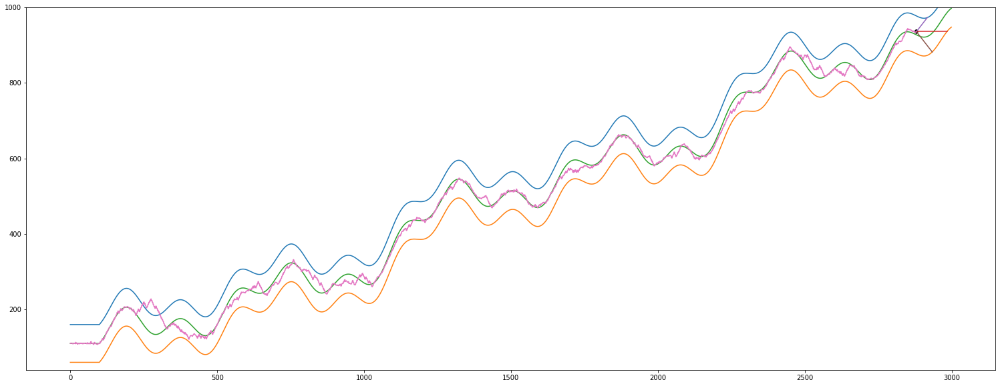

 --- plot --- 
------------------------------ IF i % 3 == 0 ------------------------------
# i =  2880
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (2881, 3)
y.shape =  (2881, 1)
i       =  2880
---------------------
X.max =  400
X.min =  1
y.max =  90.72356321549958
y.min =  -43.23425365063727
---------------------
X_scaled.max =  1.0
X_scaled.min =  -1.0
y_scaled.max =  1.0
y_scaled.min =  -1.0
---------------------
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  2880
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
# Linear Regression Learning --------------------------------------------------------------------------------------
		 # Linear Regression Training Results -------------------------------------------------------------------------
		 ------------------------------- val

IndexError: ignored

In [7]:
auto.run()

<a name="irodalom"></a>

# Felhasznált irodalom és internetes cimek

Itt gyűjtöttem össze a menet közben összegyűjt okosságokat

[vissza a tartalomhoz](#tartalom)<br>

Scikit-learn - MLPRegressor API
<br>
https://scikit-learn.org/stable/modules/generated/sklearn.neural_network.MLPRegressor.html


Fogalmak és probléma meghatározás
<br>
https://www.rubrik.com/blog/architecture/20/12/customized-autoscaling--minimize-your-cloud-cost


https://github.com/kubernetes/autoscaler/blob/master/cluster-autoscaler/FAQ.md#what-are-the-parameters-to-ca

https://arxiv.org/pdf/1608.04030.pdf

Metrikák amivel a szollgáltatás minőségét mérik különböző esetekben
<br>
https://blog.avinetworks.com/autoscaling-metrics

------------

NumPy API Reference Guide
<br>
https://numpy.org/doc/stable/reference/random/generated/numpy.random.normal.html


Seaborn API Reference Guide
<br>
https://seaborn.pydata.org/examples/pair_grid_with_kde.html

